# This notebook goes through all steps of registration and analysis of a sample dataset (cutured cell). It has been executed on a workstation with 4 cores (16 threadds available) and 1Tb of RAM. It would work with 512Gb of RAM as well, maybe even less.

# Import needed packages and functions

In [1]:
import numpy as np
import pandas as pd
import os
import socket
import platform
from pathlib import Path
import time
import glob
import re
import gc
import shutil

import matplotlib
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

from dask.distributed import Client
from dask.distributed import as_completed
from IPython.display import IFrame
from ClusterWrap.clusters import janelia_lsf_cluster

from tqdm.notebook import tqdm

from skimage.transform import ProjectiveTransform, AffineTransform, EuclideanTransform, warp
from sklearn.linear_model import (LinearRegression,
                                  TheilSenRegressor,
                                  RANSACRegressor,
                                  HuberRegressor,
                                  RidgeCV,
                                  LassoCV)
from scipy.signal import convolve2d
from scipy.ndimage import gaussian_filter

import mrcfile
try:
    import skimage.external.tifffile as tiff
except:
    import tifffile as tiff

from FIBSEM_gs_py.FIBSEM_gs import FIBSEM_frame, FIBSEM_dataset

from FIBSEM_gs_py.FIBSEM_gs import (get_min_max_thresholds,
                          get_spread,
                          check_DASK,
                          calculate_gradent_map,
                          radial_profile_select_angles,
                          add_scale_bar,
                          Single_Image_Noise_Statistics,
                          Single_Image_SNR,
                          clip_pad_image,
                          build_kernel_FFT_zero_destreaker_XY,
                          build_kernel_FFT_zero_destreaker_radii_angles,
                          build_kernel_FFT_destreaker_autodetect,
                        select_blobs_LoG_analyze_transitions,
                          merge_images_with_transition,
                          destreak_mrc_stack_with_kernel,
                          destreak_single_frame_kernel_shared,
                          smooth_mrc_stack_with_kernel,
                          analyze_mrc_stack_registration,
                          analyze_registration_frames,
                          bin_crop_mrc_stack,
                          mrc_stack_estimate_resolution_blobs_2D,
                          mrc_stack_plot_2D_blob_examples,
                          merge_tiff_files_mrc_stack,
                          show_eval_box_mrc_stack,
                          ShiftTransform,
                          XScaleShiftTransform,
                          ScaleShiftTransform,
                          RegularizedAffineTransform,
                          read_kwargs_xlsx,
                          generate_report_mill_rate_xlsx,
                          generate_report_FOV_center_shift_xlsx,
                          generate_report_data_minmax_xlsx,
                          generate_report_ScanRate_EHT_xlsx,
                          generate_report_transf_matrix_from_xlsx,
                          generate_report_from_xls_registration_summary,
                          plot_registrtion_quality_xlsx,
                          plot_cross_sections_mrc_stack,
                          plot_2D_blob_results,
                          plot_2D_blob_examples)

from skimage import __version__ as skimage_version
print('skimage version: ', skimage_version)
from scipy import __version__ as scipy_version
print('scipy version:   ', scipy_version)
from sklearn import __version__ as sklearn_version
print('sklearn version: ', sklearn_version)
from cv2 import __version__ as cv2_version
print('Open CV version: ', cv2_version)
from FIBSEM_gs_py import __version__ as FIBSEM_gs_py_version
print('FIBSEM_gs_py version: ', FIBSEM_gs_py_version)

C:\Users\labadmin\anaconda3\lib\site-packages\pandas\core\computation\expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.8.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
C:\Users\labadmin\anaconda3\lib\site-packages\pandas\core\arrays\masked.py:61: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


skimage version:  0.24.0
scipy version:    1.13.1
sklearn version:  1.6.1
Open CV version:  4.10.0
FIBSEM_gs_py version:  4.1.1


# Option 1: Set up Local DASK Client and Monitor Window

In [2]:
#start / restart client
try:
    client.restart()
except:
    client = Client()
    
# setup a window to monitor the client progress
use_DASK, status_update_address = check_DASK(client)
IFrame(src=status_update_address, width='100%', height='900px')

C:\Users\labadmin\anaconda3\lib\site-packages\distributed\node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 57475 instead
  warnings.warn(


DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress


# Option 2: Setup LSF cluster as DASK Client

In [ ]:
ncpus = 1
processes = 1
threads = 1
min_workers = 1
max_workers = 1000
client =  janelia_lsf_cluster(
    ncpus=ncpus,              # ncpus per bsub job
    processes=processes,      # number of workers contained in each bsub job
    threads=threads,          # number of concurrent tasks a worker can process at once
    min_workers=min_workers,  # minimum number of bsub jobs to maintain
    max_workers=max_workers,
    config={'distributed.worker.memory.recent-to-old-time':'600s',
           'distributed.scheduler.worker-ttl': None}).client

use_DASK, status_update_address = check_DASK(client)
IFrame(src=status_update_address, width='100%', height='900px')

# Step 0a: Select the Source Directory and Source Files.

In [3]:
fls_dir0 = os.path.normpath('Y:/Images Jeiss8/Cryo/Y2023')
fls_dir1 = os.path.normpath('Y:/Images Jeiss8/Cryo/Y2023/M10')
days1 = ['M10/D{:02d}'.format(day) for day in np.arange(21, 32)]
fls_dir2 = os.path.normpath('Y:/Images Jeiss8/Cryo/Y2023/M11')
days2 = ['M11/D{:02d}'.format(day) for day in np.arange(1, 23)]

days = days1+days2
days

['M10/D21',
 'M10/D22',
 'M10/D23',
 'M10/D24',
 'M10/D25',
 'M10/D26',
 'M10/D27',
 'M10/D28',
 'M10/D29',
 'M10/D30',
 'M10/D31',
 'M11/D01',
 'M11/D02',
 'M11/D03',
 'M11/D04',
 'M11/D05',
 'M11/D06',
 'M11/D07',
 'M11/D08',
 'M11/D09',
 'M11/D10',
 'M11/D11',
 'M11/D12',
 'M11/D13',
 'M11/D14',
 'M11/D15',
 'M11/D16',
 'M11/D17',
 'M11/D18',
 'M11/D19',
 'M11/D20',
 'M11/D21',
 'M11/D22']

In [4]:
fls=[]
ftype=0
for day in days:
    fls_dir_t = os.path.join(fls_dir0, day)
    if ftype == 0:
        fls1 = sorted(glob.glob(os.path.join(fls_dir_t,'*.dat')))
        if len(fls1) < 1:
            fls1 = sorted(glob.glob(os.path.join(fls_dir_t,'*/*.dat')))
    if ftype == 1:
        fls1 = sorted(glob.glob(os.path.join(fls_dir_t,'*.tif')))
        if len(fls1) < 1:
            fls1 = sorted(glob.glob(os.path.join(fls_dir_t,'*/*.tif')))
    fls = fls + fls1

nfrs = len(fls)
print('Total Number of frames to process: ', nfrs) 

Total Number of frames to process:  5058


# Notes from Jeiss8 machine
		
10/20/2023 resume PDC-WTDN_ROI1
	3:00 pm re-aligned FIB gun head, and re-aligned all FIB apertures.
	3:40 pm resume 3D-images, tried to re-engage position, since bad milling yesterday, it was hard to locate the right position.  Manually optimized SEM image.  Need check the position and re-optimize SEM images after several milling cycles.
	
10/21/2023 continued PDC-WTDN_ROI1
	5:52 am changed CL from 5.3nA/4.2s to 5.3nA/4.5s

10/22/2023 continued PDC-WTDN_ROI1
	12:33 pm changed CL from 5.3nA/4.5s to 5.3nA/5.0s
	
10/23/2023 continued PDC-WTDN_ROI1

10/24/2023 continued PDC-WTDN_ROI1
	7:27 pm changed CL from 5.3nA/5.0s to 5.3nA/4.7s
	
10/25/2023 continued PDC-WTDN_ROI1
	11:40 pm changed CL from 5.3nA/4.7s to 5.3nA/5.0s
	23
10/26/2023 continued PDC-WTDN_ROI1

10/27/2023 continued PDC-WTDN_ROI1
	7:36 pm changed CL from 5.3nA/5.0s to 5.3nA/5.1s
	
10/28/2023 continued PDC-WTDN_ROI1

10/29/2023 continued PDC-WTDN_ROI1
	1:14 pm changed CL from 5.3nA/5.1s to 5.3nA/4.8s

10/30/2023 continued PDC-WTDN_ROI1
	7:50 pm changed CL from 5.3nA/4.8s to 5.3nA/5.0s
	
10/31/2023 continued PDC-WTDN_ROI1
	10:07 pm changed CL from 5.3nA/5.0s to 5.2nA/5.0s
	
11/01/2023 continued PDC-WTDN_ROI1

11/02/2023 continued PDC-WTDN_ROI1

11/03/2023 continued PDC-WTDN_ROI1

11/04/2023 continued PDC-WTDN_ROI1

11/05/2023 continued PDC-WTDN_ROI1
	4:43 pm changed CL from 5.2nA/5.0s to 5.1nA/5.0s
	
11/06/2023 continued PDC-WTDN_ROI1

11/07/2023 continued PDC-WTDN_ROI1
	6:29 am changed CL from 5.1nA/5.0s to 5.1nA/4.9s
	
11/08/2023 continued PDC-WTDN_ROI1
	6:26 am changed CL from 5.1nA/4.9s to 5.1nA/4.8s
	
11/09/2023 continued PDC-WTDN_ROI1
	6:19 am changed CL from 5.1nA/4.8s to 5.1nA/5.0s
	
11/10/2023 continued PDC-WTDN_ROI1
	6:39 am changed CL from 5.1nA/5.0s to 5.1nA/4.8s
	2:05 pm changed CL from 5.1nA/4.8s to 5.0nA/4.8s
	
11/11/2023 continued PDC-WTDN_ROI1

11/12/2023 continued PDC-WTDN_ROI1

11/13/2023 continued PDC-WTDN_ROI1

11/14/2023 continued PDC-WTDN_ROI1
	9:00 pm changed CL from 5.0nA/4.8s to 5.0nA/5.0s
	
11/15/2023 continued PDC-WTDN_ROI1

11/16/2023 continued PDC-WTDN_ROI1
	6:42 pm changed CL from 5.0nA/4.8s to 5.0nA/5.0s
	
11/17/2023 continued PDC-WTDN_ROI1
	9:00 am changed CL from 5.0nA/5.0s to 5.0nA/5.3s
	9:57 pm changed CL from 5.0nA/5.3s to 5.0nA/5.5s
	
11/18/2023 continued PDC-WTDN_ROI1
	8:20 am changed CL from 5.0nA/5.5s to 5.0nA/5.7s
	6:08 pm changed CL from 5.0nA/5.7s to 5.0nA/5.5s
	
11/19/2023 continued PDC-WTDN_ROI1
	6:56 am changed CL from 5.0nA/5.5s to 5.0nA/5.2s
	7:56 pm changed CL from 5.0nA/5.2s to 5.0nA/5.0s

11/20/2023 continued PDC-WTDN_ROI1

11/21/2023 continued PDC-WTDN_ROI1

11/22/2023 continued PDC-WTDN_ROI1
	6:56 am changed CL from 5.0nA/5.0s to 5.0nA/5.3s
	8:34 pm changed CL from 5.0nA/5.3s to 5.0nA/5.5s


# Step 0b: Set up Processing Parameters.

In [5]:
# set the results directory
data_dir = os.path.normpath('Y:/Images Jeiss8/Cryo/Y2023/PDC_WTDN_ROI3')

ftype = 0 # 0 for Shan's .dat files, 1 for tif files

use_DASK = True
DASK_client_retries = 3  # Number of allowed automatic retries if a task fails

threshold_min = 1e-3    # These are used to determine Min and Max data boundaries for I8 conversion
threshold_max = 1e-3                            
sliding_minmax = True   # If True, Global Min and Max for I8 conversion the entire data set is used. If False, Min and Max are allowed to vary slowly.
nbins = 256             # Number of histogram bins for determining Min and Max above

BFMatcher = False       # If True, the BF Matcher is used for keypont matching
                        # otherwise FLANN Matcher (faster, preferable) is used.

save_matches = True     # If True, matches will be saved into individual files

# Uncomment one from the below choices:
#TransformType = ShiftTransform                #  only x-shift and y-shift
#TransformType = XScaleShiftTransform          #  x-scale, x-shift, y-shift
#TransformType = ScaleShiftTransform           #  x-scale, y-scale, x-shift, y-shift
#TransformType = AffineTransform               #  full Affine (x-scale, y-scale, rotation, shear, x-shift, y-shift)
TransformType = RegularizedAffineTransform     #  full Affine (x-scale, y-scale, rotation, shear, x-shift, y-shift)
                                                # with regularization on deviation from ShiftTransform
if TransformType == RegularizedAffineTransform:
    l2_param = 1e-5                                  # regularization strength (shrinkage parameter)
    l2_matrix = np.eye(6)*l2_param                   # initially set equal shrinkage on all coefficients
    l2_matrix[2,2]=0                                 # turn OFF the regularization on shifts
    l2_matrix[5,5]=0                                 # turn OFF the regularization on shifts
    targ_vector = np.array([1, 0, 0, 0, 1, 0])       # target transformation is shift only: Sxx=Syy=1, Sxy=Syx=0
    suffix = 'l2_{:.0e}'.format(l2_matrix[0,0])
else:
    l2_matrix= None
    targ_vector = None
    suffix = 'bilin'                  # optonal characters that will be added to the end of the filename (before the extension)

SIFT_nfeatures = 0     # SIFT libary default is 0. The number of best features to retain.
                                # The features are ranked by their scores (measured in SIFT algorithm as the local contrast)
    
SIFT_nOctaveLayers = 3          # SIFT libary default  is 3. The number of layers in each octave.
                                # 3 is the value used in D. Lowe paper. The number of octaves is computed automatically from the image resolution.

SIFT_contrastThreshold = 0.025   # SIFT libary default  is 0.04. The contrast threshold used to filter out weak features in semi-uniform (low-contrast) regions.
                                # The larger the threshold, the less features are produced by the detector.
                                # The contrast threshold will be divided by nOctaveLayers when the filtering is applied.
                                # When nOctaveLayers is set to default and if you want to use the value used in
                                # D. Lowe paper (0.03), set this argument to 0.09.
                                
SIFT_edgeThreshold = 10         # SIFT libary default  is 10. The threshold used to filter out edge-like features.
                                # Note that the its meaning is different from the contrastThreshold,
                                # i.e. the larger the edgeThreshold, the less features are filtered out
                                # (more features are retained).

SIFT_sigma = 1.6                # SIFT library default is 1.6. 	The sigma of the Gaussian applied to the input image at the octave #0.
                                # If your image is captured with a weak camera with soft lenses, you might want to reduce the number.
    
Lowe_Ratio_Threshold = 0.7

solver = 'RANSAC'       # String indicating which solver is to be used.'RANSAC' will use RANSAC (Random Sample Consensus) algorithm.
                        # 'LinReg' will use Linear Regression with iterative "Throwing out the Worst Residual" Heuristic
RANSAC_initial_fraction = 0.005  # fraction of data points for initial RANSAC iteration step.

drmax = 1.5              # dimensions - pixels.
                         #  - in the case of 'RANSAC' - Maximum distance for a data point to be classified as an inlier.
                         #  - in the case of 'LinReg' - outlier threshold for iterative regression:
                         # For each matched pair of keypoins the error is calculated as err[j] = dst_pts[j] - A*src_pts[j]
                         # The iterative procedure throws away the matched keypoint pair with worst error on every iteration
                         # until the worst error falls below drmax or the max number of iterations is reached.

max_iter = 1000             # max number of iterations in the iterative procedure above

save_data_as_tiff = False    # Convert and Save the InLens.tif data

save_res_png = True          # Save PNG images of the intemediate processing statistics and final registration quality check.

dtp = np.int16                  # Python data type for saving. Deafult is int16, the other option currently is uint8.

preserve_scales = True       # If True, the transformation matrix will be adjusted using the settings defined by fit_params below
fit_params = ['SG', 101, 3]  # perform the above adjustment using  Savitzky-Golay (SG) filter with parameters
                             # window size 501, polynomial order 3
#fit_params = ['LF']         # another option is to use linear fit with forces start points Sxx and Syy = 1 and Sxy and Syx = 0
#fit_params = ['PF', 2]      # another option is to use polynomial fit (in this case of order 2)

subtract_linear_fit = [True, True]  # If True, the linear slopes along X- and Y- directions (respectively) will be subtracted from the cumulative shifts.
                                    # This is performed after the optimal frame-to-frame shifts are recalculated for preserve_scales = True 
subtract_FOVtrend_from_fit = [True, True]  # If True, FOV trends (image shifts performed during imaging) will be subtracted first, so they do not bias the linear trends.

pad_edges = True             # If True, the edges will be padded with the amount equal to max shift excursion in each direction

flipY = False                 # If True, the dataset will be flipped along Y-direction

zbin_factor =  1             # binning factor in z-direction (milling direction). Data will be binned when saving the final result. Default is 1.

eval_metrics = ['NSAD', 'NCC', 'NMI']   # list of metrics used for evaluation of registration (and resolution).
                                        # Options are; 'NSAD', 'NCC', 'NMI', 'FSC'
fnm_types = ['mrc']    #   File type(s) for output data. Options are: ['h5', 'mrc'].
                             # Defauls is ['mrc']. 
                             # 'h5' is BigDataViewer HDF5 format, uses npy2bdv package. Use empty list if do not want to save the data.

int_order = 1                #     The order of interpolation. The order has to be in the range 0-5:
                             #    - 0: Nearest-neighbor
                             #    - 1: Bi-linear (default)
                             #    - 2: Bi-quadratic
                             #    - 3: Bi-cubic
                             #    - 4: Bi-quartic
                             #    - 5: Bi-quintic
                        
                        

#********************************************************************************************************
# DO NOT MODIFY THE CODE BELOW!
#********************************************************************************************************           

if fit_params[1] > nfrs//2*2-1:  # if smoothing aperture (Sov-Gol) is larger than number of frames, reduce the aperture
    fit_params[1] = nfrs//2*2-1

fnm0 = (os.path.join(data_dir,fls[0]))
frame0 = FIBSEM_frame(fnm0, ftype=ftype)
Sample_ID = frame0.Sample_ID.strip('\x00')
EightBit = frame0.EightBit

SIFT_kwargs = {
    'ftype' : ftype,
    'data_dir' : data_dir,
    'Sample_ID' : Sample_ID,
    'EightBit' : EightBit,
    'use_DASK' : use_DASK,
    'DASK_client_retries' : DASK_client_retries,
    'threshold_min' : threshold_min, 
    'threshold_max' : threshold_max,
    'sliding_minmax' : sliding_minmax,
    'nbins' : nbins,
    'TransformType' : TransformType,
    'SIFT_nfeatures' : SIFT_nfeatures,
    'SIFT_nOctaveLayers' : SIFT_nOctaveLayers,
    'SIFT_contrastThreshold' : SIFT_contrastThreshold,
    'SIFT_edgeThreshold' : SIFT_edgeThreshold,
    'SIFT_sigma' : SIFT_sigma,
    'Lowe_Ratio_Threshold' : Lowe_Ratio_Threshold,
    'l2_matrix' : l2_matrix,
    'targ_vector': targ_vector, 
    'solver' : solver,
    'RANSAC_initial_fraction' : RANSAC_initial_fraction,
    'drmax' : drmax,
    'max_iter' : max_iter,
    'BFMatcher' : BFMatcher,
    'save_matches' : save_matches,
    'save_res_png' : save_res_png,
    'save_data_as_tiff' : save_data_as_tiff,
    'dtp' : dtp,
    'preserve_scales' : preserve_scales,
    'fit_params' : fit_params,
    'subtract_linear_fit' : subtract_linear_fit,
    'subtract_FOVtrend_from_fit' : subtract_FOVtrend_from_fit,
    'pad_edges' : pad_edges,
    'flipY' : flipY,
    'zbin_factor' : zbin_factor,
    'eval_metrics' : eval_metrics,
    'fnm_types' : fnm_types,
    'int_order' : int_order,
    'suffix' : suffix}

test_dataset = FIBSEM_dataset(fls, fnm_reg = 'Registered_brat0.00.mrc', **SIFT_kwargs)

2025/08/05  12:52:25   Registered data will be saved into:  Registered_brat0.00.mrc
Total Number of frames:  5058


# The next two cels are for SNR analysis - not needed for registration

Analyzing the Noise Statistics in RawImageA, All Pixels

The EM data range for display:            -3452.45 to -3096.82
The EM data range for noise analysis:     -3424.27 to -3150.27

Used Dark Count Offset: -4194.01
Slope of linear fit with header offset: 0.25
Fit w DarkCount  : SNR1 <S^2>/<N^2> = 3570.88

Free Fit Offset: -3926.41
Slope of Free Fit: 0.36
Free Fit         : SNR0 <S^2>/<N^2> = 1769.98
2025/08/05  12:55:02   results saved into the file: Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-11-03_013932_0-0-0_RawImageA_Noise_Analysis_AllPix.png

Analyzing the Noise Statistics in RawImageA, Gr.Thr=0.100

The EM data range for display:            -3452.45 to -3096.82
The EM data range for noise analysis:     -3426.13 to -3154.32

Used Dark Count Offset: -4194.01
Slope of linear fit with header offset: 0.25
Fit w DarkCount  : SNR1 <S^2>/<N^2> = 3656.15

Free Fit Offset: -4006.06
Slope of Free Fit: 0.31
Free Fit         : SNR0 <S^2>/<N^2> = 2285.48
2025/08/05  12:55:27   

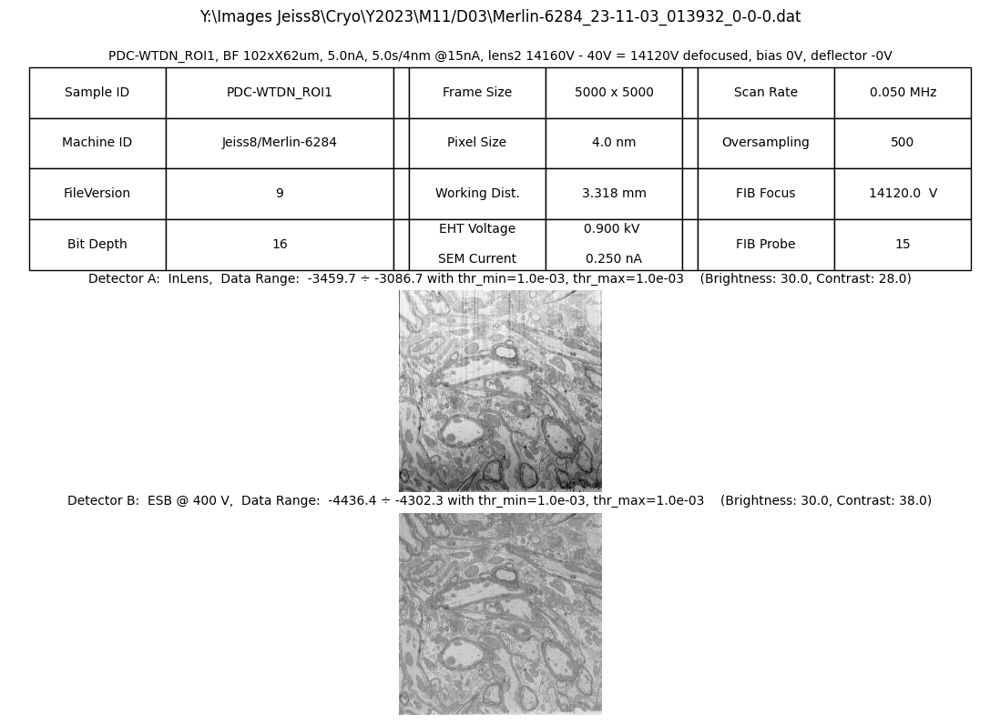

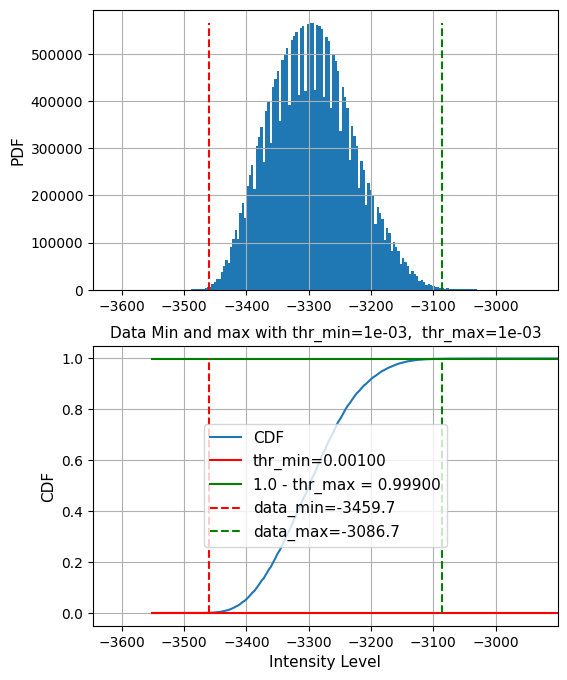

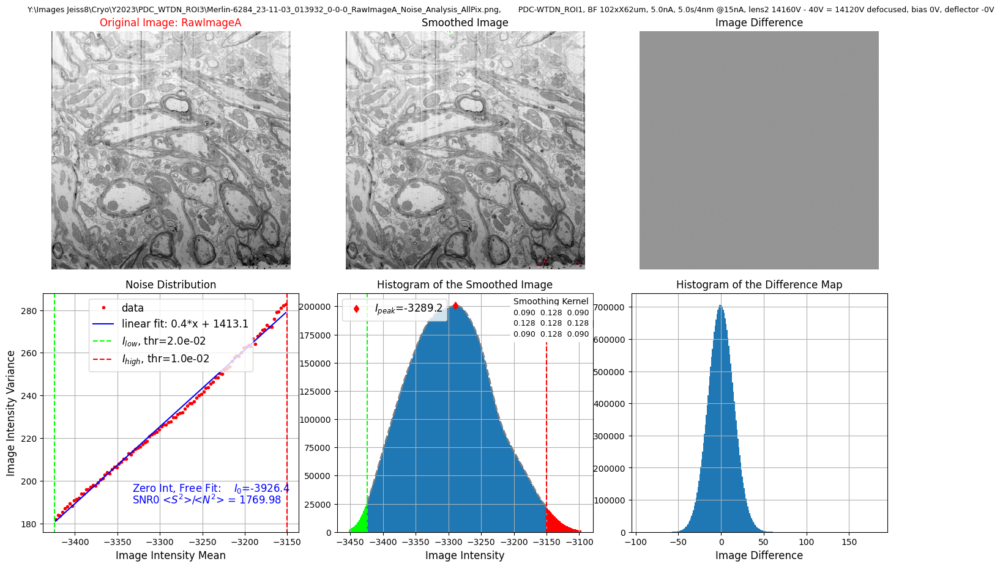

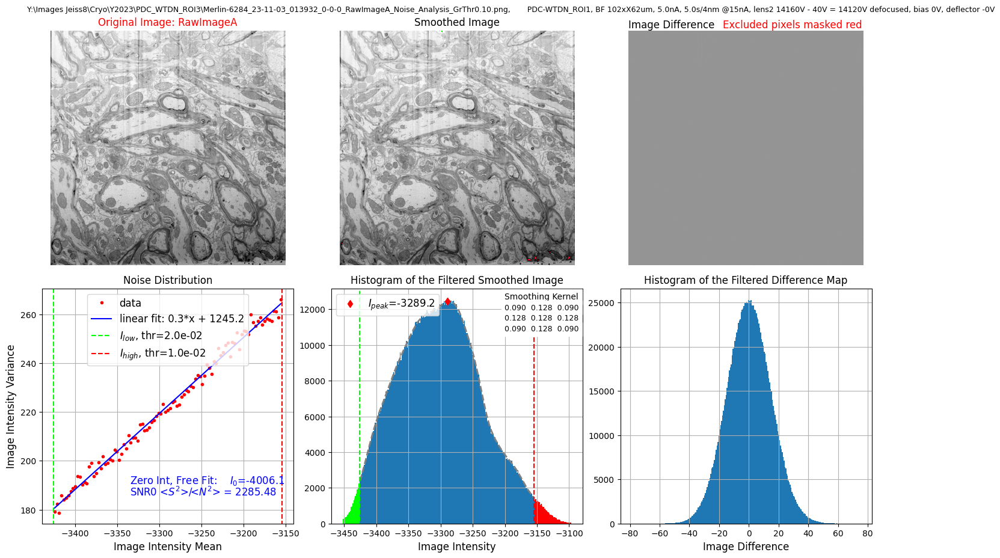

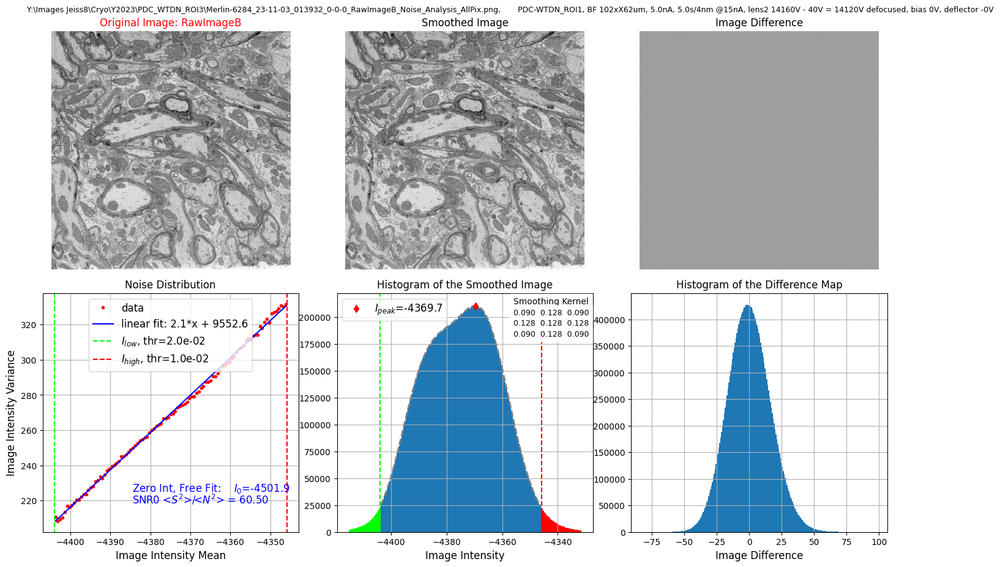

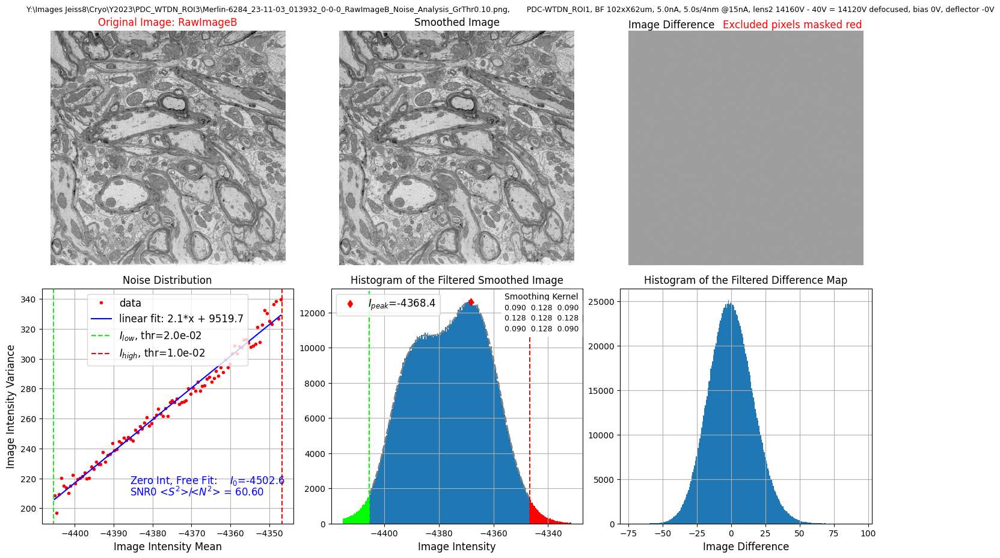

In [7]:
fr_inds = [2000]
grad_thr_min = 0.10
nbins=1000

for fr_ind in fr_inds:
    test_frame = FIBSEM_frame(fls[fr_ind])
    test_frame_suff = Path(test_frame.fname).suffix
    snapshot_name = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_snapshot.png'))
    test_frame.save_snapshot(snapshot_name=snapshot_name)
    get_min_max_thresholds(test_frame.RawImageA, disp_res=True)
    
    # define filter array for noise calculations. Select only pixels with low local intensity gradients.
    abs_grad = calculate_gradent_map((test_frame.RawImageA-test_frame.Scaling[1,0]), normalize=False, thresholds_disp=[1e-2, 1e-2], disp_res=False)
    gr_min, gr_max = get_min_max_thresholds(abs_grad, nbins=nbins, thr_min=grad_thr_min, disp_res=False)
    filter_array = abs_grad<gr_min
    
    image_name = 'RawImageA'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AllPix.png'))
    print('Analyzing the Noise Statistics in ' + image_name + ', All Pixels')

    RawImageA_results_allpix = test_frame.analyze_noise_statistics(image_name = image_name,
                                                            #filter_array = filter_array,
                                                            disp_res_SNR1 = False,
                                                            res_fname = res_fname,
                                                           dpi=600)
    
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_GrThr{:.2f}.png'.format(grad_thr_min)))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ', Gr.Thr={:.3f}'.format(grad_thr_min))
    
    RawImageA_results_grthr = test_frame.analyze_noise_statistics(image_name = image_name,
                                                            filter_array = filter_array,
                                                            disp_res_SNR1 = False,
                                                            res_fname = res_fname,
                                                           dpi=600)

    image_name = 'RawImageB'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AllPix.png'))
    print('')
    print('Analyzing the Noise Statistics in '+ image_name + ', All Pixels')
    
    RawImageB_results_allpix = test_frame.analyze_noise_statistics(image_name = image_name,
                                                            #filter_array = filter_array,
                                                            disp_res_SNR1 = False,
                                                            res_fname = res_fname,
                                                           dpi=600)
    
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_GrThr{:.2f}.png'.format(grad_thr_min)))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ', Gr.Thr={:.3f}'.format(grad_thr_min))
    
    RawImageB_results_grthr = test_frame.analyze_noise_statistics(image_name = image_name,
                                                            filter_array = filter_array,
                                                            disp_res_SNR1 = False,
                                                            res_fname = res_fname,
                                                           dpi=600)


Analyzing the Noise Statistics in RawImageA using AutoCorrelation, ZeroMean=False
2025/08/05  12:58:18   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-11-03_013932_0-0-0_RawImageA_Noise_Analysis_AutoCorr_ZeroMeanFalse.png

Analyzing the Noise Statistics in RawImageA using AutoCorrelation, ZeroMean=True
2025/08/05  12:58:40   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-11-03_013932_0-0-0_RawImageA_Noise_Analysis_AutoCorr_ZeroMeanTrue.png

Analyzing the Noise Statistics in RawImageB using AutoCorrelation, ZeroMean=False
2025/08/05  12:59:02   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-11-03_013932_0-0-0_RawImageB_Noise_Analysis_AutoCorr_ZeroMeanFalse.png

Analyzing the Noise Statistics in RawImageB using AutoCorrelation, ZeroMean=True
2025/08/05  12:59:23   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-11

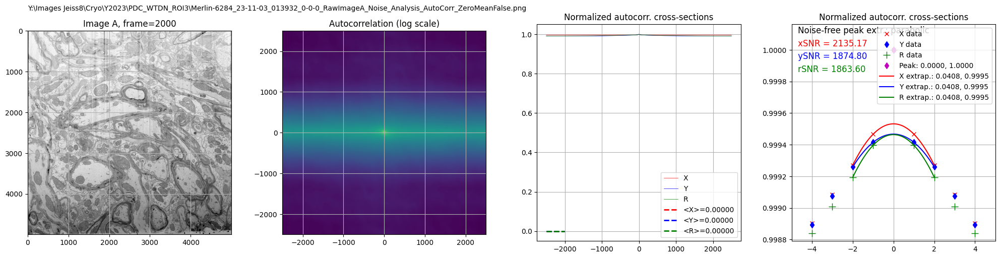

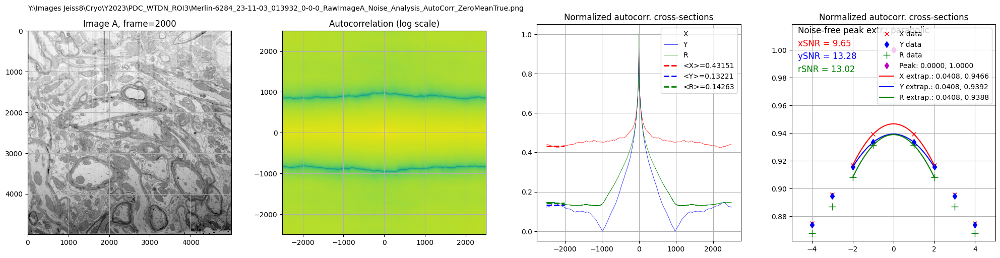

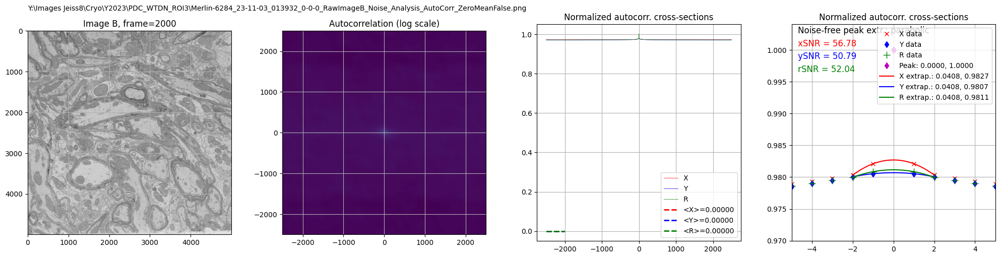

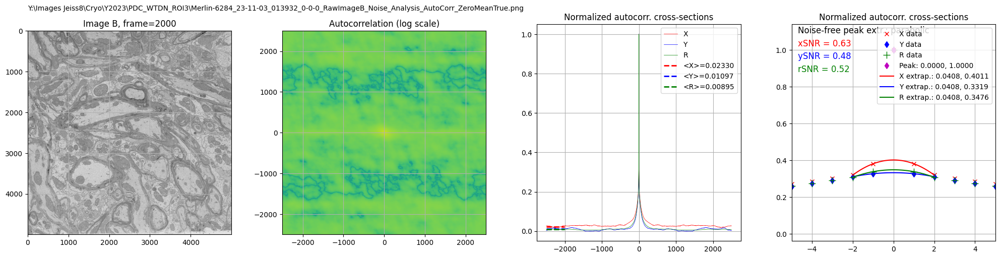

In [8]:
fr_inds = [2000]

extrapolate_signal = 'parabolic'
RawImageA_offset = RawImageA_results_grthr[2]
RawImageB_offset = RawImageB_results_grthr[2]

for fr_ind in fr_inds:
    test_frame = FIBSEM_frame(fls[fr_ind])
    test_frame_suff = Path(test_frame.fname).suffix
        
    image_name = 'RawImageA'
    zero_mean = False
    zero_mean_str = 'True' if zero_mean else 'False'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AutoCorr_ZeroMean'+zero_mean_str+'.png'))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ' using AutoCorrelation, ZeroMean=' + zero_mean_str)
    RawImageA_results_autocorr = Single_Image_SNR(test_frame.RawImageA-RawImageA_offset,
                                                  zero_mean = zero_mean,
                                                  extrapolate_signal = extrapolate_signal,
                                                  img_label = 'Image A, frame={:d}'.format(fr_ind),
                                                  save_res_png = True,
                                                  res_fname = res_fname,
                                                  dpi = 600)
    zero_mean = True
    zero_mean_str = 'True' if zero_mean else 'False'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AutoCorr_ZeroMean'+zero_mean_str+'.png'))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ' using AutoCorrelation, ZeroMean=' + zero_mean_str)
    RawImageA_results_autocorr = Single_Image_SNR(test_frame.RawImageA-RawImageA_offset,
                                                  zero_mean = zero_mean,
                                                  extrapolate_signal = extrapolate_signal,
                                                  img_label = 'Image A, frame={:d}'.format(fr_ind),
                                                  save_res_png = True,
                                                  res_fname = res_fname,
                                                  dpi = 600)
    
    image_name = 'RawImageB'
    zero_mean = False
    zero_mean_str = 'True' if zero_mean else 'False'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AutoCorr_ZeroMean'+zero_mean_str+'.png'))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ' using AutoCorrelation, ZeroMean=' + zero_mean_str)
    RawImageB_results_autocorr = Single_Image_SNR(test_frame.RawImageB-RawImageB_offset,
                                                  zero_mean = zero_mean,
                                                  extrapolate_signal = extrapolate_signal,
                                                  img_label = 'Image B, frame={:d}'.format(fr_ind),
                                                  save_res_png = True,
                                                  res_fname = res_fname,
                                                  dpi = 600)
    zero_mean = True
    zero_mean_str = 'True' if zero_mean else 'False'
    res_fname = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace(test_frame_suff, '_' + image_name + '_Noise_Analysis_AutoCorr_ZeroMean'+zero_mean_str+'.png'))
    print('')
    print('Analyzing the Noise Statistics in ' + image_name + ' using AutoCorrelation, ZeroMean=' + zero_mean_str)
    RawImageB_results_autocorr = Single_Image_SNR(test_frame.RawImageB-RawImageB_offset,
                                                  zero_mean = zero_mean,
                                                  extrapolate_signal = extrapolate_signal,
                                                  img_label = 'Image B, frame={:d}'.format(fr_ind),
                                                  save_res_png = True,
                                                  res_fname = res_fname,
                                                  dpi = 600)

# Check the settings: Perform SIFT alignements on two frames in the middle of the stack

2025/08/05  12:59:56   DASK client does not exist. Will perform local computations
Sample ID:    PDC-WTDN_ROI1
File:  Y:\Images Jeiss8\Cryo\Y2023\M11/D06\Merlin-6284_23-11-06_122022_0-0-0.dat , extracted 288589 keypoints
File:  Y:\Images Jeiss8\Cryo\Y2023\M11/D06\Merlin-6284_23-11-06_122945_0-0-0.dat , extracted 294467 keypoints


Repeating SIFT calculation 1 times:   0%|          | 0/1 [00:00<?, ?it/s]


# of detected matches: 15445

thr_min=1e-03, thr_max=1e-03
RegularizedAffineTransform, RANSAC,  FLANN
SIFT_nfeatures=0
SIFT_nOctaveLayers=3,  SIFT_edgeThreshold=10.000
SIFT_contrastThreshold=0.025,  SIFT_sigma=1.600
RANSAC_initial_fraction = 0.0050, max_iter=1000
drmax=1.500
# of keypoints = 288589, # of matches =15445
2025/08/05  13:01:03   Transformation Matrix determined using RegularizedAffineTransform using RANSAC solver
[[ 1.00002128e+00 -1.05568634e-04  2.53905533e-01]
 [ 1.93761857e-05  9.99730958e-01  8.24859262e-01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
15445 keypoint matches were detected with 1.5 pixel outlier threshold
Number of iterations: 6298
CPU times: total: 2min 3s
Wall time: 1min 6s


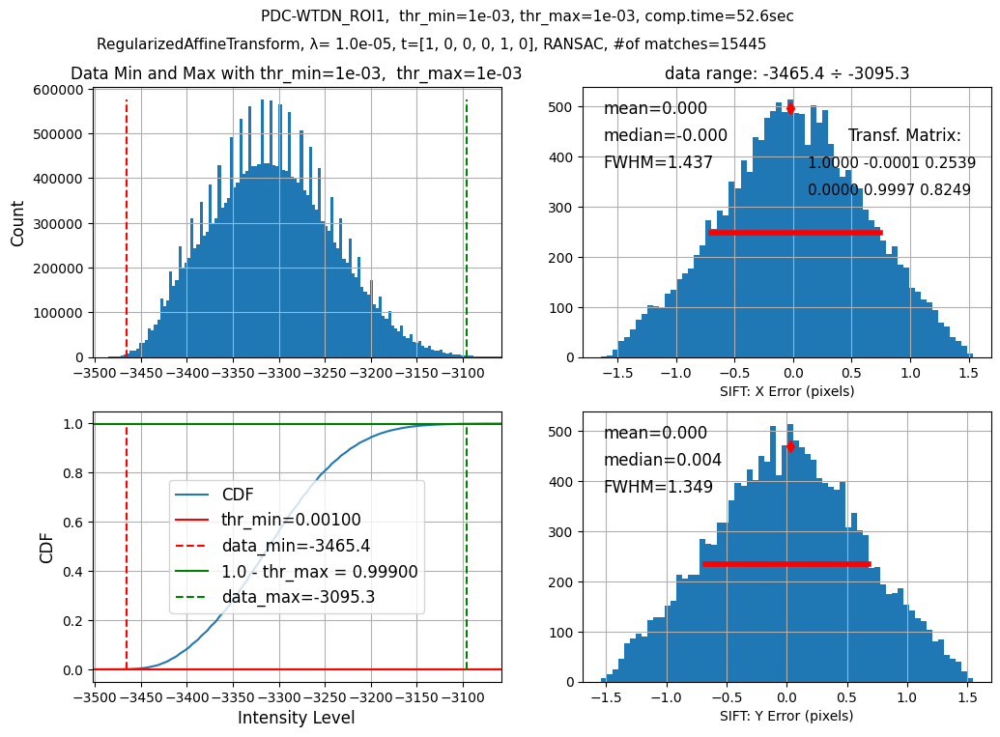

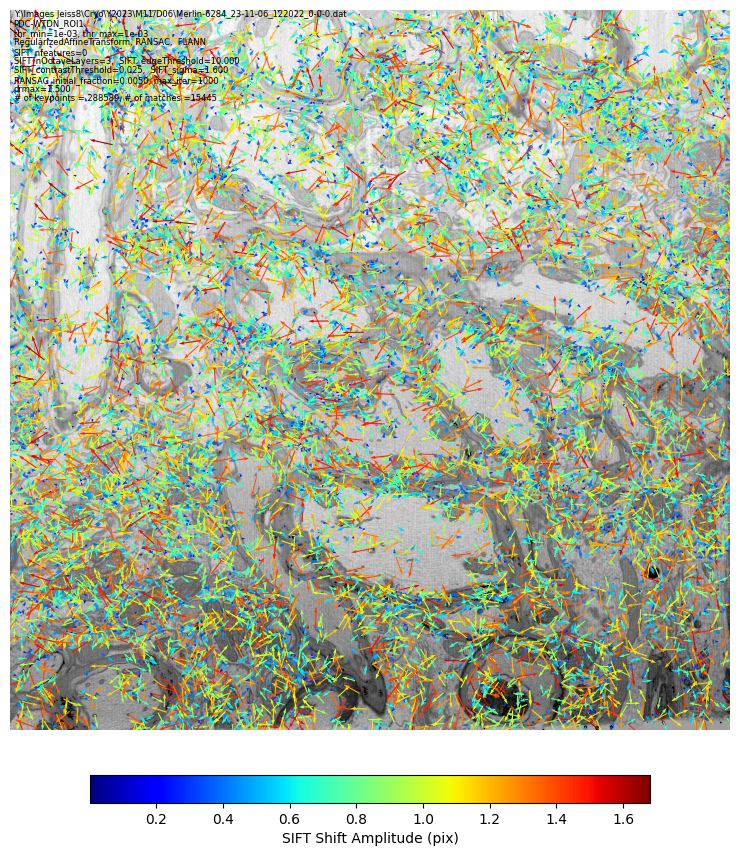

In [9]:
%%time
SIFT_evaluation_results = test_dataset.SIFT_evaluation()

2025/08/05  13:01:16   DASK client does not exist. Will perform local computations
Sample ID:    PDC-WTDN_ROI1
File:  Y:\Images Jeiss8\Cryo\Y2023\M11/D06\Merlin-6284_23-11-06_122022_0-0-0.dat , extracted 288589 keypoints
File:  Y:\Images Jeiss8\Cryo\Y2023\M11/D06\Merlin-6284_23-11-06_122945_0-0-0.dat , extracted 294467 keypoints


Repeating SIFT calculation 1 times:   0%|          | 0/1 [00:00<?, ?it/s]


# of detected matches: 15404

thr_min=1e-03, thr_max=1e-03
RegularizedAffineTransform, RANSAC,  FLANN
SIFT_nfeatures=0
SIFT_nOctaveLayers=3,  SIFT_edgeThreshold=10.000
SIFT_contrastThreshold=0.025,  SIFT_sigma=1.600
RANSAC_initial_fraction = 0.0050, max_iter=1000
drmax=1.500
# of keypoints = 288589, # of matches =15404
2025/08/05  13:02:19   Transformation Matrix determined using RegularizedAffineTransform using RANSAC solver
[[ 1.00003644e+00 -1.19798746e-04  2.59979966e-01]
 [ 1.55805230e-05  9.99736412e-01  8.46301095e-01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]
15404 keypoint matches were detected with 1.5 pixel outlier threshold
Number of iterations: 6244
CPU times: total: 2min 1s
Wall time: 1min 2s


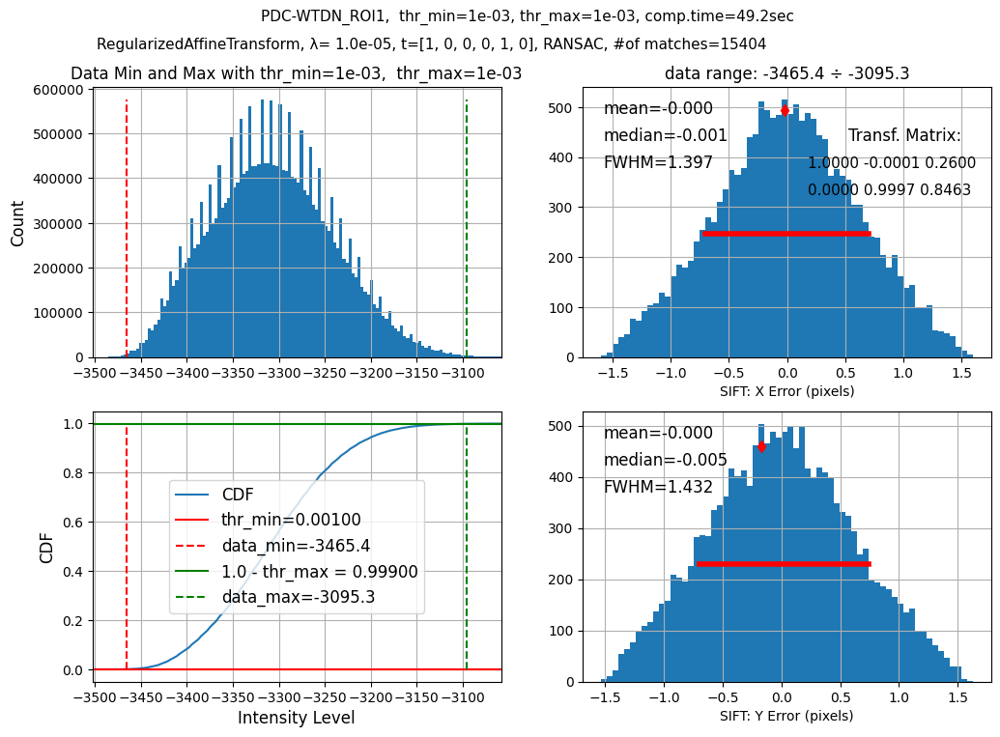

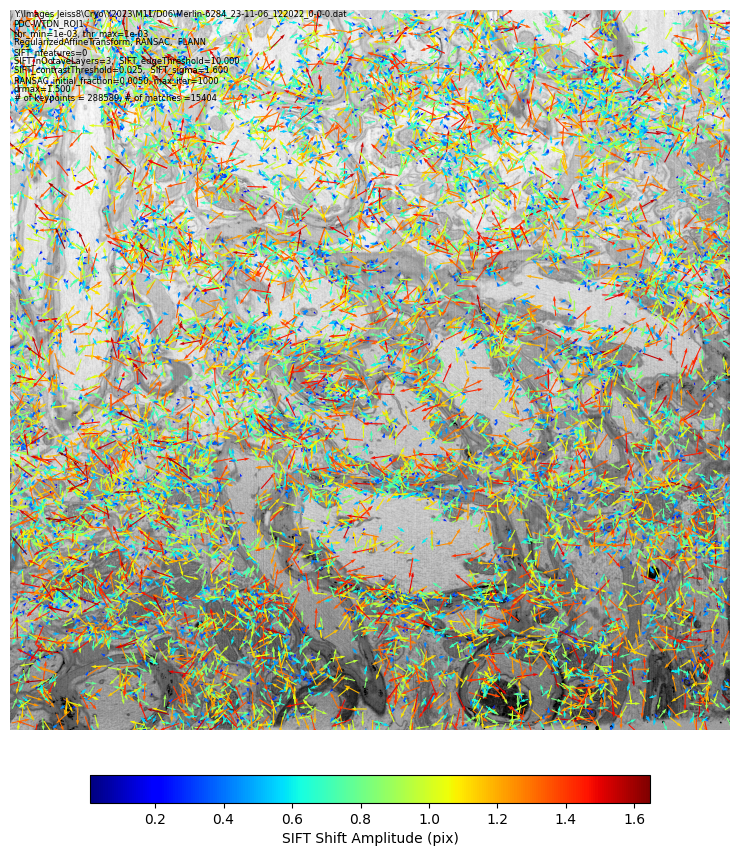

In [10]:
%%time
SIFT_evaluation_results = test_dataset.SIFT_evaluation()

# Step 1a. Evaluate Field Flatness and determine Correction Parameters

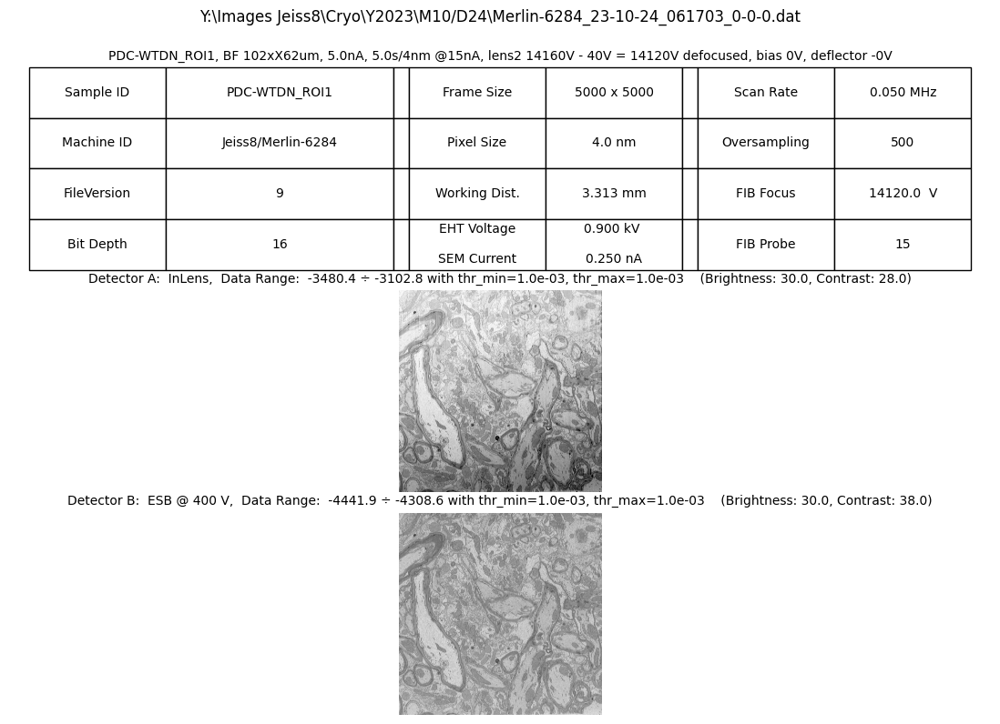

In [11]:
test_frame_ind = 500
test_frame = FIBSEM_frame(fls[test_frame_ind])
test_frame.save_snapshot()

Estimator coefficients 1, x, y, x^2, x y, y^2 :  [0.         0.35703217 3.24315007 0.04868417 0.06212668 0.25777718]
Estimator intercept:  802.9656398055362
Estimator coefficients 1, x, y, x^2, x y, y^2 :  [ 0.          0.66998556  1.54442528 -0.01769355 -0.01629537 -0.04824111]
Estimator intercept:  -191.52051208642771
Image Flattening Info saved into the binary file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-10-24_061703_0-0-0_flatfield_corr.bin


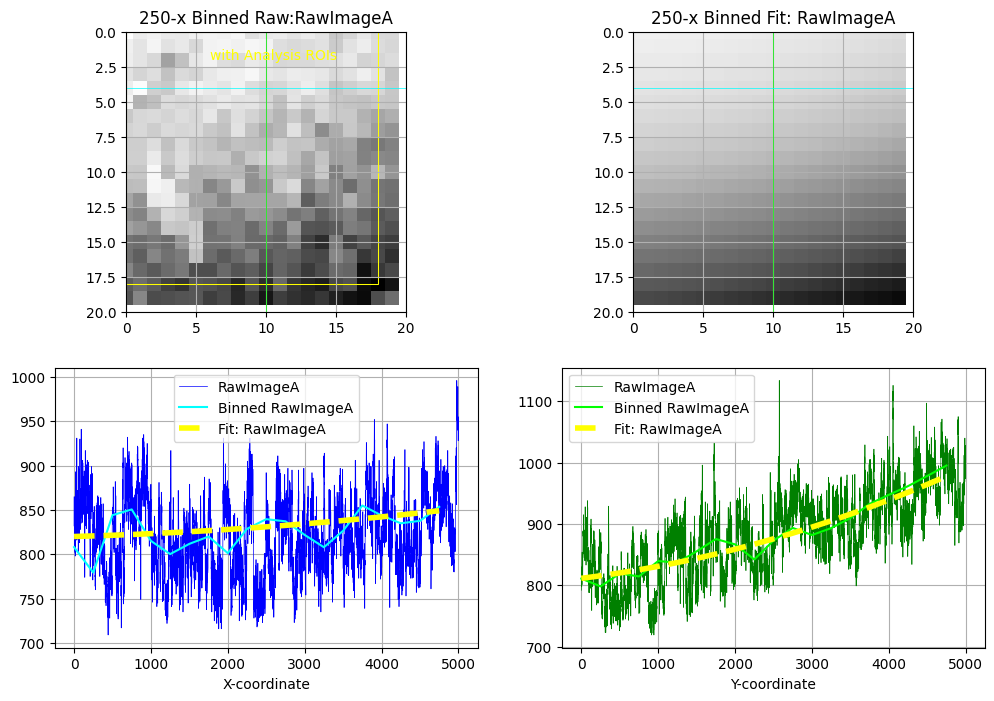

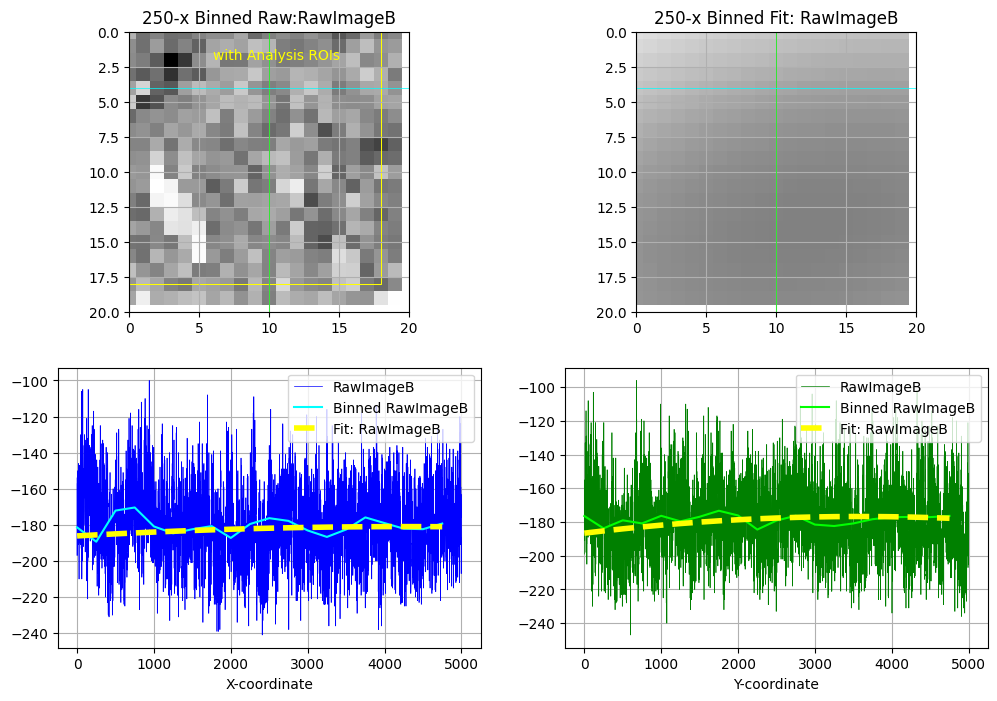

In [12]:
Analysis_ROIs=[[0, 5000, 0, 5000]]

corr_fname_png = os.path.splitext(os.path.split(fls[test_frame_ind])[1])[0] + '_flatfield_corr.png'
res_fname = os.path.join(data_dir, corr_fname_png)
flattening_params = test_frame.determine_field_fattening_parameters(image_names = ['RawImageA', 'RawImageB'],
                                                                     estimator = RANSACRegressor(),
                                                                     bins=250, Analysis_ROIs=Analysis_ROIs,
                                                                    Ysect=1000,
                                                                     calc_corr=True, save_correction_binary=True,
                                                                   res_fname = res_fname)

# Step 1b. Test Image Correction (Flattening)


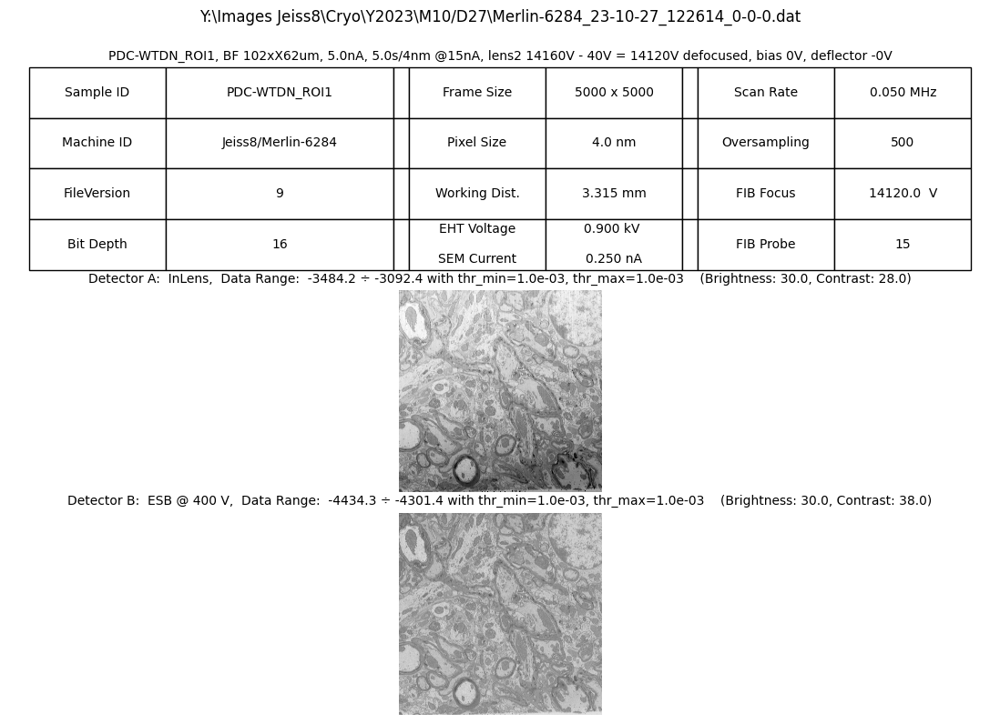

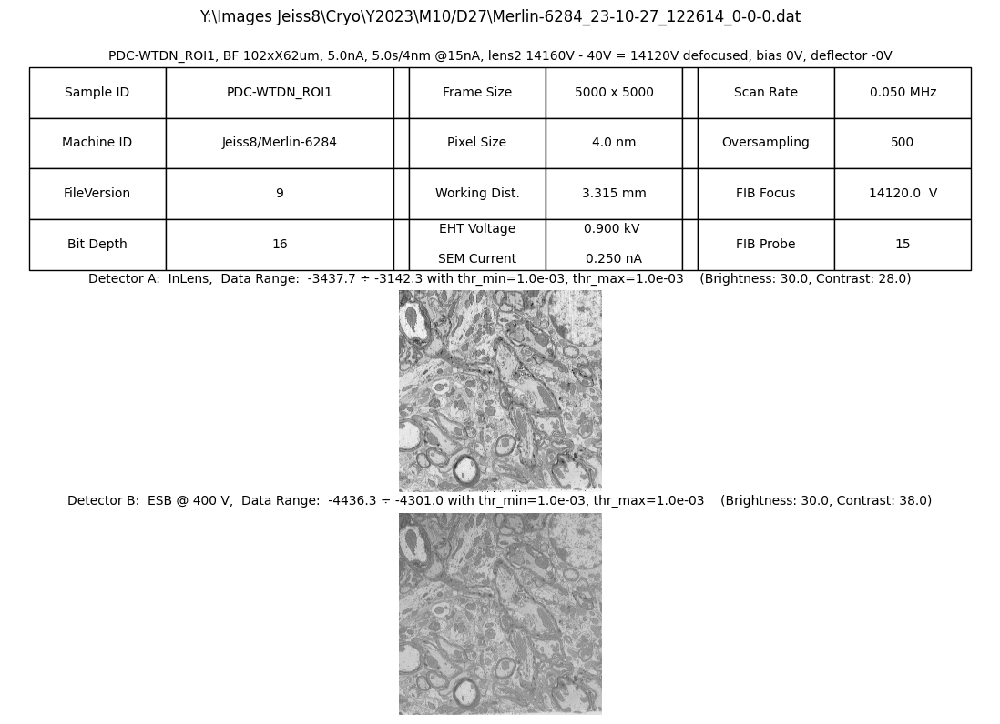

In [13]:
# test image correction
fr_ind = 1000
eval_frame = FIBSEM_frame(fls[fr_ind])
orig_snapshot_name = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace('.dat', '_original_snapshot.png'))
eval_frame.save_snapshot(snapshot_name = orig_snapshot_name)
flattened_snapshot_name = os.path.join(data_dir, os.path.split(fls[fr_ind])[1].replace('.dat', '_flattened_snapshot.png'))
eval_frame.RawImageA, eval_frame.RawImageB = eval_frame.flatten_image(image_correction_file = test_frame.image_correction_file)
eval_frame.save_snapshot(snapshot_name = flattened_snapshot_name)

In [14]:
# if all is good - assign the image correction file to the test_dataset object
test_dataset.image_correction_file = test_frame.image_correction_file

# This is where the data processing begins. Perform SIFT Computations using DASK Distributed (local cluster, using SCATTER, MAP and GATHER)

# Step 2: Save InLens.tif Data (Optional)

In [15]:
if save_data_as_tiff:
    test_dataset.convert_raw_data_to_tif_files(DASK_client=client)

# Step 2b: Step 2b: Evaluate parameters of FIBSEM data set (Data Min/Max, Working Distance, Milling Y Voltage, FOV center positions)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Evaluating the parameters of FIBSEM data set (data Min/Max, Working Distance, Milling Y Voltage, FOV center positions, Scan Rate, EHT)
2025/08/05  13:03:01   Using DASK distributed


Converting the Results:   0%|          | 0/5058 [00:00<?, ?it/s]

Using fit_params:  SG 11 3
2025/08/05  13:13:39   Saving the FIBSEM dataset statistics (Min/Max, Mill Rate, FOV Shifts into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\FIBSEM_Data.xlsx
Z pixel = 3.68 nm  - based on WD data
Z pixel = 3.65 nm  - based on Milling Voltage data
Using fit_params:  SG 11 3
CPU times: total: 2min 11s
Wall time: 10min 51s


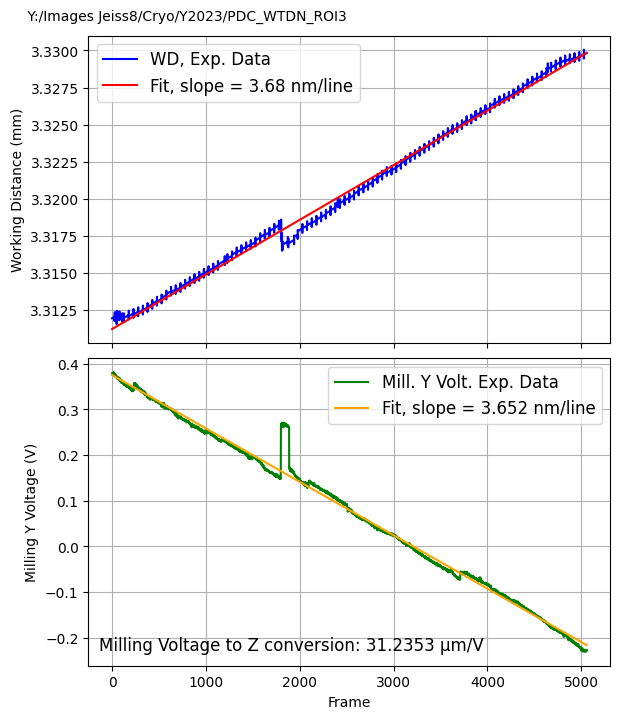

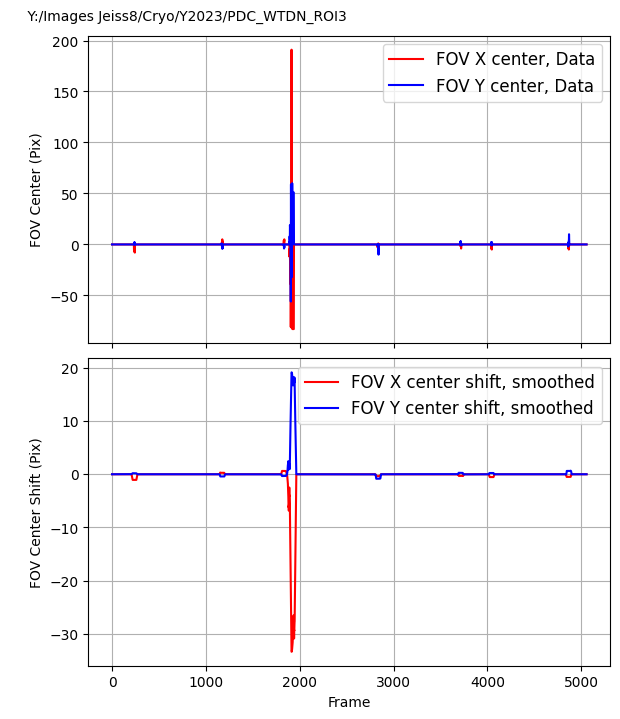

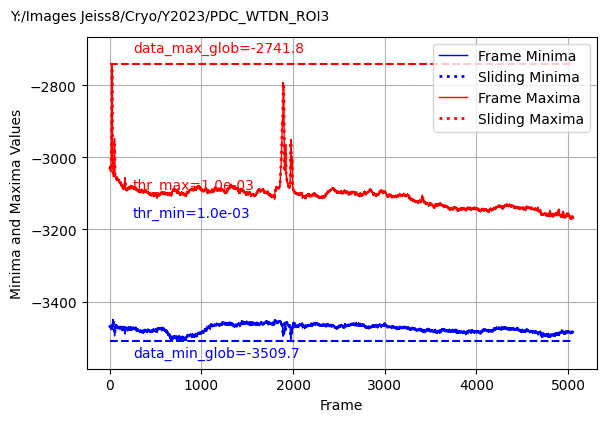

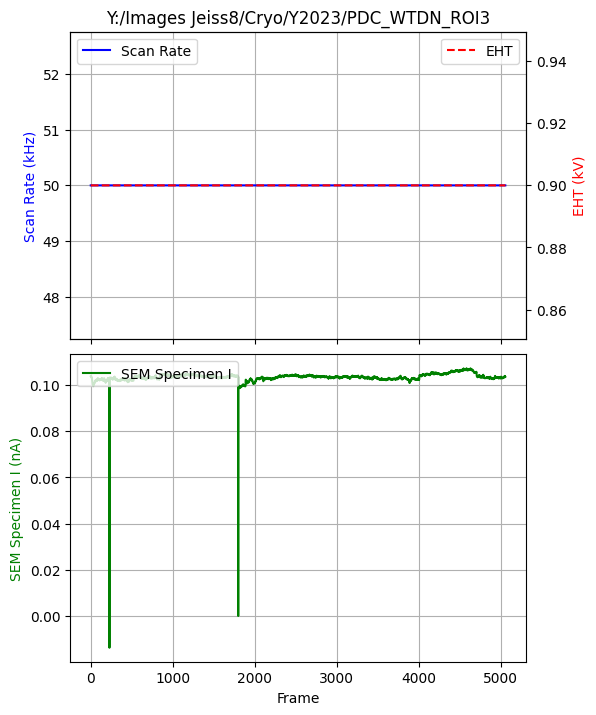

In [16]:
%%time
FIBSEM_Data = test_dataset.evaluate_FIBSEM_statistics(DASK_client=client, fit_params = ['SG', 11, 3])
generate_report_mill_rate_xlsx(FIBSEM_Data[0])
generate_report_FOV_center_shift_xlsx(FIBSEM_Data[0])
generate_report_data_minmax_xlsx(FIBSEM_Data[0])
generate_report_ScanRate_EHT_xlsx(FIBSEM_Data[0])

In [17]:
# check voxel size set based on the above calculations, change if needed 
test_dataset.voxel_size

rec.array((3.999928, 3.999928, 3.682632),
          dtype=[('x', '<f4'), ('y', '<f4'), ('z', '<f4')])

# Steps 3 and 4: Extract Key Points and Descriptors, Find Matches and Transformations

Step 3: Extract Key Points and Descriptors
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
2025/08/05  14:33:55   Using DASK distributed
Step 3: Elapsed time: 12721.72 seconds

Step 4: Select Good Matches with FLANN matcher
Step 4: using RegularizedAffineTransform Transformation Model with RANSAC solver
Step 4: RegularizedAffineTransform parameters:
Step 4: Regularization matrix: 
[[1.e-05 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00]
 [0.e+00 1.e-05 0.e+00 0.e+00 0.e+00 0.e+00]
 [0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00]
 [0.e+00 0.e+00 0.e+00 1.e-05 0.e+00 0.e+00]
 [0.e+00 0.e+00 0.e+00 0.e+00 1.e-05 0.e+00]
 [0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00]]
Step 4: Target Solution:  [1 0 0 0 1 0]
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
2025/08/05  18:05:57   Using DASK distributed
Mean Number of Keypoints : 17159
Step 4: Elapsed time: 17153.96

Calculating Cummilative Transformation Matrix:   0%|          | 0/5057 [00:00<?, ?it/s]

Recalculating the shifts for preserved scales:   0%|          | 0/5057 [00:00<?, ?it/s]

CPU times: total: 1h 15min 44s
Wall time: 8h 21min 34s


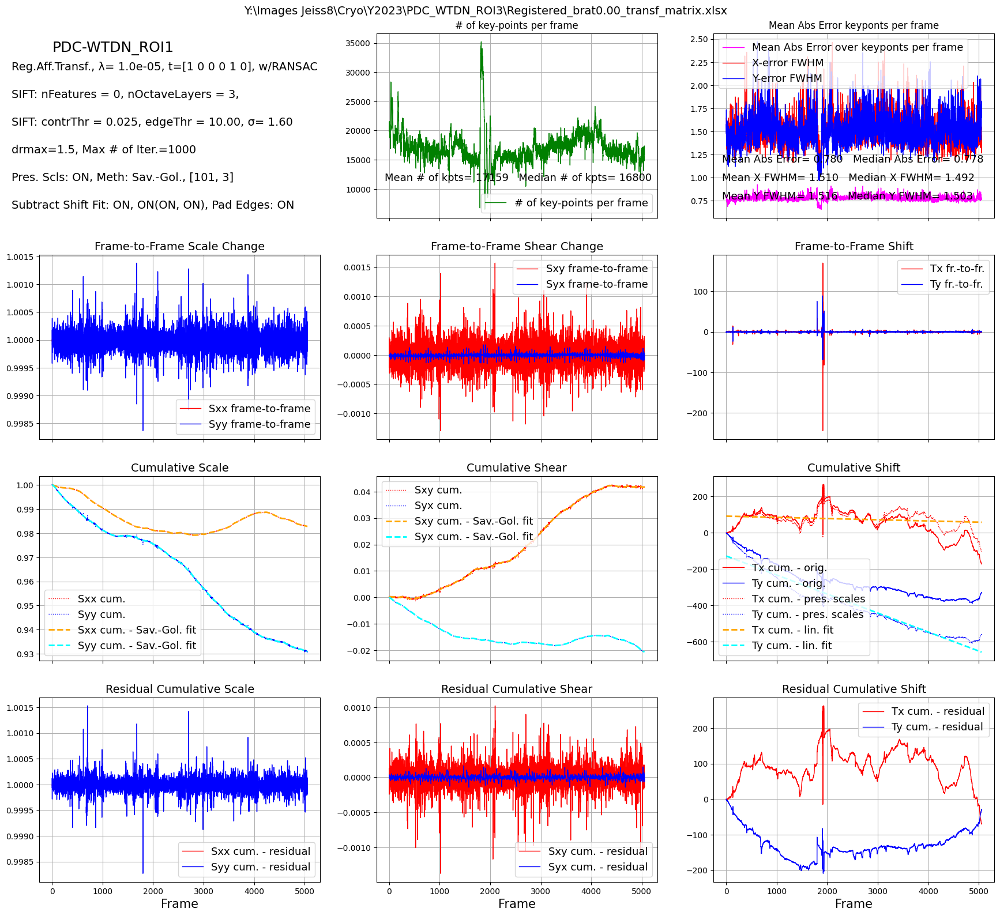

In [18]:
%%time
# Step 3: Extract Key Points and Descriptors using DASK Distributed
t1 = time.time()
print('Step 3: Extract Key Points and Descriptors')
fnms = test_dataset.extract_keypoints(DASK_client=client)   
t2 = time.time()
print('Step 3: Elapsed time: {:.2f} seconds'.format(t2 - t1))
print('')

# Step 4: Select good matches and extract transformation parameters using DASK Distributed
matcher_str = 'BF' if BFMatcher else 'FLANN'
print('Step 4: Select Good Matches with ' + matcher_str + ' matcher')
print('Step 4: using ' + test_dataset.TransformType.__name__ + ' Transformation Model with ' + solver + ' solver')
if test_dataset.TransformType == RegularizedAffineTransform:
    print('Step 4: ' + test_dataset.TransformType.__name__ + ' parameters:')
    print('Step 4: Regularization matrix: ')
    print(test_dataset.l2_matrix)
    print('Step 4: Target Solution: ', test_dataset.targ_vector)

results_s4 = test_dataset.determine_transformations(DASK_client=client)
t3 = time.time()
print('Step 4: Elapsed time: {:.2f} seconds'.format(t3 - t2))

tr_matr_cum_residual, tr_matr_cum_xlsx_file = test_dataset.process_transformation_matrix()
generate_report_transf_matrix_from_xlsx(tr_matr_cum_xlsx_file)

In [19]:
# here is an example of how the previous step can be modified easily without having to re-do all previous steps
# this will calculate the cumulative transformation matrix WITHOT modifying the object property subtract_linear_fit
# so this change will NOT propagate.
# tr_matr_cum_residual = test_dataset.process_transformation_matrix(subtract_linear_fit = [False, True])

# if you want to make permanet change, then you should do this:
# test_dataset.subtract_linear_fit = [False, True]
# tr_matr_cum_residual = test_dataset.process_transformation_matrix()


# Step 5: Search for frames with no (or low # of) matches and possibly remove them.

In [20]:
thr_npt = 3   # consider frame with less than 3 Key Points for removal
tr_matr_cum_residual = test_dataset.check_for_nomatch_frames(thr_npt, **SIFT_kwargs)

Frames with no matches to the next frame:   []
Frames to remove:   []
No frames selected for removal


# Step 6: Recall or Save the Intermediate Data (KeyPoints, Matches, Transf.Matrix, etc.) from / into spreadsheets and a binary files.  Remove the intermediate KeyPoint/Descriptor files.

In [21]:
recall_the_data = False          # if False, the data will be saved. if True, the data will be recalled

dump_filename = os.path.join(data_dir, test_dataset.fnm_reg.replace('.mrc', '_params.bin'))

if recall_the_data:
    test_dataset = FIBSEM_dataset(fls, recall_parameters=True, dump_filename=dump_filename, disp_res=True, **SIFT_kwargs)
else:
    saved_dump_file = test_dataset.save_parameters(dump_file=dump_filename)
    print('Parameters saved into the file: ', saved_dump_file)

Parameters saved into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Registered_brat0.00_params.bin


In [22]:
remove_key_points_data = True   # if True, the binary files with intermediate keypoints data for each frame will be removed

# Remove temporary files
if remove_key_points_data:
    # Remove the keypoint/ descriptor files
    for fnm in tqdm(test_dataset.fnms, desc='Removing KeyPoint/Descriptor Files: '):
        try:
            os.remove(os.path.join(data_dir, fnm))
        except:
            pass
    for fnm in tqdm(test_dataset.fnms_matches, desc='Removing Matched KeyPoint Files: '):
        try:
            os.remove(os.path.join(data_dir, fnm))
        except:
            pass

Removing KeyPoint/Descriptor Files:   0%|          | 0/5058 [00:00<?, ?it/s]

Removing Matched KeyPoint Files:   0%|          | 0/5057 [00:00<?, ?it/s]

# Define Evaluation Box

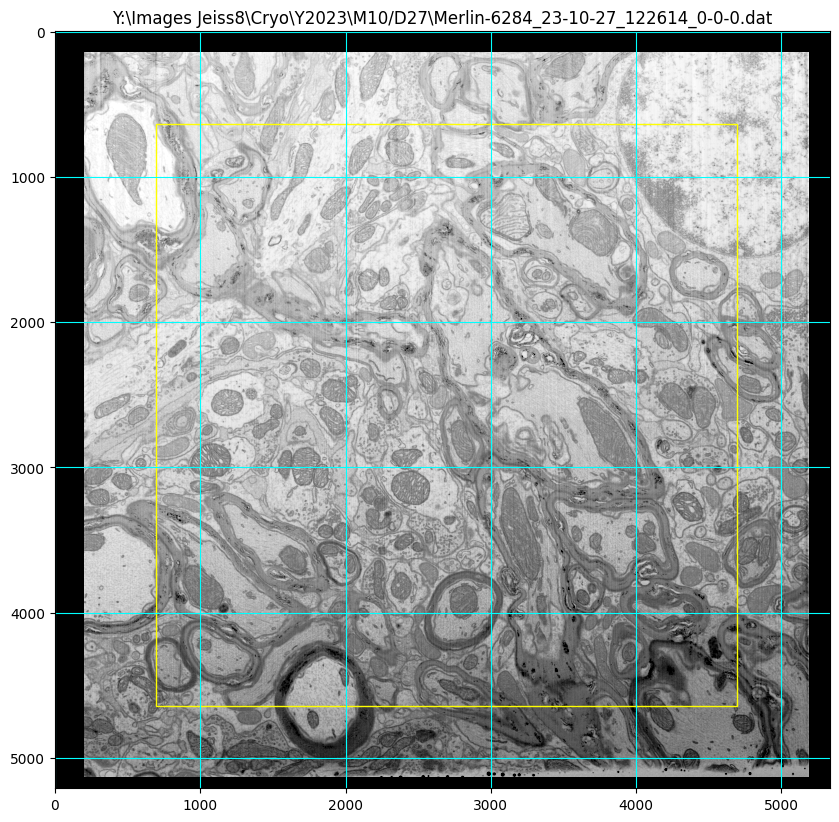

In [23]:
#evaluation_box = [250, 2000, 1450, 2650]      # optional evaluation box for defining the area over which the registration quality
#test_dataset.show_eval_box(evaluation_box = evaluation_box, invert_data=False)
#
# default frames are three frames: 10% from the start, 50% from the start, and 90% from the start
# alternatively you can set any list of frame indecis by using keyword frame_indices
# for example:0
# test_dataset.show_eval_box(frame_indices=[1, 100, 850], evaluation_box = evaluation_box, invert_data=False)
#
fr_ind = 1000
evaluation_box = [500, 4000, 500, 4000]
test_dataset.show_eval_box(invert_data=False, frame_inds=[fr_ind], evaluation_box=evaluation_box)

# Evaluate Image B fraction for fused image using Auto-Correlation and Cross-Correlation

Analyzing Auto-Correlation SNRs :   0%|          | 0/1 [00:00<?, ?it/s]

Analyzing the Detector A Image
2025/08/05  23:02:31   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-10-27_122614_0-0-0_ImgA_SNR.png
Analyzing the Detector B Image
2025/08/05  23:02:43   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-10-27_122614_0-0-0_ImgB_SNR.png


Re-analyzing Auto-Correlation SNRs for fused image:   0%|          | 0/1 [00:00<?, ?it/s]

Analyzing the Fused Image, Det B fraction = 0.0426
2025/08/05  23:02:56   Saved the results into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\Merlin-6284_23-10-27_122614_0-0-0_ImgB_fr0.043_SNR.png
CPU times: total: 42.4 s
Wall time: 38.2 s


(0.07005547502364626, 0.03988832729194553, 0.042594225558779196)

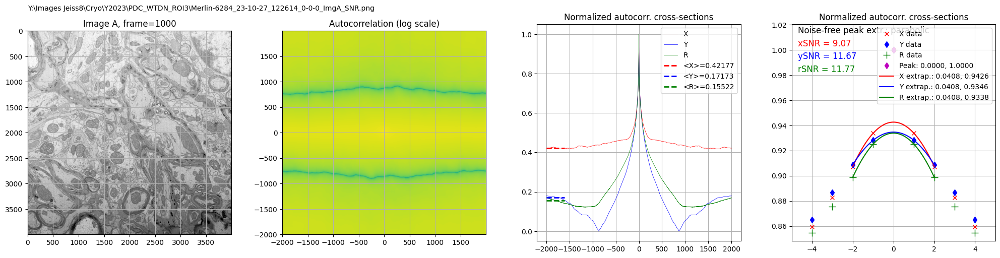

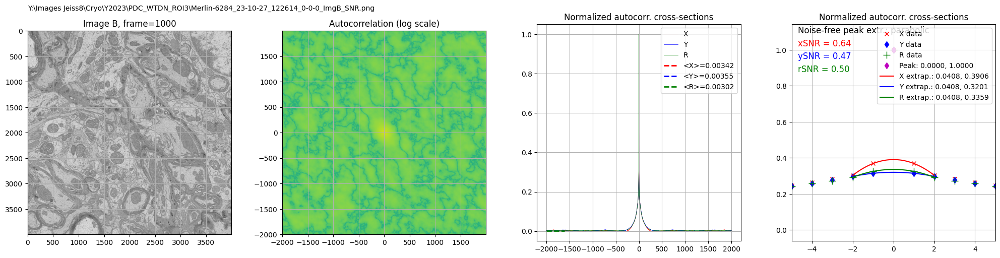

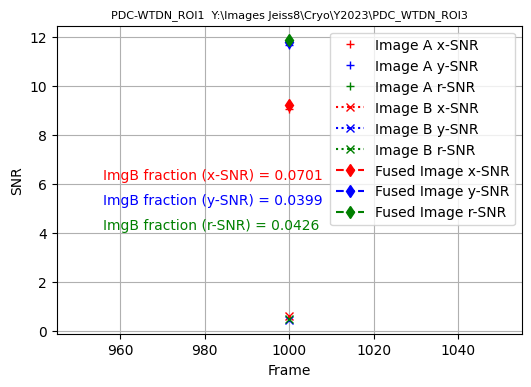

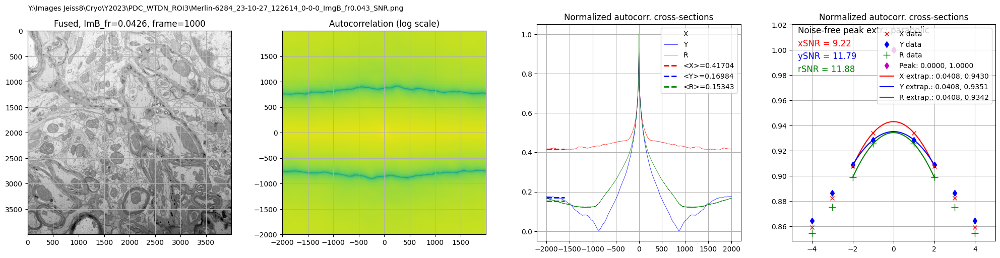

In [24]:
%%time
fr_ind = 1000
evaluation_box = [500, 4000, 500, 4000]
test_dataset.estimate_SNRs(frame_inds=[fr_ind],
                           #ImgB_fraction = 0.08,
                           perform_transformation = False,
                           evaluation_box = evaluation_box, save_res_png=True)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress


Evaluating Img B fractions:   0%|          | 0/11 [00:00<?, ?it/s]

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
DASK client exists. Will

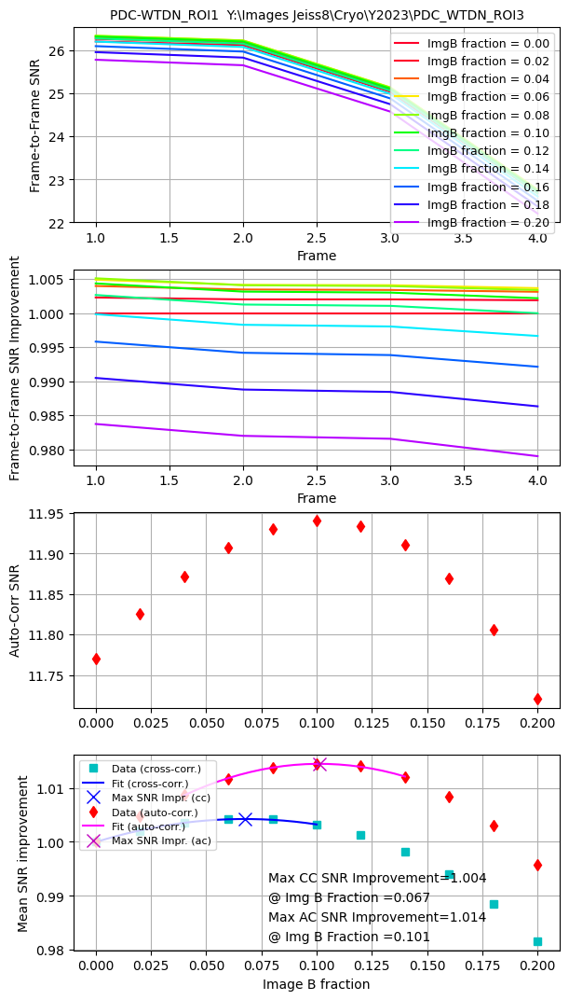

In [25]:
%%time
evaluation_box = [500, 4000, 500, 4000]
frame_inds = 1000 + np.arange(5)
ImgB_fractions = np.linspace(0.00, 0.20, 11)
ImgB_fr_optimal_mid = test_dataset.evaluate_ImgB_fractions(ImgB_fractions, frame_inds,
                                                           DASK_client=client, use_DASK=True,
                                                           evaluation_box = evaluation_box)

# Step 7: Transform and Save the FIB-SEM data

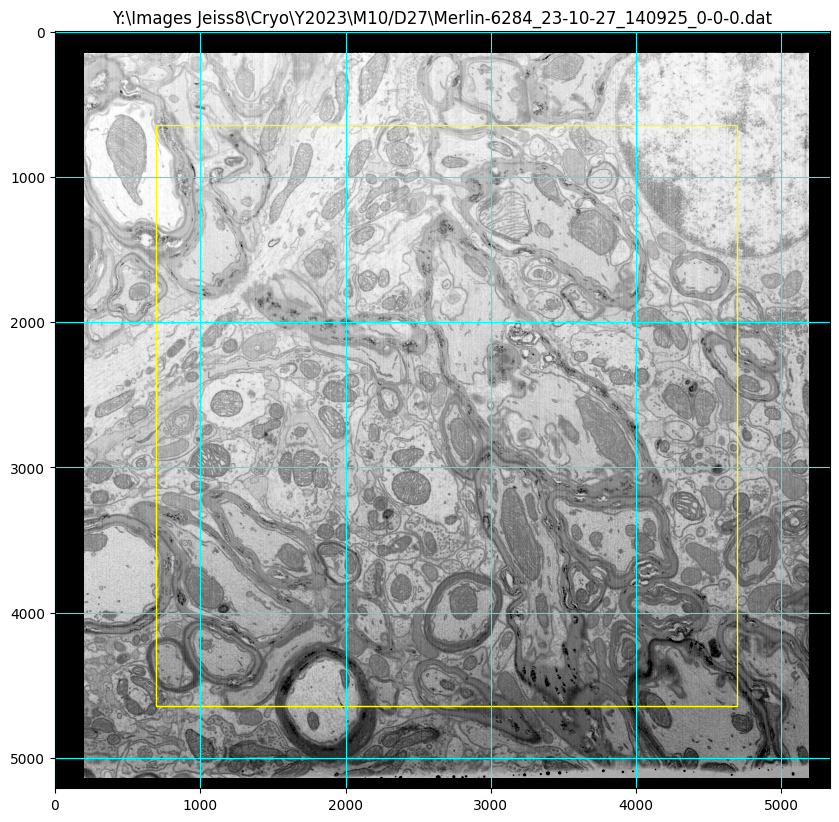

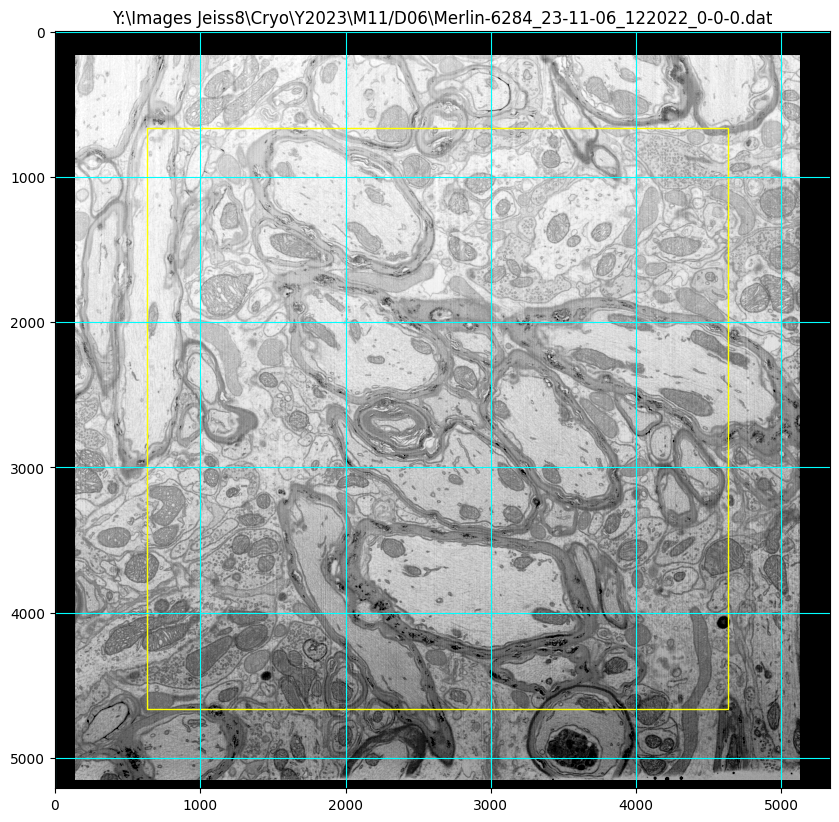

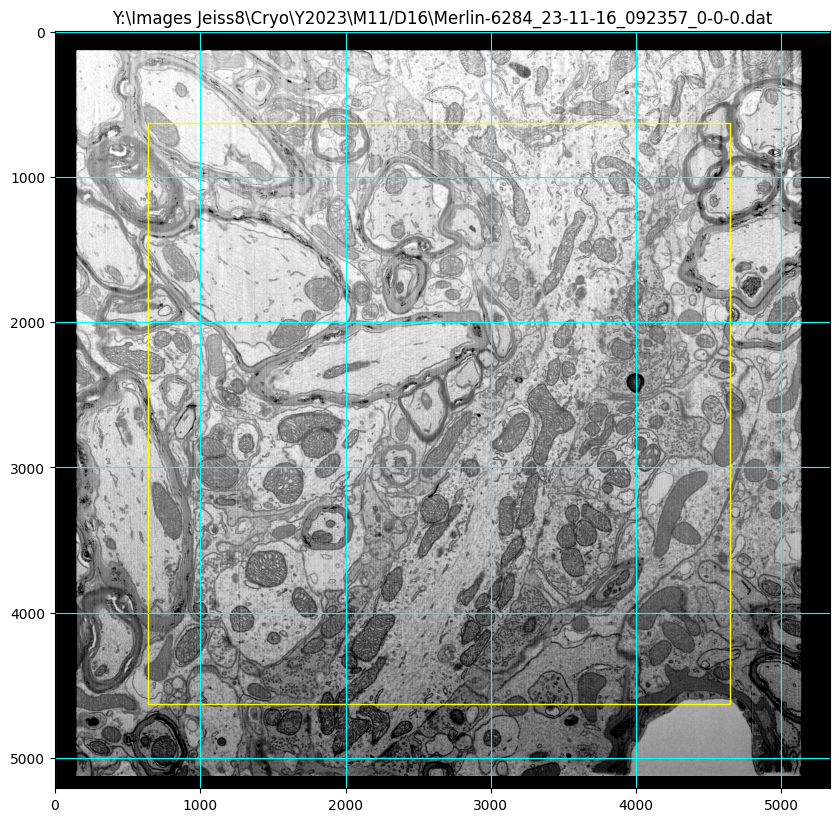

In [26]:
evaluation_box = [500, 4000, 500, 4000]
test_dataset.show_eval_box(invert_data=False,
                           frame_inds = [nfrs//5, nfrs//2, nfrs//5*4],
                           evaluation_box=evaluation_box)

Step 7: Transform and Save the FIB-SEM data
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Transforming and Saving Intermediate Registered Frames
Determining padding offsets


Setting up parameter sets:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/05  23:06:43   Transform and Save Chunks of Frames: Starting DASK jobs


C:\Users\labadmin\anaconda3\lib\site-packages\distributed\client.py:3362: UserWarning: Sending large graph of size 196.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


2025/08/05  23:31:05   Finished DASK jobs
Analyzing Registration Quality
2025/08/05  23:31:09   Analyzing Frame Registration: Starting DASK jobs
2025/08/06  00:02:32   Finished DASK jobs
2025/08/06  00:02:50   Saving the Registration Quality Statistics into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00_RegistrationQuality.xlsx
Registered data set is NOT saved into a file


Removing Intermediate Registered Frame Files:   0%|          | 0/5058 [00:00<?, ?it/s]

CPU times: total: 30min 7s
Wall time: 1h 2min 58s


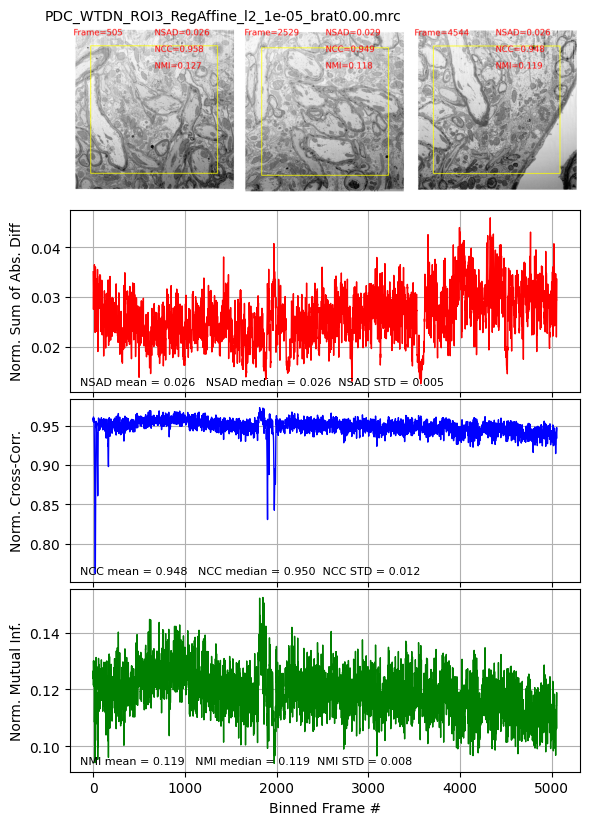

In [27]:
%%time

print('Step 7: Transform and Save the FIB-SEM data')

test_dataset.fnm_reg = 'PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00.mrc'

evaluation_box = [500, 4000, 500, 4000]

reg_summary_RegAffine_ImB0p00, reg_summary_RegAffine_ImB0p00_xlsx = test_dataset.transform_and_save(DASK_client=client,
                                                        save_transformed_dataset = False,
                                                        save_registration_summary = True,
                                                        flatten_image = False,
                                                        ImgB_fraction=0.00,
                                                        add_offset = True,
                                                        zbin_factor = 1,
                                                        evaluation_box = evaluation_box,
                                                        sliding_evaluation_box = False,
                                                        fnm_types = ['mrc'])

generate_report_from_xls_registration_summary(reg_summary_RegAffine_ImB0p00_xlsx, sample_frames_layout = 'horizontal')

Step 7: Transform and Save the FIB-SEM data
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Transforming and Saving Intermediate Registered Frames
Determining padding offsets


Setting up parameter sets:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  00:09:43   Transform and Save Chunks of Frames: Starting DASK jobs


C:\Users\labadmin\anaconda3\lib\site-packages\distributed\client.py:3362: UserWarning: Sending large graph of size 196.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


2025/08/06  00:49:43   Finished DASK jobs
Analyzing Registration Quality
2025/08/06  00:49:47   Analyzing Frame Registration: Starting DASK jobs
2025/08/06  01:21:21   Finished DASK jobs
2025/08/06  01:21:35   Saving the Registration Quality Statistics into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00_flattened_RegistrationQuality.xlsx
Registered data set is NOT saved into a file


Removing Intermediate Registered Frame Files:   0%|          | 0/5058 [00:00<?, ?it/s]

CPU times: total: 32min 18s
Wall time: 1h 15min 35s


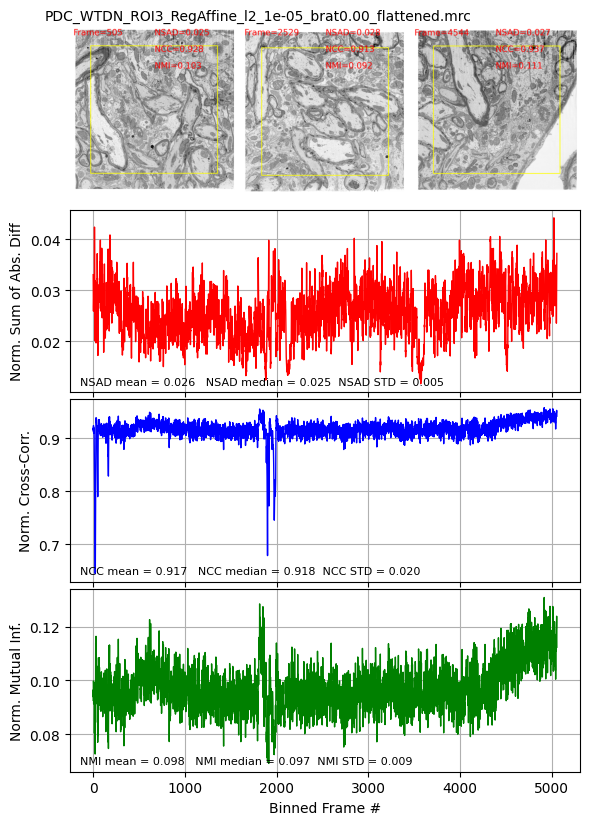

In [28]:
%%time

print('Step 7: Transform and Save the FIB-SEM data')

test_dataset.fnm_reg = 'PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00_flattened.mrc'

evaluation_box = [500, 4000, 500, 4000]

reg_summary_RegAffine_ImB0p00_flattened, reg_summary_RegAffine_ImB0p00_flattened_xlsx = test_dataset.transform_and_save(DASK_client=client,
                                                        save_transformed_dataset = False,
                                                        save_registration_summary = True,
                                                        flatten_image = True,
                                                        ImgB_fraction=0.00,
                                                        add_offset = True,
                                                        zbin_factor = 1,
                                                        evaluation_box = evaluation_box,
                                                        sliding_evaluation_box = False,
                                                        fnm_types = ['mrc'])

generate_report_from_xls_registration_summary(reg_summary_RegAffine_ImB0p00_flattened_xlsx, sample_frames_layout = 'horizontal')

Step 7: Transform and Save the FIB-SEM data
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Transforming and Saving Intermediate Registered Frames
Determining padding offsets


Setting up parameter sets:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  01:25:19   Transform and Save Chunks of Frames: Starting DASK jobs


C:\Users\labadmin\anaconda3\lib\site-packages\distributed\client.py:3362: UserWarning: Sending large graph of size 196.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


2025/08/06  02:09:13   Finished DASK jobs
Analyzing Registration Quality
2025/08/06  02:09:16   Analyzing Frame Registration: Starting DASK jobs
2025/08/06  02:40:27   Finished DASK jobs
2025/08/06  02:40:41   Saving the Registration Quality Statistics into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_RegistrationQuality.xlsx
Creating Dask Array Stack
The resulting stack shape will be  nx=5334, ny=5209, nz=5058,  data type: <class 'numpy.int16'>
Voxel destreak_mrc_stackSize (nm): 3.999928 x 3.999928 x 3.682632
2025/08/06  02:40:46   Saving dataset into MRC file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened.mrc
The resulting stack will saved using mrc_mode=1,  data type= <class 'numpy.int16'>


Saving Chunks of Frames into MRC File:   0%|          | 0/11 [00:00<?, ?it/s]

Removing Intermediate Registered Frame Files:   0%|          | 0/5058 [00:00<?, ?it/s]

CPU times: total: 1h 27min
Wall time: 3h 1min 45s


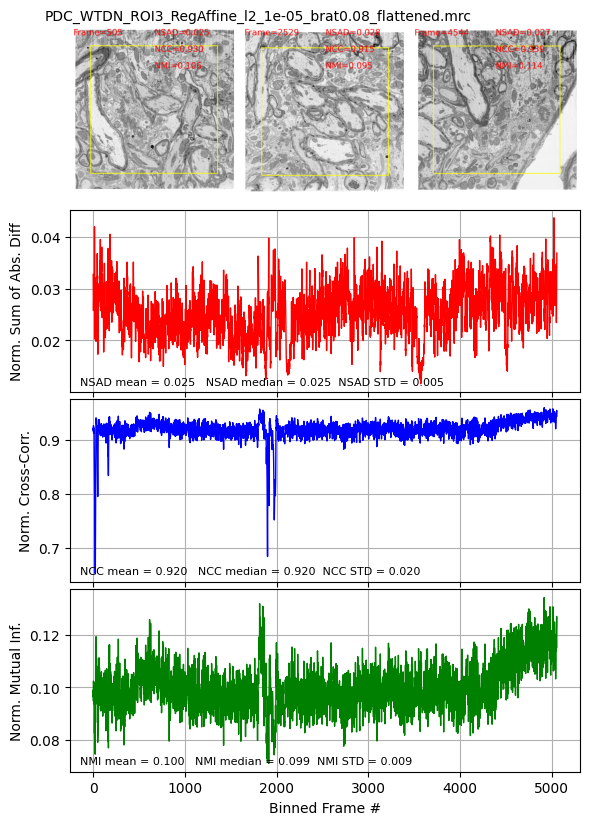

In [29]:
%%time

print('Step 7: Transform and Save the FIB-SEM data')

test_dataset.fnm_reg = 'PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened.mrc'

evaluation_box = [500, 4000, 500, 4000]

reg_summary_RegAffine_ImB0p08_flattened, reg_summary_RegAffine_ImB0p08_flattened_xlsx = test_dataset.transform_and_save(DASK_client=client,
                                                        save_transformed_dataset = True,
                                                        save_registration_summary = True,
                                                        flatten_image = True,
                                                        ImgB_fraction=0.08,
                                                        add_offset = True,
                                                        zbin_factor = 1,
                                                        evaluation_box = evaluation_box,
                                                        sliding_evaluation_box = False,
                                                        fnm_types = ['mrc'],
                                                        chunked_mrc_write = True,
                                                        chunk_length = 500)

generate_report_from_xls_registration_summary(reg_summary_RegAffine_ImB0p08_flattened_xlsx, sample_frames_layout = 'horizontal')

In [30]:
%%time
orig_mrc = os.path.normpath('Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened.mrc')
binned_mrc = orig_mrc.replace('.mrc', '_16nm.mrc')
bin_crop_mrc_stack(orig_mrc,
                   binned_copped_filename  = binned_mrc,
                   DASK_client=client,
                  xbin_factor=4,
                  ybin_factor=4,
                  zbin_factor=4)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Source mrc_mode: 1, source data type: <class 'numpy.int16'>
Source Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321
2025/08/06  04:26:45   Result mrc_mode: 1, source data type: <class 'numpy.int16'>


Building Parameters Sets:   0%|          | 0/1265 [00:00<?, ?it/s]

2025/08/06  04:26:45   New Data Set Shape:  1333 x 1302 x 1265
2025/08/06  04:27:09   Result Voxel Size (Angstroms): 159.997116 x 159.997116 x 147.305283
2025/08/06  04:27:09   Using DASK distributed
2025/08/06  04:27:09   Starting DASK batch 0 with 1265 jobs
CPU times: total: 3min 11s
Wall time: 7min 36s


['Y:\\Images Jeiss8\\Cryo\\Y2023\\PDC_WTDN_ROI3\\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_16nm.mrc']

array([  0.     , 958.90625])

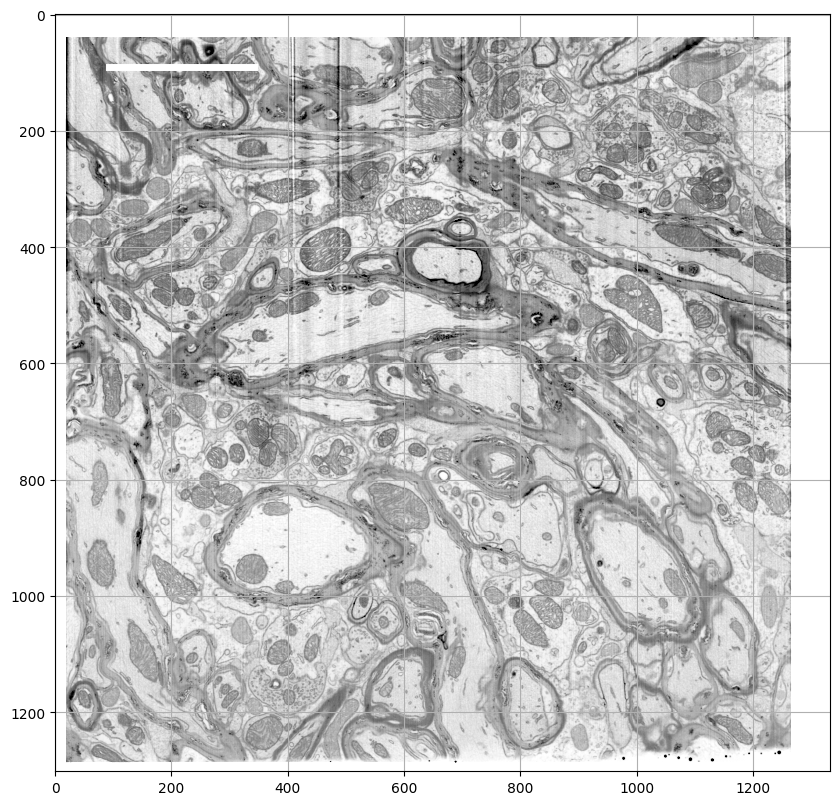

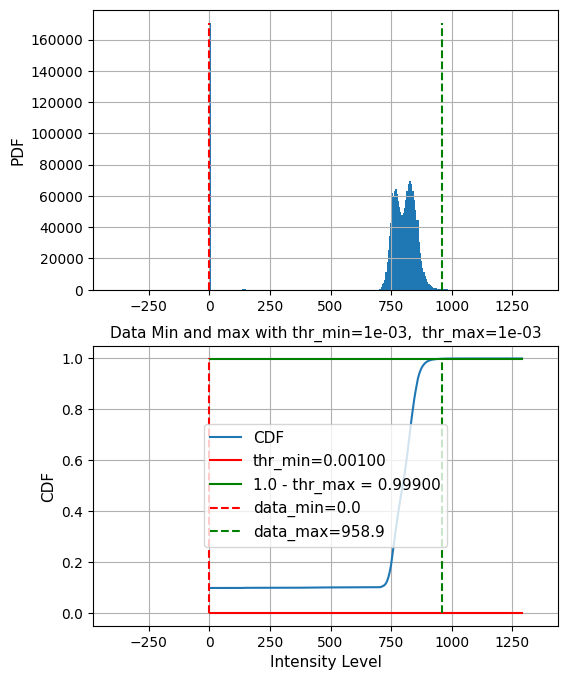

In [31]:
binned_mrc = 'Y:/Images Jeiss8/Cryo/Y2023/PDC_WTDN_ROI3/PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_16nm.mrc'

mrc_obj = mrcfile.mmap(binned_mrc, mode='r', permissive=True)
header = mrc_obj.header
'''
    mode 0 -> uint8
    mode 1 -> int16
    mode 2 -> float32
    mode 4 -> complex64
    mode 6 -> uint16
'''
mrc_mode = mrc_obj.header.mode
test_frame_ind = 500
test_frame = mrc_obj.data[test_frame_ind, :, :]
mrc_obj.close()

vmin, vmax = get_min_max_thresholds(test_frame[200: -200, 200: -200], disp_res=False)
fig, ax = plt.subplots(1,1, figsize=(10, 10))
ax.imshow(test_frame, cmap='Greys', vmin=vmin, vmax=vmax)
ax.grid(True)
#ax.axis(False)
#ax.axis(False)
add_scale_bar(ax, pixel=0.004, bar_length=5.0, bar_width=5, bar_label='')

get_min_max_thresholds(test_frame)

2025/08/06  04:34:24   EM cross-sections dimensions (um): [21.32761557 20.83162451 18.63411825]
Center coordinates (um): [10.66380779 10.41581226  9.31705912]


Loading EM Cross-sections Data:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  04:34:24   X-Y cross-section loaded, dimensions (pixels): 1333 1302
2025/08/06  04:34:24   X-Z cross-section loaded, dimensions (pixels): 1333 1265
2025/08/06  04:34:24   Y-Z cross-section loaded, dimensions (pixels): 1302 1265


Determining EM data range:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  04:35:22   Will use EM-data range: 704.8 - 950.0
Generating Cross-Section Images
2025/08/06  04:35:22   Generating X-Y cross-section
2025/08/06  04:35:22   Generating Y-Z cross-section
2025/08/06  04:35:53   Generating X-Z cross-section
2025/08/06  04:35:53   Saving image into:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_16nm_crosssections.png


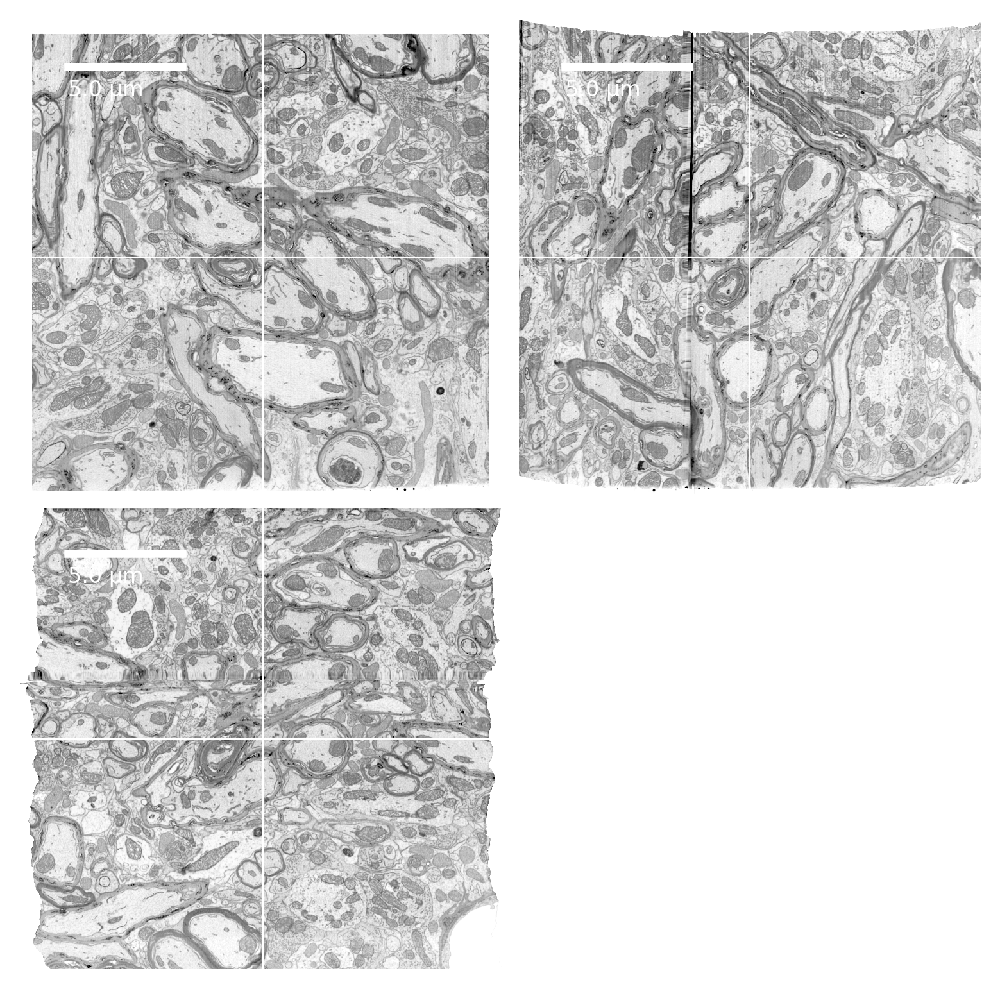

In [32]:
binned_mrc = 'Y:/Images Jeiss8/Cryo/Y2023/PDC_WTDN_ROI3/PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_16nm.mrc'
images, axs = plot_cross_sections_mrc_stack(binned_mrc,
                                            bar_width = 3,
                                            bar_length_um = 5,
                                            label_offset = 30,
                                            label_font_size = 8.0,
                                            EM_max = 950,
                                            dpi=300)

# Establish the parameters for intensity rescaling to account for SEM current fluctuations

In [33]:
RawImageA_results_grthr[2], RawImageB_results_grthr[2]

(-4006.061950503587, -4502.645111881605)

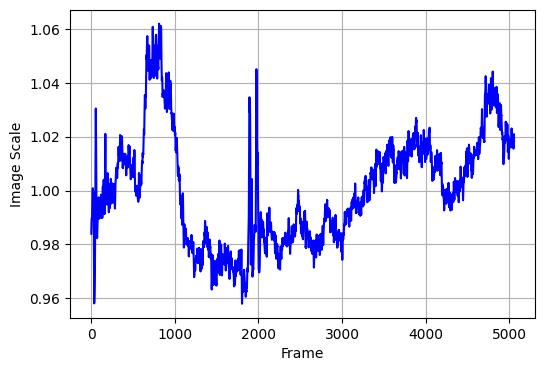

In [34]:
#DarkA = -4027.9
#DarkB = -4520.8
DarkA = RawImageA_results_grthr[2]
DarkB = RawImageB_results_grthr[2]

ImgB_fraction=0.08
image_offs = DarkA*(1.0-ImgB_fraction) + DarkB*ImgB_fraction


dmin_new = test_dataset.FIBSEM_Data[3]- DarkA
image_scales = np.mean(dmin_new)/dmin_new
fig, ax = plt.subplots(1,1, figsize = (6, 4))
ax.plot(image_scales, 'b')
ax.set_xlabel('Frame')
ax.set_ylabel('Image Scale')
ax.grid(True)

image_offsets = image_scales*0.0 + image_offs

Step 7: Transform and Save the FIB-SEM data
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Transforming and Saving Intermediate Registered Frames
Determining padding offsets


Setting up parameter sets:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  09:46:22   Transform and Save Chunks of Frames: Starting DASK jobs


C:\Users\labadmin\anaconda3\lib\site-packages\distributed\client.py:3362: UserWarning: Sending large graph of size 196.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


2025/08/06  10:31:07   Finished DASK jobs
Analyzing Registration Quality
2025/08/06  10:31:11   Analyzing Frame Registration: Starting DASK jobs
2025/08/06  11:03:25   Finished DASK jobs
2025/08/06  11:03:39   Saving the Registration Quality Statistics into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_RegistrationQuality.xlsx
Creating Dask Array Stack
The resulting stack shape will be  nx=5334, ny=5209, nz=5058,  data type: <class 'numpy.int16'>
Voxel destreak_mrc_stackSize (nm): 3.999928 x 3.999928 x 3.682632
2025/08/06  11:03:44   Saving dataset into MRC file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled.mrc
The resulting stack will saved using mrc_mode=1,  data type= <class 'numpy.int16'>


Saving Chunks of Frames into MRC File:   0%|          | 0/11 [00:00<?, ?it/s]

Removing Intermediate Registered Frame Files:   0%|          | 0/5058 [00:00<?, ?it/s]

CPU times: total: 1h 20min 7s
Wall time: 2h 53min


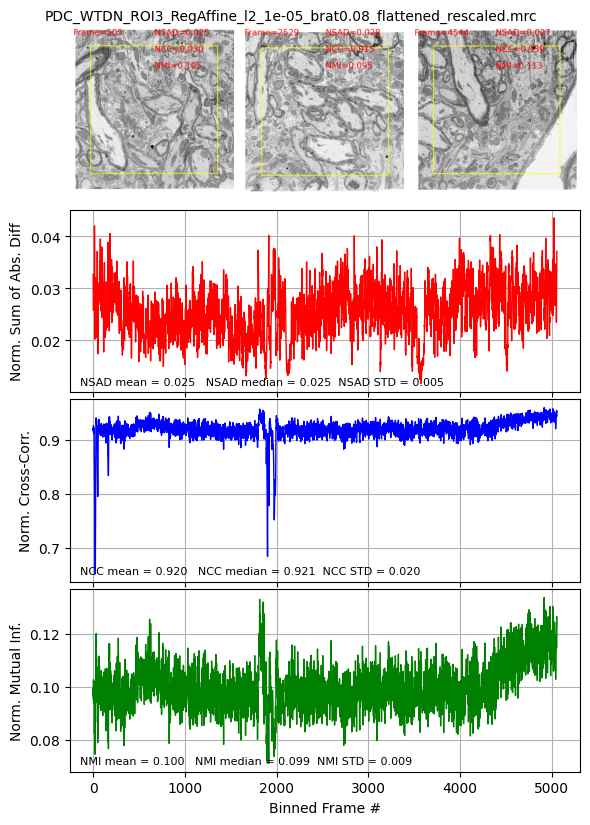

In [35]:
%%time

print('Step 7: Transform and Save the FIB-SEM data')

test_dataset.fnm_reg = 'PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled.mrc'

evaluation_box = [500, 4000, 500, 4000]

reg_summary_RegAffine_ImB0p08_flattened_rescaled, reg_summary_RegAffine_ImB0p08_flattened_rescaled_xlsx = test_dataset.transform_and_save(DASK_client=client,
                                                        save_transformed_dataset = True,
                                                        save_registration_summary = True,
                                                        flatten_image = True,
                                                        ImgB_fraction=0.08,
                                                        image_scales = image_scales,
                                                        image_offsets = image_offsets,
                                                        add_offset = True,
                                                        zbin_factor = 1,
                                                        evaluation_box = evaluation_box,
                                                        sliding_evaluation_box = False,
                                                        fnm_types = ['mrc'],
                                                        chunked_mrc_write = True,
                                                        chunk_length = 500)

generate_report_from_xls_registration_summary(reg_summary_RegAffine_ImB0p08_flattened_rescaled_xlsx, sample_frames_layout = 'horizontal')

In [36]:
orig_mrc = os.path.normpath('Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled.mrc')
binned_mrc = orig_mrc.replace('.mrc', '_16nm.mrc')
bin_crop_mrc_stack(orig_mrc,
                   DASK_client = client,
                   binned_copped_filename  = binned_mrc,
                  xbin_factor=4,
                  ybin_factor=4,
                  zbin_factor=4)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Source mrc_mode: 1, source data type: <class 'numpy.int16'>
Source Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321
2025/08/06  12:39:05   Result mrc_mode: 1, source data type: <class 'numpy.int16'>


Building Parameters Sets:   0%|          | 0/1265 [00:00<?, ?it/s]

2025/08/06  12:39:05   New Data Set Shape:  1333 x 1302 x 1265
2025/08/06  12:39:27   Result Voxel Size (Angstroms): 159.997116 x 159.997116 x 147.305283
2025/08/06  12:39:27   Using DASK distributed
2025/08/06  12:39:27   Starting DASK batch 0 with 1265 jobs


['Y:\\Images Jeiss8\\Cryo\\Y2023\\PDC_WTDN_ROI3\\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_16nm.mrc']

2025/08/06  12:46:34   EM cross-sections dimensions (um): [21.32761557 20.83162451 18.63411825]
Center coordinates (um): [10.66380779 10.41581226  9.31705912]


Loading EM Cross-sections Data:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  12:46:34   X-Y cross-section loaded, dimensions (pixels): 1333 1302
2025/08/06  12:46:34   X-Z cross-section loaded, dimensions (pixels): 1333 1265
2025/08/06  12:46:34   Y-Z cross-section loaded, dimensions (pixels): 1302 1265


Determining EM data range:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  12:47:41   Will use EM-data range: 699.7 - 950.0
Generating Cross-Section Images
2025/08/06  12:47:41   Generating X-Y cross-section
2025/08/06  12:47:42   Generating Y-Z cross-section
2025/08/06  12:48:12   Generating X-Z cross-section
2025/08/06  12:48:12   Saving image into:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_16nm_crosssections.png


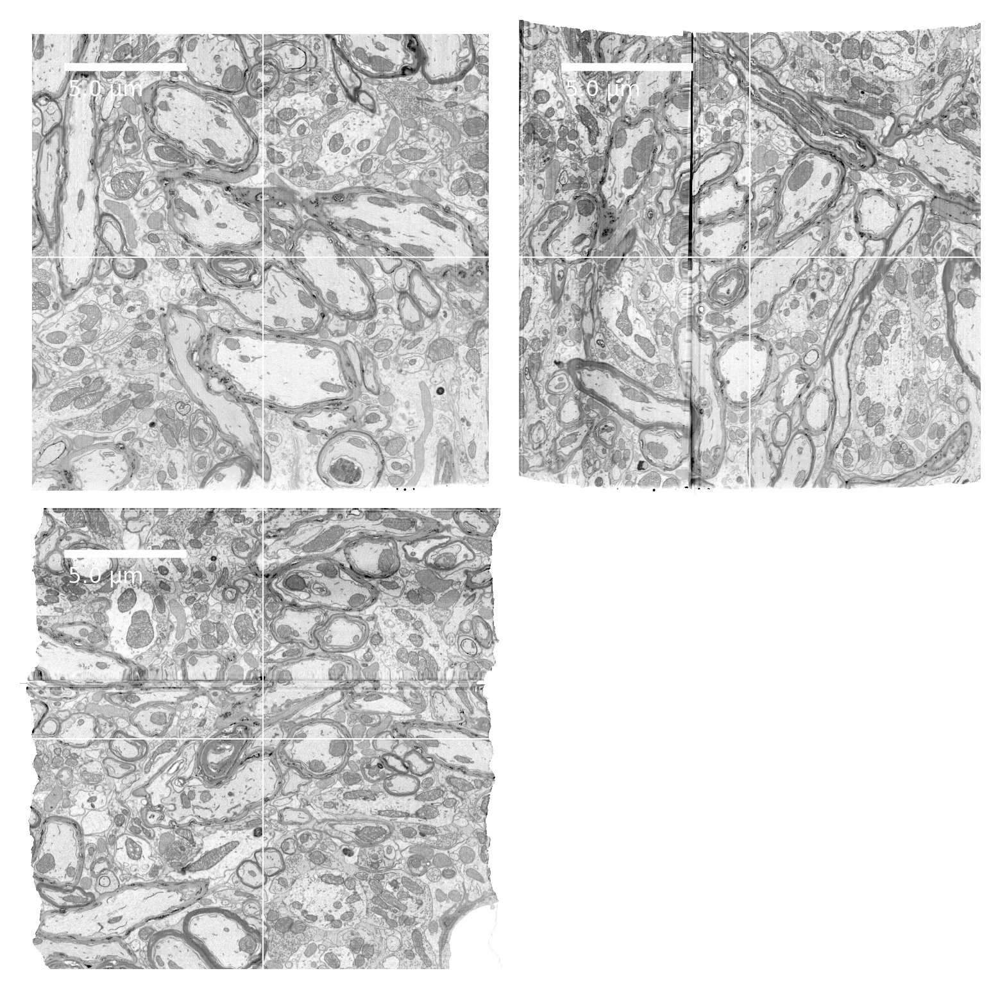

In [37]:
images, axs = plot_cross_sections_mrc_stack(binned_mrc,
                                            bar_width = 3,
                                            bar_length_um = 5,
                                            label_offset = 30,
                                            label_font_size = 8.0,
                                            EM_max = 950, 
                                            dpi=300)

Step 7: Transform and Save the FIB-SEM data
DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Transforming and Saving Intermediate Registered Frames


Setting up parameter sets:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  12:48:34   Transform and Save Chunks of Frames: Starting DASK jobs


C:\Users\labadmin\anaconda3\lib\site-packages\distributed\client.py:3362: UserWarning: Sending large graph of size 196.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


2025/08/06  13:05:57   Finished DASK jobs
Analyzing Registration Quality
2025/08/06  13:06:00   Analyzing Frame Registration: Starting DASK jobs
2025/08/06  13:38:30   Finished DASK jobs
2025/08/06  13:38:45   Saving the Registration Quality Statistics into the file:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_raw_RegistrationQuality.xlsx
Registered data set is NOT saved into a file


Removing Intermediate Registered Frame Files:   0%|          | 0/5058 [00:00<?, ?it/s]

CPU times: total: 24min 33s
Wall time: 54min 10s


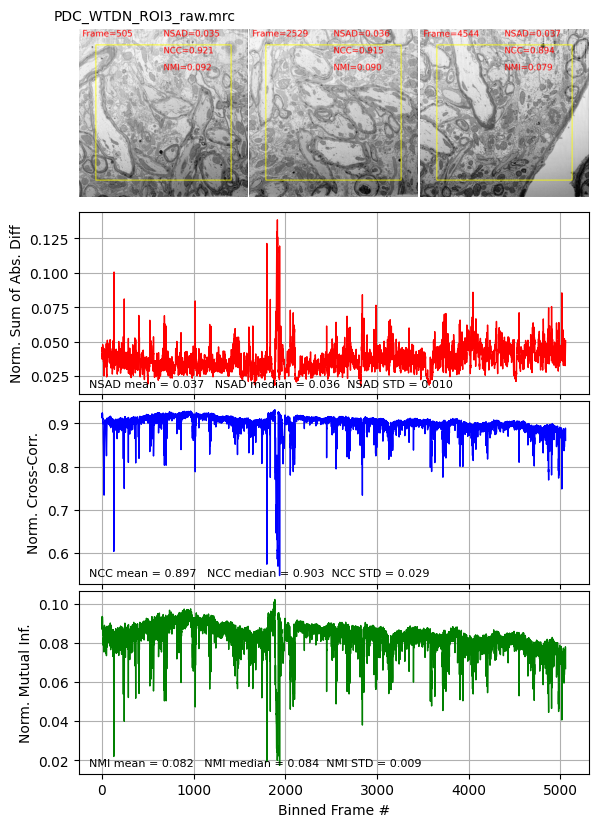

In [38]:
%%time

print('Step 7: Transform and Save the FIB-SEM data')

test_dataset.fnm_reg = 'PDC_WTDN_ROI3_raw.mrc'

evaluation_box = [500, 4000, 500, 4000]

reg_summary_raw, reg_summary_RegAffine_raw_xlsx = test_dataset.transform_and_save(DASK_client=client,
                                                        save_transformed_dataset = False,
                                                        save_registration_summary = True,
                                                        perform_transformation=False,
                                                        flatten_image = False,
                                                        ImgB_fraction=0.00,
                                                        add_offset = True,
                                                        zbin_factor = 1,
                                                        evaluation_box = evaluation_box,
                                                        sliding_evaluation_box = False,
                                                        fnm_types = ['mrc'])

generate_report_from_xls_registration_summary(reg_summary_RegAffine_raw_xlsx, sample_frames_layout = 'horizontal')

In [39]:
reg_summary_RegAffine_raw_xlsx = 'Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_raw_RegistrationQuality.xlsx'
reg_summary_RegAffine_ImB0p00_xlsx = 'Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00_RegistrationQuality.xlsx'
reg_summary_RegAffine_ImB0p00_flattened_xlsx = 'Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.00_flattened_RegistrationQuality.xlsx'
reg_summary_RegAffine_ImB0p08_flattened_rescaled_xlsx = 'Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_RegistrationQuality.xlsx'

generating the registration quality summary plots:   0%|          | 0/4 [00:00<?, ?it/s]

saving the data into xlsx file:   0%|          | 0/4 [00:00<?, ?it/s]

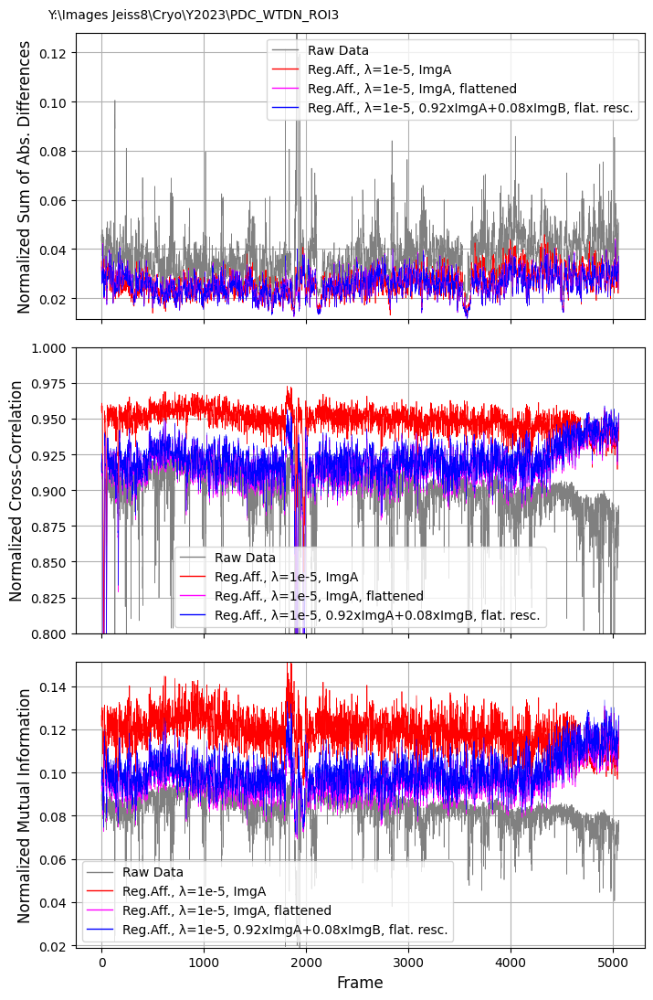

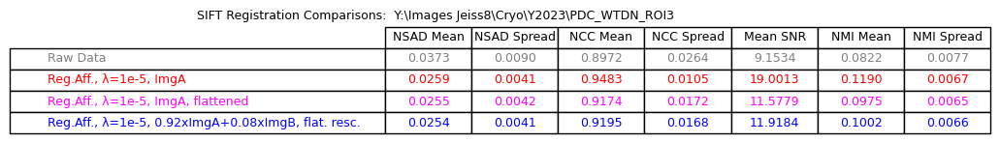

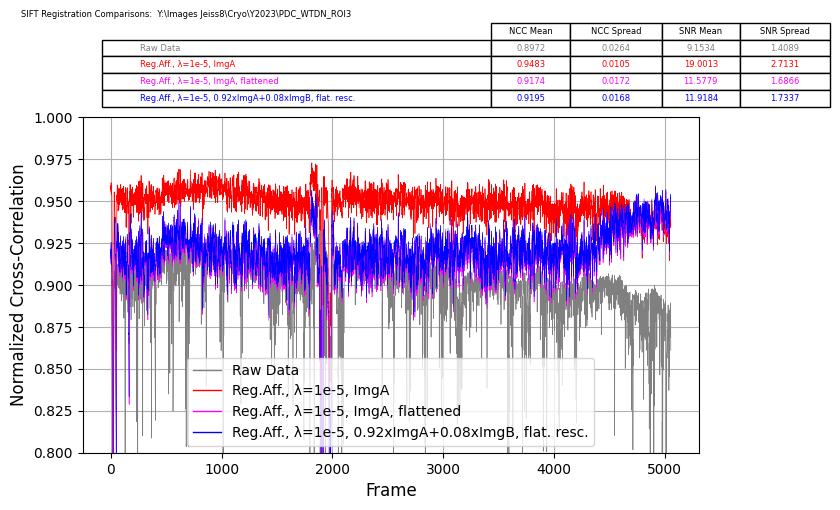

In [40]:
reg_qual_fls = [reg_summary_RegAffine_raw_xlsx,
                reg_summary_RegAffine_ImB0p00_xlsx,
                reg_summary_RegAffine_ImB0p00_flattened_xlsx,
                reg_summary_RegAffine_ImB0p08_flattened_rescaled_xlsx]
pfs = ['Raw Data',
       'Reg.Aff., λ=1e-5, ImgA',
       'Reg.Aff., λ=1e-5, ImgA, flattened',
       'Reg.Aff., λ=1e-5, 0.92xImgA+0.08xImgB, flat. resc.']

colors = ['grey', 'red', 'magenta', 'blue']
linewidths = [0.5, 0.5, 0.4, 0.3, 0.2]

save_filename = os.path.join(data_dir, 'Regstration_Summary_PDC_WTDN_ROI3.png')
plot_registrtion_quality_xlsx(reg_qual_fls, pfs, save_filename=save_filename,
                              linewidths = linewidths,
                              colors = colors,
                              ncc_bounds = [0.8, 1.0])
                              #nsad_bounds=[0.00, 0.15],
                              #nmi_bounds=[0.05, 0.20])

# add a plot of FiJi on top to make it more visible.
overplot = False
if overplot:
    ax = plt.gca()
    for j, fl in enumerate(reg_qual_fls[0:2]):
        rdata = data = pd.read_excel(fl, sheet_name='Registration Quality Statistics')
        image_ncc = np.array(rdata['Image NCC'])
        ax.plot(image_ncc, color=colors[j], linewidth=linewidths[j])
    fig = plt.gcf()
    fig.savefig(os.path.join(data_dir, 'Regstration_Summary_PDC_WTDN_ROI3_fig_and_table.png'), dpi=300) 

# Estimate X-Y Resolution

## Create Test Frame

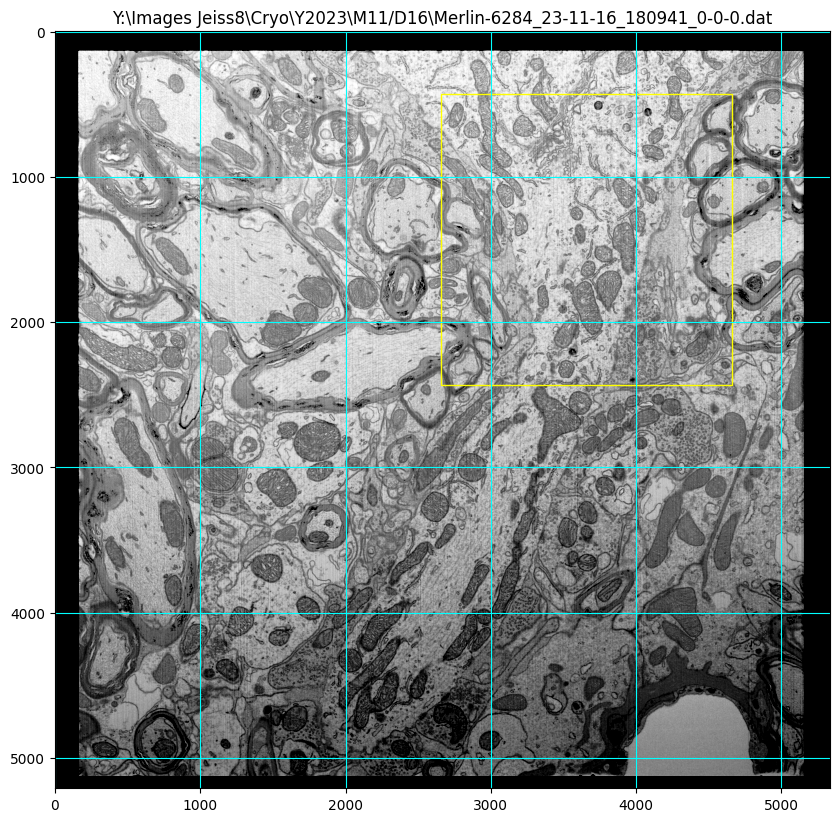

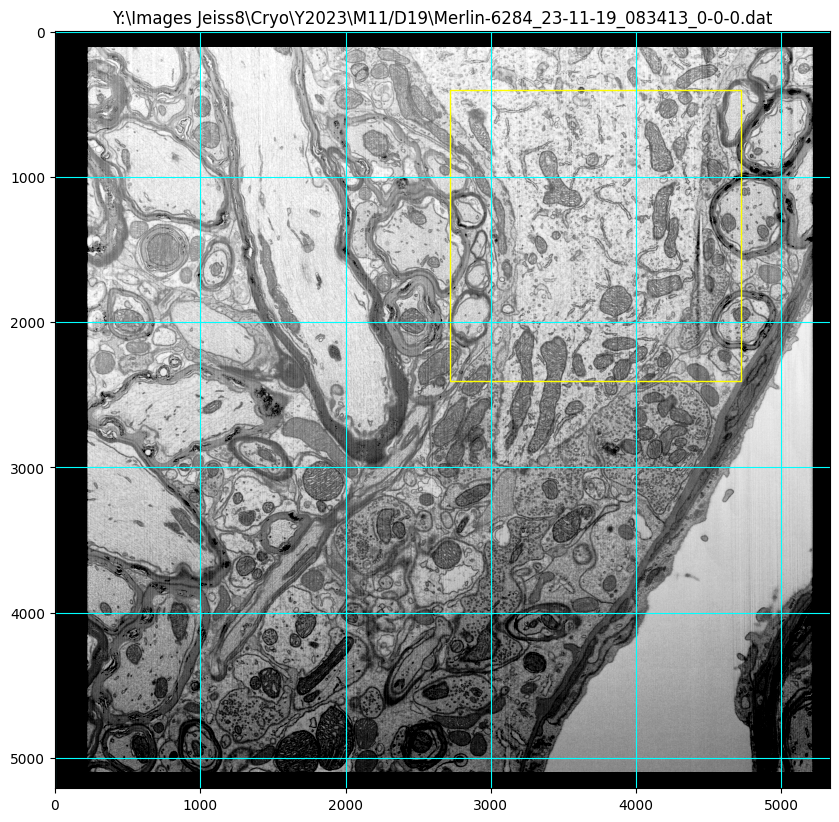

In [48]:
inds = np.arange(4100, 4500, 1)

evaluation_box = [300, 2000, 2500, 2000]

test_dataset.show_eval_box(invert_data=False,
                           frame_inds = [inds[0], inds[-1]],
                           evaluation_box=evaluation_box)

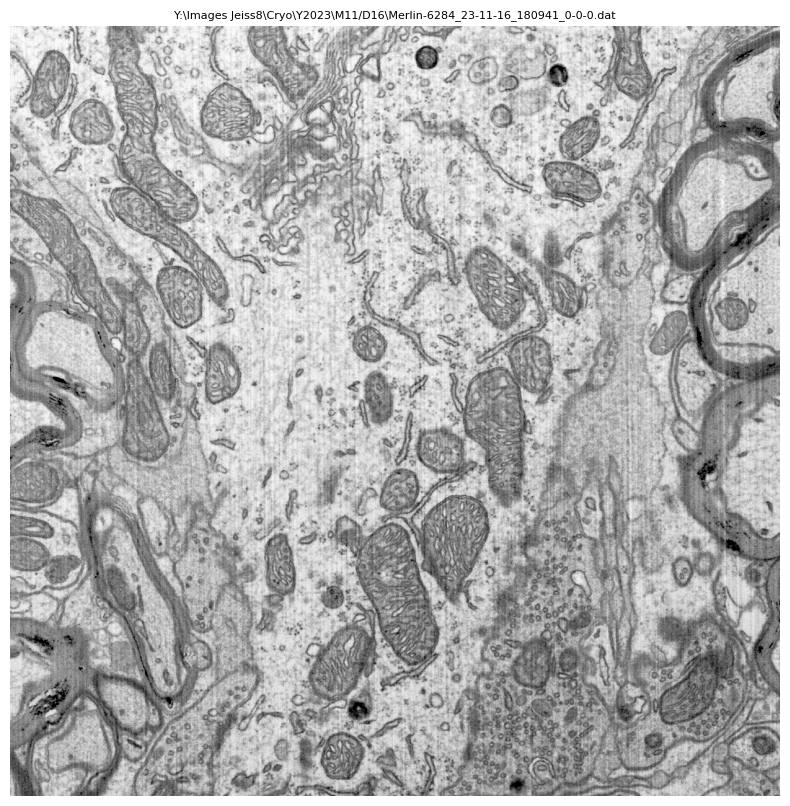

In [49]:
xi = evaluation_box[2]
xa = xi + evaluation_box[3]
yi = evaluation_box[0]
ya = yi + evaluation_box[1]
test_image = FIBSEM_frame(fls[inds[0]], calculate_scaled_images=True).ImageA[yi:ya, xi:xa]
fig, ax = plt.subplots(1,1, figsize=(10,10))
vmin, vmax = get_min_max_thresholds(test_image, disp_res=False)
ax.imshow(test_image, cmap='Greys', vmin=vmin, vmax=vmax)
ax.axis(False)
ax.set_title(fls[inds[0]], fontsize = 8)
fig.savefig(fls[inds[0]].replace('.dat', '_subset.png'), dpi=300)
tiff.imwrite(fls[inds[0]].replace('.dat', '_subset.tiff'), test_image)

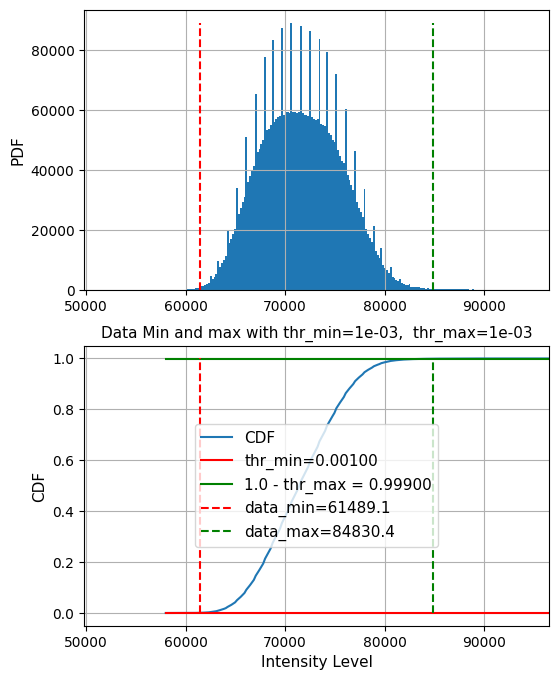

In [50]:
vmin, vmax = get_min_max_thresholds(test_image, disp_res=True)

## Select/Test Parameters for Blob selection

Detected total blobs: 19242
Detected good blobs: 18
CPU times: total: 58.7 s
Wall time: 52.4 s


Text(0.5, 0.62, 'STD (nm):       1.760')

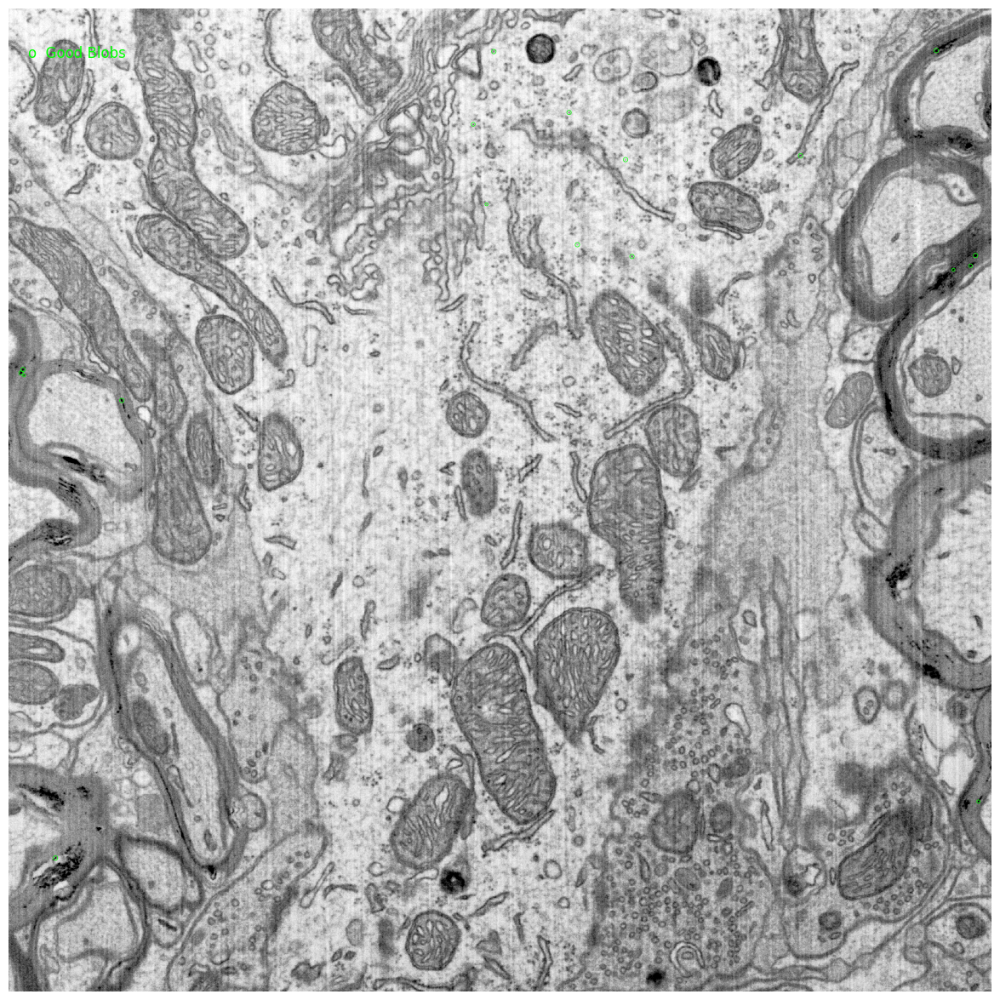

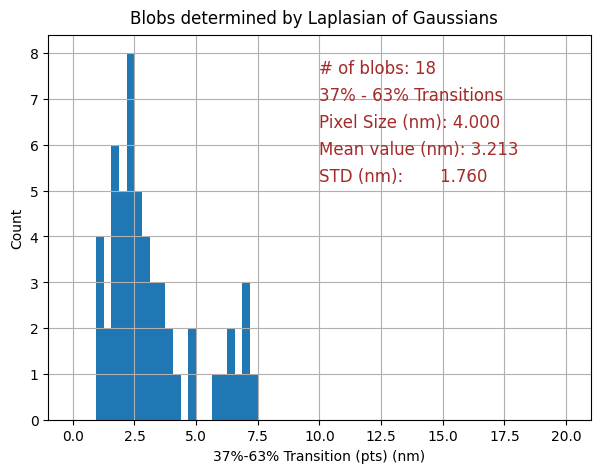

In [51]:
%%time

min_sigma = 1.0          # sigma (in pixel units) for Gaussian kernel in LoG search
max_sigma = 1.5          # sigma (in pixel units) for Gaussian kernel in LoG search
threshold = 2000        # threshold for LoG search. The absolute lower bound for scale space maxima. Local maxima smaller
                         # than threshold are ignored. Reduce this to detect blobs with less intensities
overlap = 0.1            # A value between 0 and 1. If the area of two blobs overlaps by a fraction greater than 'overlap', the smaller blob is eliminated.
pixel_size = 4.0         #  pixel size in nm
subset_size = 16         #  subset size (pixels) for blob / transition analysis
bounds = [0.37, 0.63]    #  List of of transition limits
bands = [5, 5, 5]        # list of three ints for the averaging bands for determining the left min, peak, and right min of the cross-section profile.
min_thr = 0.4            # threshold for identifying a 'good' transition (bottom < min_thr* top)

transition_high_limit = 10.0
transition_low_limit = 1.0

res = select_blobs_LoG_analyze_transitions(test_image, min_sigma = min_sigma,
                                              max_sigma = max_sigma,
                                              threshold = threshold,
                                              overlap = overlap,
                                              pixel_size = pixel_size,
                                              subset_size = subset_size,
                                              bounds = bounds,
                                              bands = bands,
                                              min_thr = min_thr,
                                               transition_low_limit = transition_low_limit,
                                               transition_high_limit = transition_high_limit,
                                              verbose = False,
                                              disp_res = True,
                                               disp_all_blobs = False,
                                              save_data_xlsx = False)

err_flags = np.array(res[2])
tr_results = np.array(res[3])
tr_res = np.array(tr_results[(err_flags<1)])[:,0:4]
tr_res_flat = tr_res.ravel()
tr_res_flat = tr_res_flat[(tr_res_flat<transition_high_limit)*(tr_res_flat>transition_low_limit)]

print('Detected total blobs:', len(err_flags))
print('Detected good blobs:', len(tr_res))
fig, ax = plt.subplots(1,1, figsize=(7,5))
hst = ax.hist(tr_res.ravel(), range = (0, 20), bins=64)
xaxis_label = '{:.0f}%-{:.0f}% Transition (pts) (nm)'.format(bounds[0]*100, bounds[1]*100)
ax.set_xlabel(xaxis_label)
ax.set_ylabel('Count')
ax.grid(True)

text_fs=12
text_col = 'brown'
ax.text(0.15, 1.03, 'Blobs determined by Laplasian of Gaussians', transform=ax.transAxes, fontsize=text_fs)
ax.text(0.50, 0.90, '# of blobs: {:d}'.format(len(tr_res)), transform=ax.transAxes, color=text_col, fontsize=text_fs)
ax.text(0.50, 0.83, '{:.0f}% - {:.0f}% Transitions'.format(bounds[0]*100, bounds[1]*100), transform=ax.transAxes, color=text_col, fontsize=text_fs)
ax.text(0.50, 0.76, 'Pixel Size (nm): {:.3f}'.format(pixel_size), transform=ax.transAxes, color=text_col, fontsize=text_fs)
ax.text(0.50, 0.69, 'Mean value (nm): {:.3f}'.format(np.mean(tr_res_flat)), transform=ax.transAxes, color=text_col, fontsize=text_fs)
ax.text(0.50, 0.62, 'STD (nm):       {:.3f}'.format(np.std(tr_res_flat)), transform=ax.transAxes, color=text_col, fontsize=text_fs)

## Run Resolution Analysis

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
2025/08/06  16:19:56   Using DASK distributed
2025/08/06  16:32:43   Finished computations, generating reports


Generating images/plots for the sample 2D blobs:   0%|          | 0/6 [00:00<?, ?it/s]

CPU times: total: 17min 56s
Wall time: 22min 38s


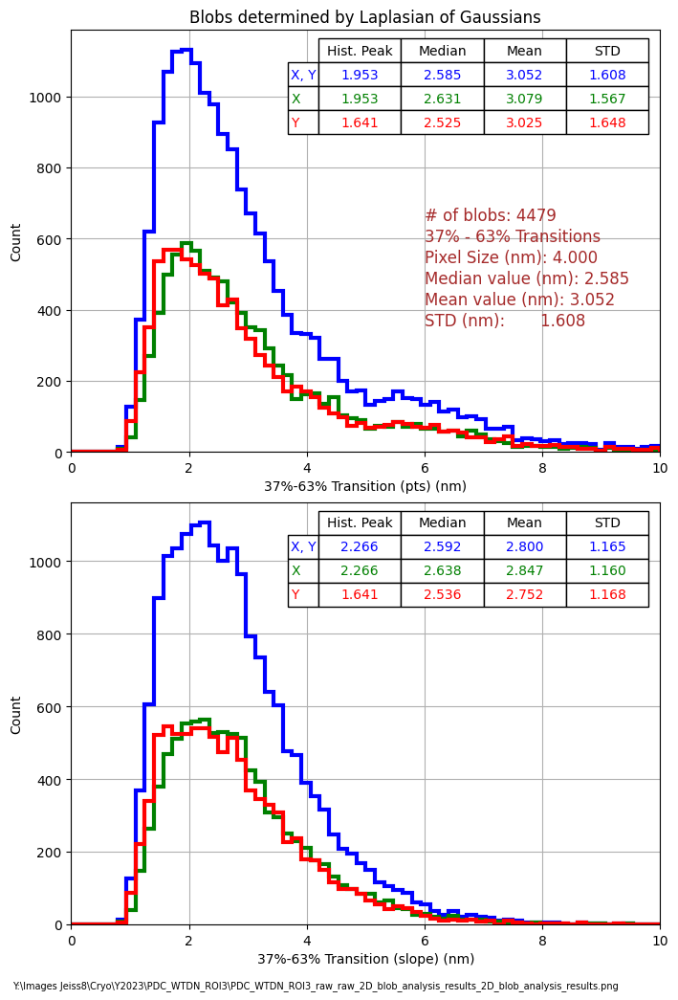

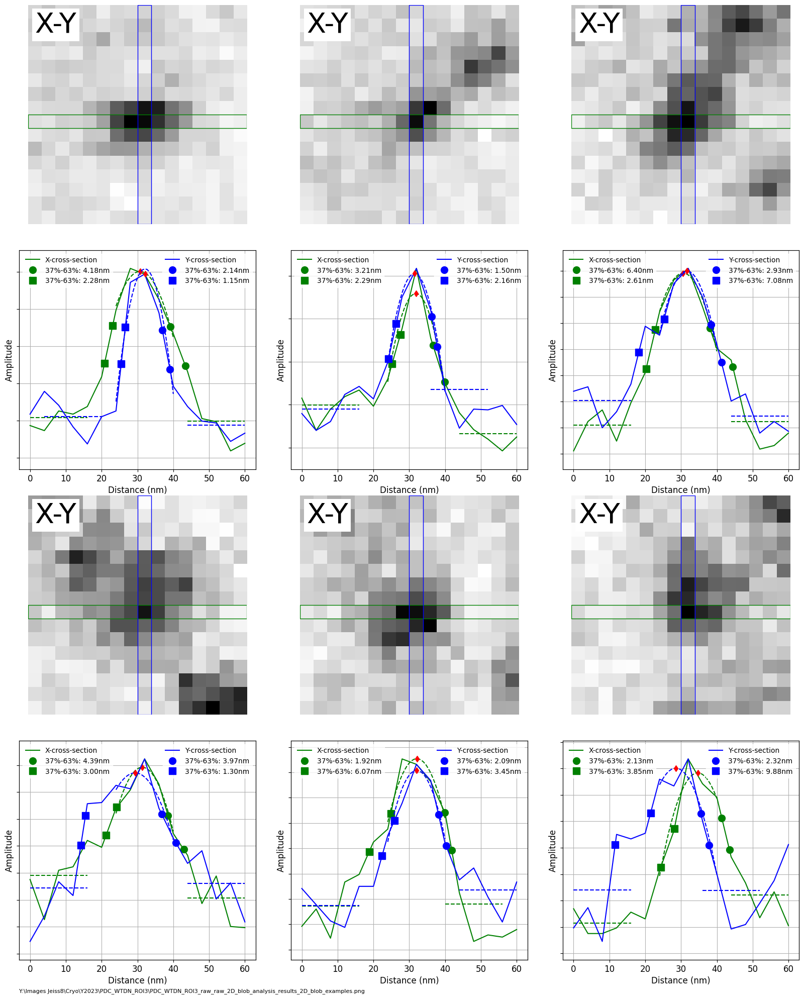

In [54]:
%%time

min_sigma = 1.0          # sigma (in pixel units) for Gaussian kernel in LoG search
max_sigma = 1.5          # sigma (in pixel units) for Gaussian kernel in LoG search
threshold = 3200        # threshold for LoG search. The absolute lower bound for scale space maxima. Local maxima smaller
                         # than threshold are ignored. Reduce this to detect blobs with less intensities
overlap = 0.1            # A value between 0 and 1. If the area of two blobs overlaps by a fraction greater than 'overlap', the smaller blob is eliminated.
pixel_size = 4.0         #  pixel size in nm
subset_size = 16         #  subset size (pixels) for blob / transition analysis
bounds = [0.37, 0.63]    #  List of of transition limits
bands = [5, 5, 5]        # list of three ints for the averaging bands for determining the left min, peak, and right min of the cross-section profile.
min_thr = 0.40            # threshold for identifying a 'good' transition (bottom < min_thr* top)

perform_transformation = False

if perform_transformation:
    results_file_xlsx = os.path.join(data_dir, os.path.splitext(test_dataset.fnm_reg)[0]+'_transformed_2D_blob_analysis_results.xlsx')
else:
    results_file_xlsx = os.path.join(data_dir, os.path.splitext(test_dataset.fnm_reg)[0]+'_raw_2D_blob_analysis_results.xlsx')

results = test_dataset.estimate_resolution_blobs_2D(DASK_client=client,
                                            image_name='ImageA',
                                            frame_inds = inds,
                                            evaluation_box=evaluation_box,
                                            min_sigma = min_sigma,
                                            max_sigma = max_sigma,
                                            threshold = threshold,
                                            overlap = overlap,
                                            pixel_size = pixel_size,
                                            subset_size = subset_size,
                                            bounds = bounds,
                                            bands = bands,
                                            min_thr = min_thr,
                                            title = fls[inds[0]],
                                            verbose = False,
                                            disp_res = False,
                                            perform_transformation = perform_transformation,
                                            save_data_xlsx =True,
                                            results_file_xlsx = results_file_xlsx)

print(time.strftime('%Y/%m/%d  %H:%M:%S')+'   Finished computations, generating reports')

results_file_xlsx, frame_inds, error_flags, blobs_LoG, tr_results = results
save_fname1 = results_file_xlsx.replace('.xlsx', '_2D_blob_analysis_results.png')
plot_2D_blob_results(results_file_xlsx, save_png=True, save_fname=save_fname1)
save_fname2 = results_file_xlsx.replace('.xlsx', '_2D_blob_examples.png')
plot_2D_blob_examples(results_file_xlsx, save_png=True, save_fname=save_fname2)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
2025/08/06  16:43:36   Using DASK distributed
2025/08/06  16:54:22   Finished computations, generating reports


Generating images/plots for the sample 2D blobs:   0%|          | 0/6 [00:00<?, ?it/s]

CPU times: total: 11min 55s
Wall time: 17min 39s


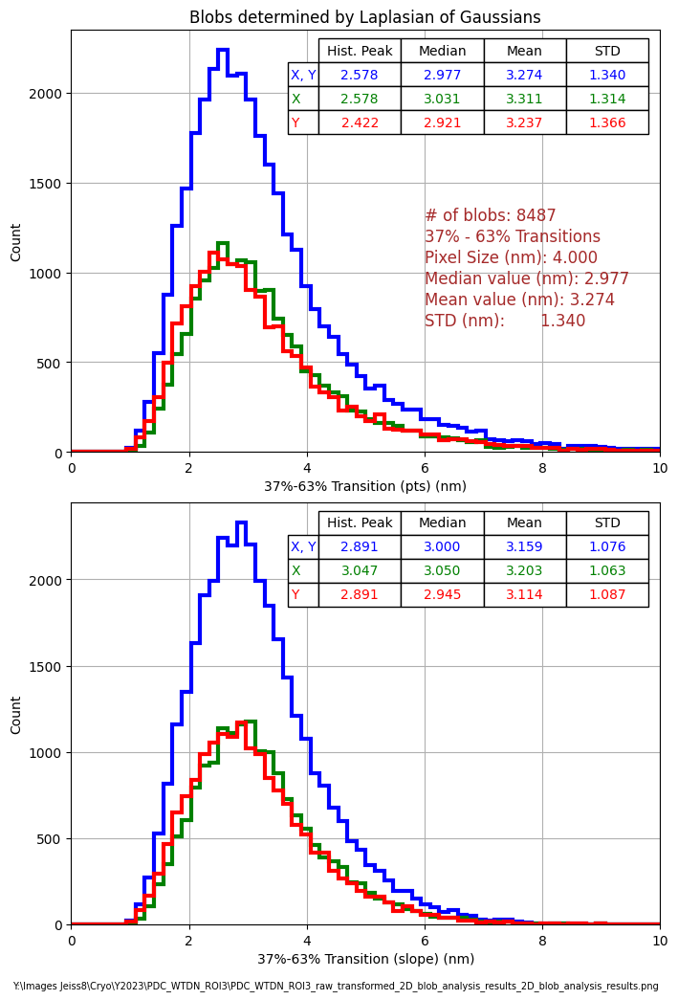

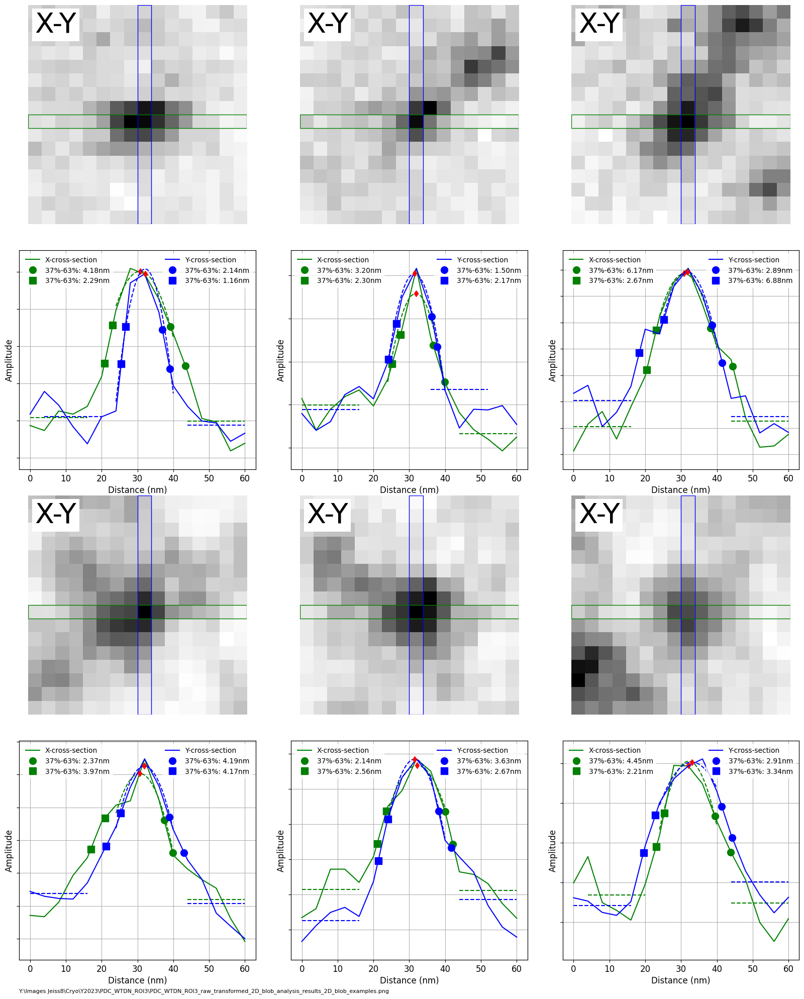

In [55]:
%%time

min_sigma = 1.0          # sigma (in pixel units) for Gaussian kernel in LoG search
max_sigma = 1.5          # sigma (in pixel units) for Gaussian kernel in LoG search
#threshold = 6000        # threshold for LoG search. The absolute lower bound for scale space maxima. Local maxima smaller
                         # than threshold are ignored. Reduce this to detect blobs with less intensities
overlap = 0.1            # A value between 0 and 1. If the area of two blobs overlaps by a fraction greater than 'overlap', the smaller blob is eliminated.
pixel_size = 4.0         #  pixel size in nm
subset_size = 16         #  subset size (pixels) for blob / transition analysis
bounds = [0.37, 0.63]    #  List of of transition limits
bands = [5, 5, 5]        # list of three ints for the averaging bands for determining the left min, peak, and right min of the cross-section profile.
min_thr = 0.4            # threshold for identifying a 'good' transition (bottom < min_thr* top)

perform_transformation = True

if perform_transformation:
    results_file_xlsx =os.path.join(data_dir, os.path.splitext(test_dataset.fnm_reg)[0]+'_transformed_2D_blob_analysis_results.xlsx')
else:
    results_file_xlsx =os.path.join(data_dir, os.path.splitext(test_dataset.fnm_reg)[0]+'_raw_2D_blob_analysis_results.xlsx')

results = test_dataset.estimate_resolution_blobs_2D(DASK_client=client,
                                            image_name='ImageA',
                                            frame_inds = inds,
                                            evaluation_box=evaluation_box,
                                            min_sigma = min_sigma,
                                            max_sigma = max_sigma,
                                            threshold = threshold,
                                            overlap = overlap,
                                            pixel_size = pixel_size,
                                            subset_size = subset_size,
                                            bounds = bounds,
                                            bands = bands,
                                            min_thr = min_thr,
                                            title = fls[inds[0]],
                                            verbose = False,
                                            disp_res = False,
                                            perform_transformation = perform_transformation,
                                            save_data_xlsx =True,
                                            results_file_xlsx = results_file_xlsx)

print(time.strftime('%Y/%m/%d  %H:%M:%S')+'   Finished computations, generating reports')

results_file_xlsx, frame_inds, error_flags, blobs_LoG, tr_results = results
save_fname1 = results_file_xlsx.replace('.xlsx', '_2D_blob_analysis_results.png')
plot_2D_blob_results(results_file_xlsx, save_png=True, save_fname=save_fname1)
save_fname2 = results_file_xlsx.replace('.xlsx', '_2D_blob_examples.png')
plot_2D_blob_examples(results_file_xlsx, save_png=True, save_fname=save_fname2)


# Destreak the Data

## Check the data range 

array([  0.      , 946.046875])

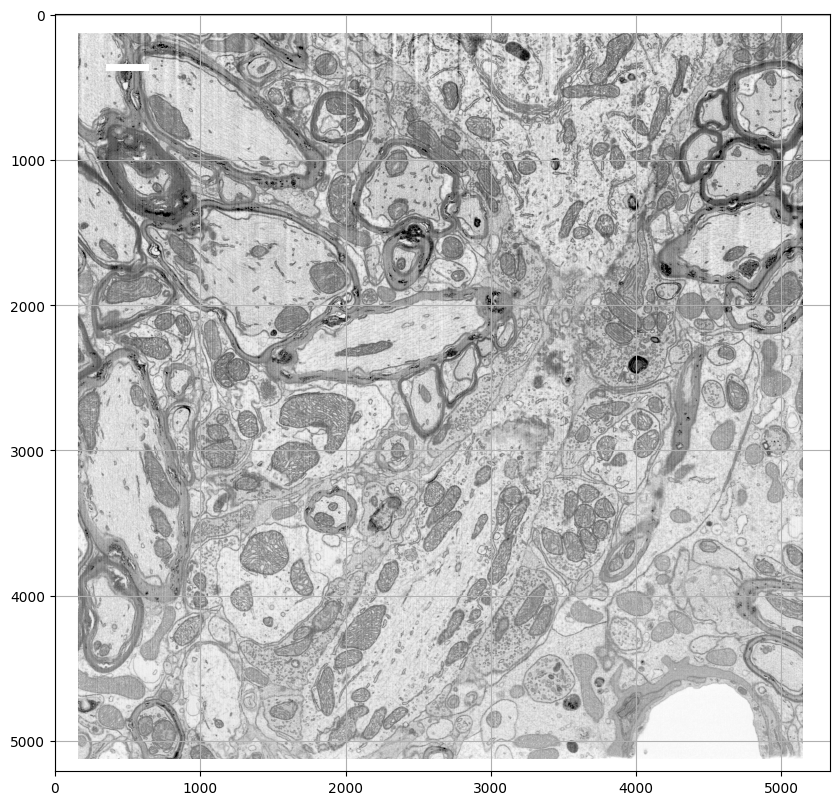

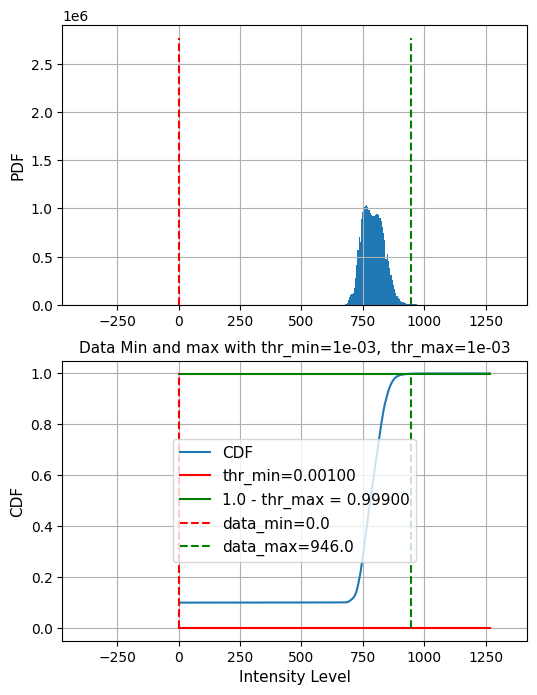

In [56]:
orig_mrc = os.path.normpath('Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled.mrc')

mrc_obj = mrcfile.mmap(orig_mrc, mode='r', permissive=True)
header = mrc_obj.header
'''
    mode 0 -> uint8
    mode 1 -> int16
    mode 2 -> float32
    mode 4 -> complex64
    mode 6 -> uint16
'''
mrc_mode = mrc_obj.header.mode
test_frame_ind = 4000
test_frame = mrc_obj.data[test_frame_ind, :, :]
mrc_obj.close()

vmin, vmax = get_min_max_thresholds(test_frame[200: -200, 200: -200], disp_res=False)
fig, ax = plt.subplots(1,1, figsize=(10, 10))
ax.imshow(test_frame, cmap='Greys', vmin=vmin, vmax=vmax)
ax.grid(True)
#ax.axis(False)
#ax.axis(False)
add_scale_bar(ax, pixel=0.004, bar_length=5.0, bar_width=5, bar_label='')

get_min_max_thresholds(test_frame)

## Build Destreaking Kernel 

C:\Users\labadmin\AppData\Local\Temp\ipykernel_24544\1057206550.py:119: RuntimeWarning: divide by zero encountered in log
  data_FT_abs_zr = np.nan_to_num(np.log(np.abs(img_fft) * destreak_kernel))


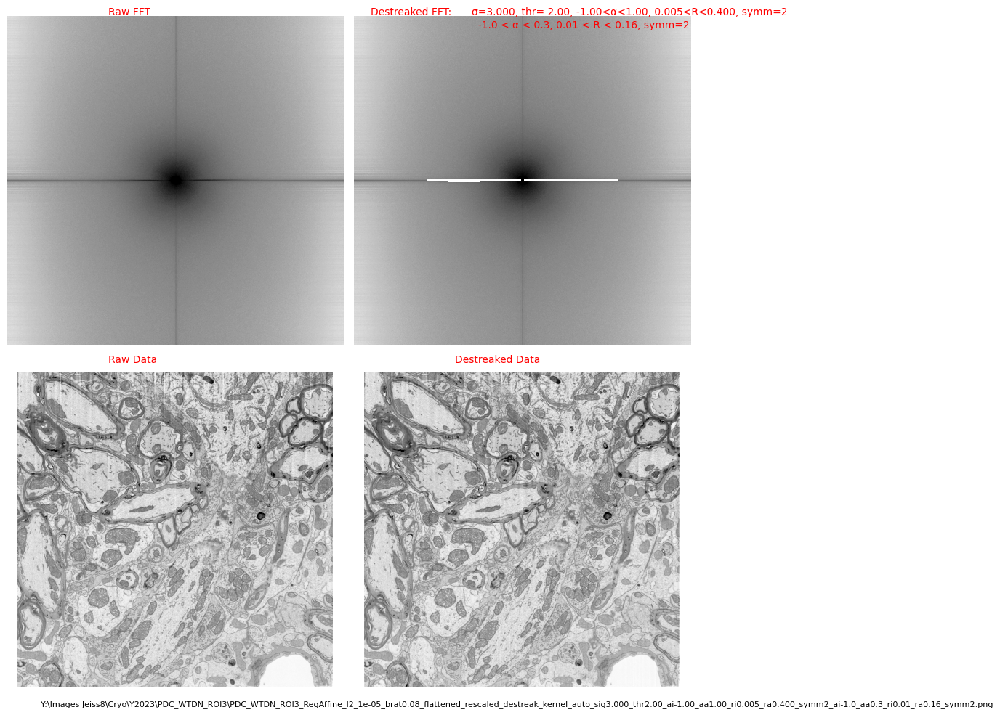

In [61]:
# define the destreak_kernel and estimate the performance
data_min = 500
data_max = 12000

destreak_kernel_auto = True
destreak_kernel_XY = False
destreak_kernel_R = True

if destreak_kernel_auto:   # destreaking isperformed by zeroing FFT data inside two symmetric bands along X-axis in FFT space
    thr_reference = 2.0
    smooth_sigma = 3.0
    astart_reference = 2.0
    astop_reference = 88.0
    astart_limit = -1.0
    astop_limit = 1.0
    rstart_limit = 0.005
    rstop_limit = 0.40
    symm_reference = 4  
    symm_limit = 2
    rescale = False

if destreak_kernel_XY:   # destreaking isperformed by zeroing FFT data inside two symmetric bands along X-axis in FFT space
    xstart = 0.22
    xstop = 0.5
    dy = 0.008
    y_offset = 0.0035
    
if destreak_kernel_R:                    # destreaking isperformed by zeroing FFT data inside angular segments FFT space (also limited in radial FFT coordinate)
    astart = -1.0
    astop = 0.3
    rstart = 0.010
    rstop = 0.16
    symmetry = 2

clip_mask = (test_frame>data_min)*(test_frame<data_max)
ny, nx = np.shape(clip_mask)
try:
    yi = np.min(np.where(clip_mask[:, nx//2]))
except:
    yi = 0
try:
    ya = ny-np.max(np.where(clip_mask[:, nx//2]))
except:
    ya = 1
try:
    xi = np.min(np.where(clip_mask[ny//2, :]))
except:
    xi = 0
try:
    xa = nx-np.max(np.where(clip_mask[ny//2, :]))
except:
    xa = 1

clip_mask[yi:-ya, xi:-xa] = True # make sure clip_mask is filled with ones (True)
#pad_width = np.max((xi, xa, yi, ya))
#padded_fr = clip_mask*test_frame + (1-clip_mask)*np.pad(test_frame[pad_width:-pad_width, pad_width:-pad_width], pad_width = pad_width, mode='symmetric')
padded_fr = clip_mask*test_frame + (1-clip_mask)*np.pad(test_frame[yi:-ya, xi:-xa], pad_width = np.array([[yi, ya], [xi, xa]]), mode='symmetric')
ds = padded_fr.shape
destreak_kernel = np.ones(ds, dtype=float)

img_fft = np.fft.fftshift(np.fft.fftn(np.fft.ifftshift(padded_fr)))

lim_strs1 = []
lim_str2 = '.png'

if destreak_kernel_auto:
    destreak_kernel_auto_kernel = build_kernel_FFT_destreaker_autodetect(img_fft,
                                                                         thr_reference = thr_reference,
                                                                         smooth_sigma = smooth_sigma,
                                                                         astart_reference = astart_reference,
                                                                         astop_reference = astop_reference,
                                                                         astart_limit = astart_limit,
                                                                         astop_limit = astop_limit,
                                                                         rstart_limit = rstart_limit,
                                                                         rstop_limit = rstop_limit,
                                                                         symm_reference = symm_reference,
                                                                         symm_limit = symm_limit,
                                                                         rescale = rescale)
    if rescale:
        str_app = 'σ={:.3f}, thr= {:.2f}, {:.2f}<α<{:.2f}, {:.3f}<R<{:.3f}, symm={:d}, resc'.format(smooth_sigma, thr_reference, astart_limit, astop_limit, rstart_limit, rstop_limit, symm_limit)
        repl_str = '_auto_sig{:.3f}_thr{:.2f}_ai{:.2f}_aa{:.2f}_ri{:.3f}_ra{:.3f}_symm{:d}_resc.png'.format(smooth_sigma, thr_reference, astart_limit, astop_limit, rstart_limit, rstop_limit, symm_limit)                 
    else:
        str_app = 'σ={:.3f}, thr= {:.2f}, {:.2f}<α<{:.2f}, {:.3f}<R<{:.3f}, symm={:d}'.format(smooth_sigma, thr_reference, astart_limit, astop_limit, rstart_limit, rstop_limit, symm_limit)
        repl_str = '_auto_sig{:.3f}_thr{:.2f}_ai{:.2f}_aa{:.2f}_ri{:.3}_ra{:.3f}_symm{:d}.png'.format(smooth_sigma, thr_reference, astart_limit, astop_limit, rstart_limit, rstop_limit, symm_limit)                 
    lim_strs1.append(str_app)
    
    lim_str2 = lim_str2.replace('.png', repl_str)
    destreak_kernel = destreak_kernel_auto_kernel * destreak_kernel
    


if destreak_kernel_XY:
    destreak_kernel_XY_kernel = build_kernel_FFT_zero_destreaker_XY(img_fft,
                                                          xstart=xstart,
                                                          xstop=xstop,
                                                          dy = dy,
                                                        y_offset=y_offset)
    lim_strs1.append('{:.2f} < |X| < {:.2f}, |Y| < {:.3f}, Yoffs={:.3f}'.format(xstart, xstop, dy, y_offset))
    lim_str2 = lim_str2.replace('.png', '_xi{:.2f}_xa{:.2f}_dy{:.3f}_Yoffs{:.3f}.png'.format(xstart, xstop, dy, y_offset))
    destreak_kernel = destreak_kernel_XY_kernel * destreak_kernel

if destreak_kernel_R:
    destreak_kernel_R_kernel = build_kernel_FFT_zero_destreaker_radii_angles(img_fft,
                                       astart = astart,
                                       astop = astop,
                                       rstart=rstart,
                                       rstop=rstop,
                                       symm=symmetry)
    lim_strs1.append('  {:.1f} < α < {:.1f}, {:.2f} < R < {:.2f}, symm={:d}'.format(astart, astop, rstart, rstop, symmetry))
    lim_str2 = lim_str2.replace('.png', '_ai{:.1f}_aa{:.1f}_ri{:.2f}_ra{:.2f}_symm{:d}.png'.format(astart, astop, rstart, rstop, symmetry))
    destreak_kernel = destreak_kernel_R_kernel * destreak_kernel

st = 1.0/np.sqrt(2.0)
kernel = np.array([[st, 1.0, st],[1.0,1.0,1.0], [st, 1.0, st]]).astype(float)
smooth_kernel = kernel/kernel.sum()

data_FT_abs = np.log(np.abs(img_fft))
vmin_FFT, vmax_FFT = get_min_max_thresholds(data_FT_abs, disp_res=False)
data_FT_abs_zr = np.nan_to_num(np.log(np.abs(img_fft) * destreak_kernel))

destreaked_fft = np.fft.fftshift(np.fft.fftn(np.fft.ifftshift(padded_fr))) * destreak_kernel
destreaked_frame = np.real(np.fft.fftshift(np.fft.ifftn(np.fft.ifftshift(destreaked_fft)))).astype(float) * clip_mask

sx = 10
sy = sx * ny // nx + 1.5

fig, axs = plt.subplots(2,2, figsize=(sx, sy))
fig.subplots_adjust(left=0.03, bottom=0.07, right=0.97, top=0.97, wspace=0.03, hspace=0.03)

axs[0, 0].imshow(data_FT_abs, cmap='Greys', vmin=vmin_FFT, vmax=vmax_FFT)
axs[0, 0].text(0.3, 1.005, 'Raw FFT', color='red', transform=axs[0, 0].transAxes, fontsize=10)

axs[0, 1].imshow(data_FT_abs_zr, cmap='Greys', vmin=vmin_FFT, vmax=vmax_FFT)
axs[0, 1].text(0.05, 1.005, 'Destreaked FFT: ', color='red', transform=axs[0, 1].transAxes, fontsize=10)
for j, lim_str1 in enumerate(lim_strs1):
    axs[0, 1].text(0.35, 1.005-j*0.04, lim_str1, color='red', transform=axs[0, 1].transAxes, fontsize=10)

vmin_ds, vmax_ds = get_min_max_thresholds(destreaked_frame[200: -200, 200: -200], disp_res=False)
axs[1, 1].imshow(destreaked_frame, cmap='Greys', vmin=vmin_ds, vmax=vmax_ds)
axs[1, 1].text(0.3, 1.005, 'Destreaked Data', color='red', transform=axs[1, 1].transAxes, fontsize=10)

axs[1, 0].imshow(test_frame, cmap='Greys', vmin=vmin, vmax=vmax, zorder=10)
axs[1, 0].text(0.3, 1.005, 'Raw Data', color='red', transform=axs[1,0].transAxes, fontsize=10)

for ax in axs.ravel():
    ax.axis(False)

save_png_name = orig_mrc.replace('.mrc', '_destreak_kernel'+lim_str2)
axs[1, 1].text(0.1, -0.04, save_png_name, transform=axs[1, 0].transAxes, fontsize=8)
fig.savefig(save_png_name, dpi=600)

## Destreak and save the data 

In [62]:
%%time
destreaked_mrc = orig_mrc.replace('.mrc', '_destreaked.mrc')
saved_destreak_filename =  destreak_mrc_stack_with_kernel(orig_mrc,
                                                          destreak_kernel,
                                                          data_min, data_max,
                                                          DASK_client = client,
                                                          partial_destreaking =True,
                                                          flip_transitionY = True,
                                                          #fri=2500,
                                                          #fra=2525,
                                                          save_filename = destreaked_mrc)
print(time.strftime('%Y/%m/%d  %H:%M:%S')+'   Destreaked data saved into: ', saved_destreak_filename)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress


Creating params list:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  17:59:32   Using DASK distributed
2025/08/06  17:59:34   Starting DASK batch 1 with 5000 jobs, 58 jobs remaining
2025/08/06  21:20:35   Starting DASK batch 1 with 58 jobs


2025-08-06 21:36:07,692 - distributed.scheduler - WARNING - Worker failed to heartbeat for 781s; attempting restart: <WorkerState 'tcp://127.0.0.1:57497', name: 3, status: running, memory: 99, processing: 0>
2025-08-06 21:36:07,693 - distributed.scheduler - WARNING - Worker failed to heartbeat for 781s; attempting restart: <WorkerState 'tcp://127.0.0.1:57498', name: 1, status: running, memory: 100, processing: 0>
2025-08-06 21:36:07,695 - distributed.scheduler - WARNING - Worker failed to heartbeat for 781s; attempting restart: <WorkerState 'tcp://127.0.0.1:57499', name: 0, status: running, memory: 103, processing: 0>
2025-08-06 21:36:07,696 - distributed.scheduler - WARNING - Worker failed to heartbeat for 781s; attempting restart: <WorkerState 'tcp://127.0.0.1:57506', name: 2, status: running, memory: 100, processing: 0>
2025-08-06 21:36:07,753 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:57499' caused the cluster to lose already computed task(s), which will b

2025-08-06 21:36:07,757 - distributed.scheduler - ERROR - Removing worker 'tcp://127.0.0.1:57499' caused the cluster to lose scattered data, which can't be recovered: {'ndarray-ed110219ab888eba5dc271b2ead833d5'} (stimulus_id='handle-worker-cleanup-1754530567.7495744')
2025-08-06 21:36:07,778 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:57506' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-943af93972458913d8081396097d653d', 'select_blobs_LoG_analyze_transitions_2D_dataset-8d2d95458abdf70150f240b1c708fafe', 'select_blobs_LoG_analyze_transitions_2D_dataset-95900db341fe9e87c3d205fde9ab92ba', 'select_blobs_LoG_analyze_transitions_2D_dataset-bdc00858d99a7af607fb92bb3629a685', 'select_blobs_LoG_analyze_transitions_2D_dataset-65ae0ad4ed6990a47bd191cbc3030dfb', 'select_blobs_LoG_analyze_transitions_2D_dataset-2cff39e34ccea6e7ebef7e9d480052a8', 'select_blobs_LoG_analyze_transitions

2025-08-06 21:36:07,790 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:57497' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-9a040d5a508dfee25c2c685c174c0c84', 'select_blobs_LoG_analyze_transitions_2D_dataset-b4ae080b4b56c03f677556b4171e4e12', 'select_blobs_LoG_analyze_transitions_2D_dataset-11bdc5013e65876e19f80f525c0837f6', 'select_blobs_LoG_analyze_transitions_2D_dataset-dafaa1a4a29f683bd3b8a3adf2e24487', 'select_blobs_LoG_analyze_transitions_2D_dataset-148f3c0c572131b84a5d9e7c74bd9647', 'select_blobs_LoG_analyze_transitions_2D_dataset-7a7089f28216350753c0de52f0a946e1', 'select_blobs_LoG_analyze_transitions_2D_dataset-ddb6fd0f5b8861a6b159868486de66a6', 'select_blobs_LoG_analyze_transitions_2D_dataset-67f6e1841c2482fd912b5e7a7d0d29e9', 'select_blobs_LoG_analyze_transitions_2D_dataset-adf0ab71f7567645eee3617ee7f74f9c', 'select_blobs_LoG_analyze_transitions_2D_dataset-c8558

2025-08-06 21:36:07,799 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:57498' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-50baa00bda41d5cb864dbbce21016f80', 'select_blobs_LoG_analyze_transitions_2D_dataset-c076a15dfe54ec7eb27107577e74ce5e', 'select_blobs_LoG_analyze_transitions_2D_dataset-ab02e86c1b85958357186ca4e967c1a7', 'select_blobs_LoG_analyze_transitions_2D_dataset-0e85d465f8430d5b41bfab2ce94dda72', 'select_blobs_LoG_analyze_transitions_2D_dataset-65bcd134f6110f5357f563e4d9c02535', 'select_blobs_LoG_analyze_transitions_2D_dataset-9557205d6df00dd183505344d64b3c82', 'select_blobs_LoG_analyze_transitions_2D_dataset-c6c4628b4b962fa9b23ff21c4742cd39', 'select_blobs_LoG_analyze_transitions_2D_dataset-973be7ace1f123a6198a1c1dd48e2c3d', 'select_blobs_LoG_analyze_transitions_2D_dataset-61d3538fb9e65ad4ed9ccc4b9671570d', 'select_blobs_LoG_analyze_transitions_2D_dataset-23f1f

2025-08-06 21:36:09,741 - distributed.nanny - WARNING - Restarting worker
2025-08-06 21:36:09,745 - distributed.nanny - WARNING - Restarting worker
2025-08-06 21:36:10,043 - distributed.nanny - WARNING - Restarting worker
2025-08-06 21:36:10,047 - distributed.nanny - WARNING - Restarting worker


2025/08/06  21:37:44   Destreaked data saved into:  ['Y:\\Images Jeiss8\\Cryo\\Y2023\\PDC_WTDN_ROI3\\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked.mrc']
CPU times: total: 1h 54min 58s
Wall time: 4h 1min 38s


In [63]:
%%time
mrc_destreaked_binned = destreaked_mrc.replace('.mrc', '_binned_4x.mrc')
bin_crop_mrc_stack(destreaked_mrc,
                    DASK_client = client,
                    xbin_factor = 4,
                    ybin_factor = 4,
                    zbin_factor = 4,
                    #fnm_types = ['mrc', 'h5'],
                    binned_copped_filename = mrc_destreaked_binned)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Source mrc_mode: 1, source data type: <class 'numpy.int16'>
Source Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321
2025/08/06  21:37:44   Result mrc_mode: 1, source data type: <class 'numpy.int16'>


Building Parameters Sets:   0%|          | 0/1265 [00:00<?, ?it/s]

2025/08/06  21:37:44   New Data Set Shape:  1333 x 1302 x 1265
2025/08/06  21:38:28   Result Voxel Size (Angstroms): 159.997116 x 159.997116 x 147.305283
2025/08/06  21:38:28   Using DASK distributed
2025/08/06  21:38:28   Starting DASK batch 0 with 1265 jobs
CPU times: total: 4min 37s
Wall time: 14min 20s


['Y:\\Images Jeiss8\\Cryo\\Y2023\\PDC_WTDN_ROI3\\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked_binned_4x.mrc']

2025/08/06  21:52:04   EM cross-sections dimensions (um): [21.32761557 20.83162451 18.63411825]
Center coordinates (um): [10.66380779 10.41581226  9.31705912]


Loading EM Cross-sections Data:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  21:52:04   X-Y cross-section loaded, dimensions (pixels): 1333 1302
2025/08/06  21:52:04   X-Z cross-section loaded, dimensions (pixels): 1333 1265
2025/08/06  21:52:04   Y-Z cross-section loaded, dimensions (pixels): 1302 1265


Determining EM data range:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/06  21:53:01   Will use EM-data range: 705.1 - 950.0
Generating Cross-Section Images
2025/08/06  21:53:01   Generating X-Y cross-section
2025/08/06  21:53:01   Generating Y-Z cross-section
2025/08/06  21:53:30   Generating X-Z cross-section
2025/08/06  21:53:30   Saving image into:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked_binned_4x_crosssections.png
CPU times: total: 32.9 s
Wall time: 1min 28s


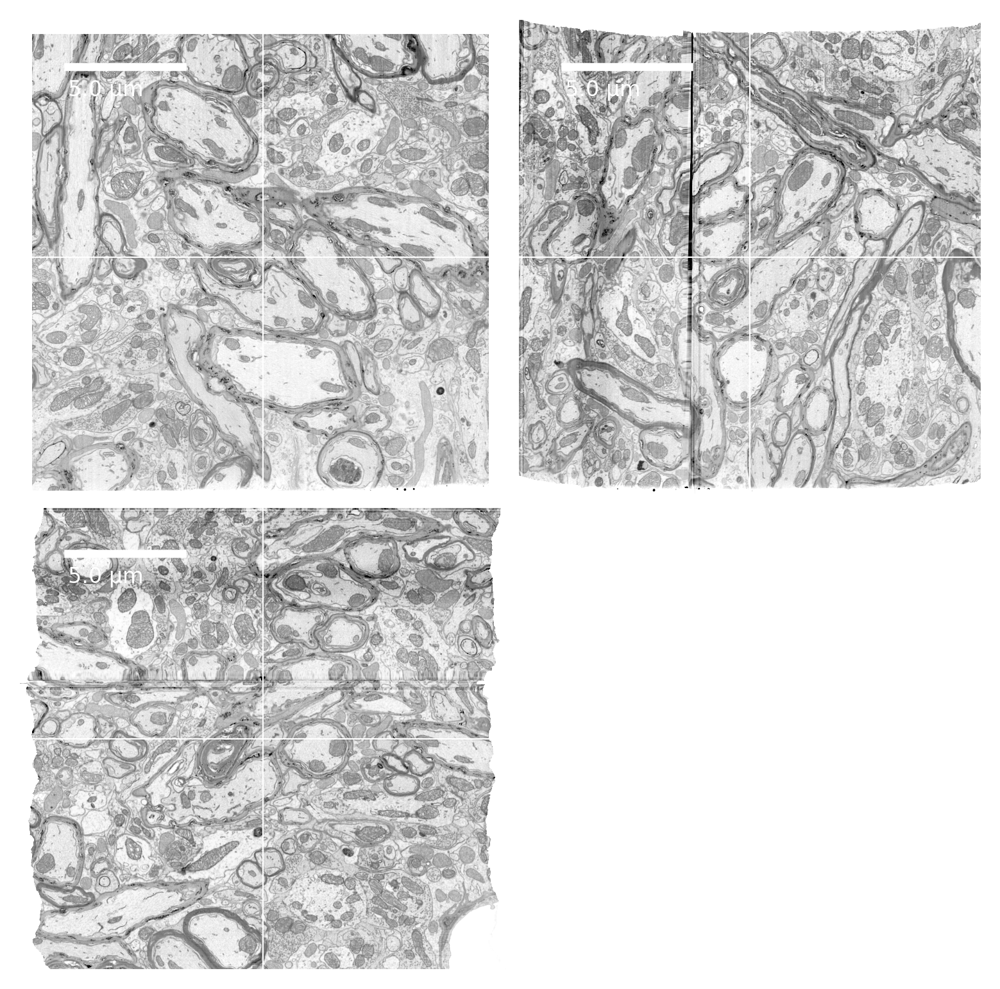

In [64]:
%%time
images, axs = plot_cross_sections_mrc_stack(mrc_destreaked_binned,
                                            bar_width = 3,
                                            bar_length_um = 5,
                                            label_offset = 30,
                                            label_font_size = 8.0,
                                            EM_max = 950, 
                                            dpi=300)

# Smooth the Data

## Check the data range

array([  0.        , 945.30078125])

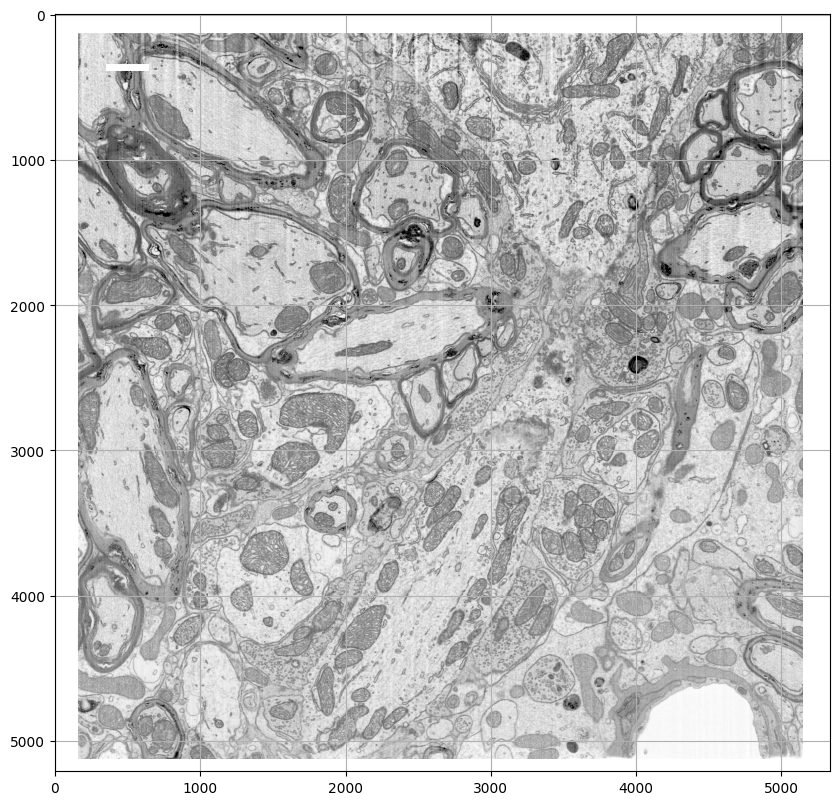

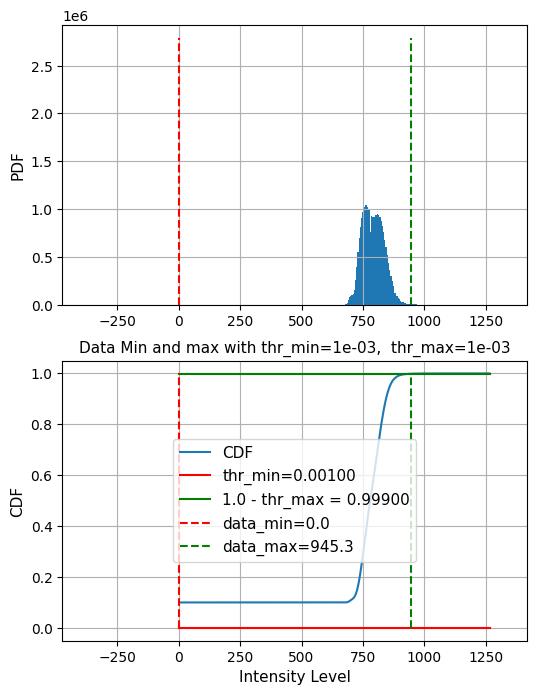

In [65]:
mrc_obj = mrcfile.mmap(destreaked_mrc, mode='r', permissive=True)
header = mrc_obj.header
'''
    mode 0 -> uint8
    mode 1 -> int16
    mode 2 -> float32
    mode 4 -> complex64
    mode 6 -> uint16
'''
mrc_mode = mrc_obj.header.mode
test_frame_ind = 4000
test_frame = mrc_obj.data[test_frame_ind, :, :]
mrc_obj.close()

vmin, vmax = get_min_max_thresholds(test_frame[200: -200, 200: -200], disp_res=False)
fig, ax = plt.subplots(1,1, figsize=(10, 10))
ax.imshow(test_frame, cmap='Greys', vmin=vmin, vmax=vmax)
ax.grid(True)
#ax.axis(False)
#ax.axis(False)
add_scale_bar(ax, pixel=0.004, bar_length=5.0, bar_width=5, bar_label='')

get_min_max_thresholds(test_frame)

## Smooth and save the data

In [66]:
%%time
st = 1.0/np.sqrt(2.0)
kernel = np.array([[st, 1.0, st],[1.0,1.0,1.0], [st, 1.0, st]]).astype(float)
smooth_kernel = kernel/kernel.sum()

smoothed_mrc = destreaked_mrc.replace('.mrc', '_smoothed.mrc')
data_min = 250
data_max = 1500
saved_smooth_filename =  smooth_mrc_stack_with_kernel(destreaked_mrc,
                                                           smooth_kernel,
                                                           data_min, data_max,
                                                           DASK_client = client,
                                                           save_filename = smoothed_mrc)
print(time.strftime('%Y/%m/%d  %H:%M:%S')+'   Smoothed data saved into: ', saved_smooth_filename)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Source mrc_mode: 1, source data type: <class 'numpy.int16'>
Source Data Shape:  5334 x 5209 x 5058
Source Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321
Result mrc_mode: 1, source data type: <class 'numpy.int16'>
New Data Shape:  5334 x 5209 x 5058
Result Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321


Creating params list:   0%|          | 0/5058 [00:00<?, ?it/s]

2025/08/06  22:17:22   Using DASK distributed
2025/08/06  22:17:23   Starting DASK batch 1 with 5000 jobs, 58 jobs remaining


2025-08-06 23:26:45,676 - distributed.utils_comm - ERROR - Unexpected error while collecting tasks ['smooth_single_frame_kernel_shared-9f6946a47f5cf2cbc1c61a20cc88c9d9'] from tcp://127.0.0.1:60560
Traceback (most recent call last):
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 459, in retry_operation
    return await retry(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 438, in retry
    return await coro()
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\worker.py", line 2866, in get_data_from_worker
    response = await send_recv(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\core.py", line 1040, in send_recv
    raise Exception(response["exception_text"])
Exception: OSError(28, 'No space left on device')
2025-08-06 23:26:45,678 - distributed.scheduler - ERROR - Couldn't gather keys: {'smooth_single_frame_kernel_shared-9f6946a47f5cf2cbc1c61a20cc88c9d9': 'memory'}
2025

2025-08-06 23:27:23,264 - distributed.scheduler - ERROR - Couldn't gather keys: {'smooth_single_frame_kernel_shared-2998d2c0cf02c5770a8c12576c929444': 'memory'}
2025-08-06 23:27:23,267 - distributed.client - WARNING - Couldn't gather 1 keys, rescheduling ('smooth_single_frame_kernel_shared-2998d2c0cf02c5770a8c12576c929444',)
2025-08-06 23:27:32,621 - distributed.utils_comm - ERROR - Unexpected error while collecting tasks ['smooth_single_frame_kernel_shared-dd876901971bfb23acdb8be7e7983a03'] from tcp://127.0.0.1:60557
Traceback (most recent call last):
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 459, in retry_operation
    return await retry(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 438, in retry
    return await coro()
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\worker.py", line 2866, in get_data_from_worker
    response = await send_recv(
  File "C:\Users\labadmin\anaconda3\

2025-08-06 23:28:01,766 - distributed.client - WARNING - Couldn't gather 1 keys, rescheduling ('smooth_single_frame_kernel_shared-569b43861a9d95a7b96a6f844d508aef',)
2025-08-06 23:28:08,250 - distributed.utils_comm - ERROR - Unexpected error while collecting tasks ['smooth_single_frame_kernel_shared-bd41de14c00880370079763dd73b16d7'] from tcp://127.0.0.1:60549
Traceback (most recent call last):
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 459, in retry_operation
    return await retry(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 438, in retry
    return await coro()
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\worker.py", line 2866, in get_data_from_worker
    response = await send_recv(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\core.py", line 1040, in send_recv
    raise Exception(response["exception_text"])
Exception: OSError(28, 'No space left on device')

2025-08-06 23:28:54,190 - distributed.utils_comm - ERROR - Unexpected error while collecting tasks ['smooth_single_frame_kernel_shared-f75c7395411d30fd321d559b3681588a'] from tcp://127.0.0.1:60557
Traceback (most recent call last):
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 459, in retry_operation
    return await retry(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\utils_comm.py", line 438, in retry
    return await coro()
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\worker.py", line 2866, in get_data_from_worker
    response = await send_recv(
  File "C:\Users\labadmin\anaconda3\lib\site-packages\distributed\core.py", line 1040, in send_recv
    raise Exception(response["exception_text"])
Exception: OSError(28, 'No space left on device')
2025-08-06 23:28:54,193 - distributed.scheduler - ERROR - Couldn't gather keys: {'smooth_single_frame_kernel_shared-f75c7395411d30fd321d559b3681588a': 'memory'}
2025

2025/08/07  01:12:06   Starting DASK batch 1 with 58 jobs


2025-08-07 01:26:55,338 - distributed.scheduler - WARNING - Worker failed to heartbeat for 785s; attempting restart: <WorkerState 'tcp://127.0.0.1:60549', name: 2, status: running, memory: 100, processing: 0>
2025-08-07 01:26:55,339 - distributed.scheduler - WARNING - Worker failed to heartbeat for 785s; attempting restart: <WorkerState 'tcp://127.0.0.1:60550', name: 3, status: running, memory: 100, processing: 0>
2025-08-07 01:26:55,340 - distributed.scheduler - WARNING - Worker failed to heartbeat for 785s; attempting restart: <WorkerState 'tcp://127.0.0.1:60557', name: 0, status: running, memory: 100, processing: 0>
2025-08-07 01:26:55,341 - distributed.scheduler - WARNING - Worker failed to heartbeat for 785s; attempting restart: <WorkerState 'tcp://127.0.0.1:60560', name: 1, status: running, memory: 102, processing: 0>
2025-08-07 01:26:55,385 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:60557' caused the cluster to lose already computed task(s), which will 

2025-08-07 01:26:55,395 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:60549' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-c076a15dfe54ec7eb27107577e74ce5e', 'select_blobs_LoG_analyze_transitions_2D_dataset-05909de1f77ee23d365e78a2def8dfc1', 'select_blobs_LoG_analyze_transitions_2D_dataset-148f3c0c572131b84a5d9e7c74bd9647', 'select_blobs_LoG_analyze_transitions_2D_dataset-7a7089f28216350753c0de52f0a946e1', 'select_blobs_LoG_analyze_transitions_2D_dataset-23f1f2017d6ae637528d15fb3c4bfbb9', 'select_blobs_LoG_analyze_transitions_2D_dataset-ccbfb7a758e15b55b3a27962df5d2353', 'select_blobs_LoG_analyze_transitions_2D_dataset-e1b456bc2038166939f054ba5ced17fb', 'select_blobs_LoG_analyze_transitions_2D_dataset-816e8b31dcfd5ea8ea07b85627285387', 'select_blobs_LoG_analyze_transitions_2D_dataset-dd9210d8f1da73ab42790871cef25968', 'select_blobs_LoG_analyze_transitions_2D_dataset-cadfc

2025-08-07 01:26:55,396 - distributed.scheduler - ERROR - Removing worker 'tcp://127.0.0.1:60549' caused the cluster to lose scattered data, which can't be recovered: {'ndarray-ebdd23054125b9960938cf5915916ab7'} (stimulus_id='handle-worker-cleanup-1754544415.3952487')
2025-08-07 01:26:55,404 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:60550' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-4db39eb55d94f5118d1f06457a94073b', 'select_blobs_LoG_analyze_transitions_2D_dataset-11bdc5013e65876e19f80f525c0837f6', 'select_blobs_LoG_analyze_transitions_2D_dataset-65bcd134f6110f5357f563e4d9c02535', 'select_blobs_LoG_analyze_transitions_2D_dataset-dafaa1a4a29f683bd3b8a3adf2e24487', 'select_blobs_LoG_analyze_transitions_2D_dataset-24536e6031c9ce71e3764054c971d7a4', 'select_blobs_LoG_analyze_transitions_2D_dataset-09971d6623dc7706f754e70fe643e68b', 'select_blobs_LoG_analyze_transitions

2025-08-07 01:26:55,428 - distributed.scheduler - WARNING - Removing worker 'tcp://127.0.0.1:60560' caused the cluster to lose already computed task(s), which will be recomputed elsewhere: {'select_blobs_LoG_analyze_transitions_2D_dataset-9a040d5a508dfee25c2c685c174c0c84', 'select_blobs_LoG_analyze_transitions_2D_dataset-0e85d465f8430d5b41bfab2ce94dda72', 'select_blobs_LoG_analyze_transitions_2D_dataset-c6c4628b4b962fa9b23ff21c4742cd39', 'select_blobs_LoG_analyze_transitions_2D_dataset-bdc00858d99a7af607fb92bb3629a685', 'select_blobs_LoG_analyze_transitions_2D_dataset-67f6e1841c2482fd912b5e7a7d0d29e9', 'select_blobs_LoG_analyze_transitions_2D_dataset-a4cd7809e4c51135282a7702aba94a02', 'select_blobs_LoG_analyze_transitions_2D_dataset-332a5f2700d7430b223ed583208241c5', 'select_blobs_LoG_analyze_transitions_2D_dataset-eb84535d65f07c9b28063c4e6ff50fcd', 'select_blobs_LoG_analyze_transitions_2D_dataset-c7215afc377cd4661ca09bff12cdd35f', 'select_blobs_LoG_analyze_transitions_2D_dataset-7ba31

2025-08-07 01:26:56,578 - distributed.nanny - WARNING - Restarting worker
2025-08-07 01:26:56,583 - distributed.nanny - WARNING - Restarting worker
2025-08-07 01:26:56,586 - distributed.nanny - WARNING - Restarting worker
2025-08-07 01:26:56,592 - distributed.nanny - WARNING - Restarting worker


2025/08/07  01:28:39   Smoothed data saved into:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked_smoothed.mrc
CPU times: total: 1h 46min 58s
Wall time: 3h 33min 15s


In [67]:
%%time
mrc_smoothed_binned = smoothed_mrc.replace('.mrc', '_binned_4x.mrc')
bin_crop_mrc_stack(smoothed_mrc,
                    DASK_client = client,
                    xbin_factor = 4,
                    ybin_factor = 4,
                    zbin_factor = 4,
                    #fnm_types = ['mrc', 'h5'],
                    binned_copped_filename = mrc_smoothed_binned)

DASK client exists. Will perform distributed computations
Use http://shtengelg-ww10:57475/status to monitor DASK progress
Source mrc_mode: 1, source data type: <class 'numpy.int16'>
Source Voxel Size (Angstroms): 39.999279 x 39.999279 x 36.826321
2025/08/07  01:28:39   Result mrc_mode: 1, source data type: <class 'numpy.int16'>


Building Parameters Sets:   0%|          | 0/1265 [00:00<?, ?it/s]

2025/08/07  01:28:39   New Data Set Shape:  1333 x 1302 x 1265
2025/08/07  01:29:19   Result Voxel Size (Angstroms): 159.997116 x 159.997116 x 147.305283
2025/08/07  01:29:19   Using DASK distributed
2025/08/07  01:29:19   Starting DASK batch 0 with 1265 jobs
CPU times: total: 4min 40s
Wall time: 14min 13s


['Y:\\Images Jeiss8\\Cryo\\Y2023\\PDC_WTDN_ROI3\\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked_smoothed_binned_4x.mrc']

2025/08/07  01:42:53   EM cross-sections dimensions (um): [21.32761557 20.83162451 18.63411825]
Center coordinates (um): [10.66380779 10.41581226  9.31705912]


Loading EM Cross-sections Data:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/07  01:42:53   X-Y cross-section loaded, dimensions (pixels): 1333 1302
2025/08/07  01:42:53   X-Z cross-section loaded, dimensions (pixels): 1333 1265
2025/08/07  01:42:53   Y-Z cross-section loaded, dimensions (pixels): 1302 1265


Determining EM data range:   0%|          | 0/3 [00:00<?, ?it/s]

2025/08/07  01:43:53   Will use EM-data range: 704.8 - 950.0
Generating Cross-Section Images
2025/08/07  01:43:53   Generating X-Y cross-section
2025/08/07  01:43:53   Generating Y-Z cross-section
2025/08/07  01:44:28   Generating X-Z cross-section
2025/08/07  01:44:28   Saving image into:  Y:\Images Jeiss8\Cryo\Y2023\PDC_WTDN_ROI3\PDC_WTDN_ROI3_RegAffine_l2_1e-05_brat0.08_flattened_rescaled_destreaked_smoothed_binned_4x_crosssections.png


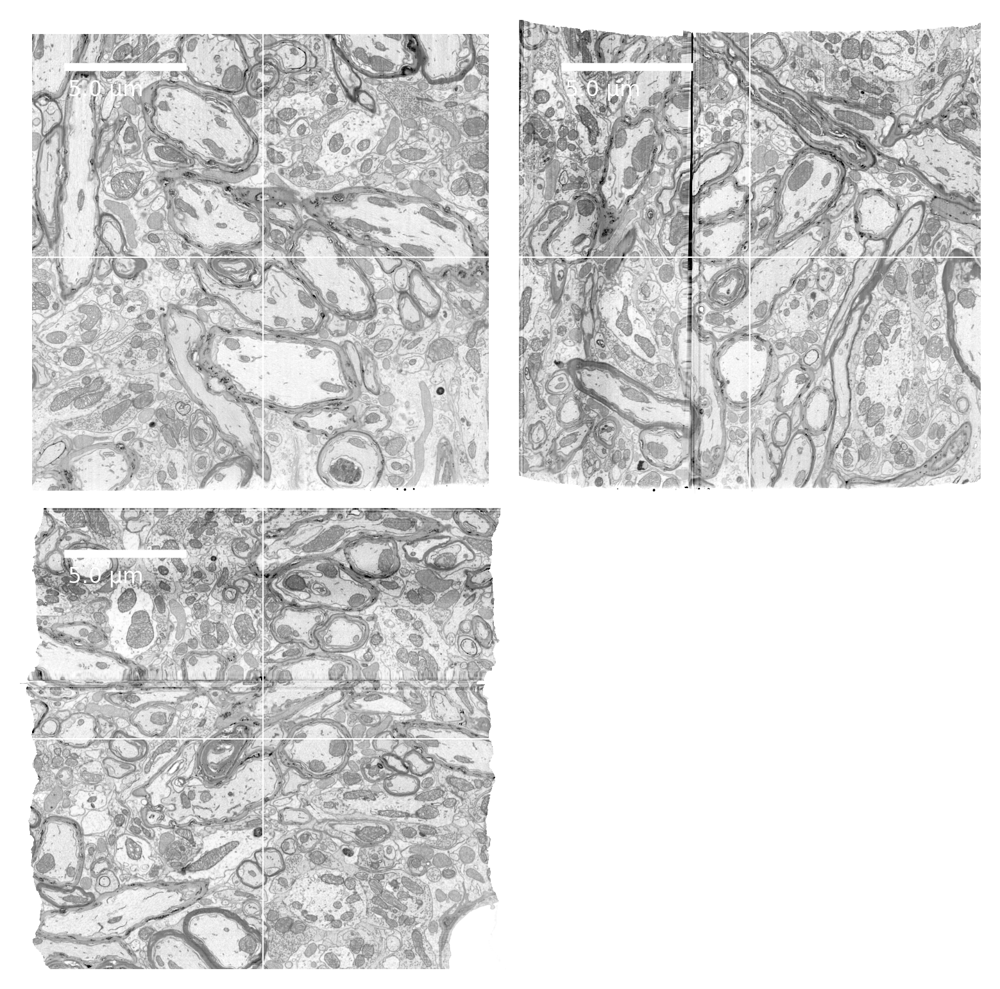

In [68]:
images, axs = plot_cross_sections_mrc_stack(mrc_smoothed_binned,
                                            bar_width = 3,
                                            bar_length_um = 5,
                                            label_offset = 30,
                                            label_font_size = 8.0,
                                            EM_max = 950, 
                                            dpi=300)